Importing all the necessary library

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sn
from datetime import datetime

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import warnings
from matplotlib import MatplotlibDeprecationWarning

warnings.filterwarnings('ignore', category=FutureWarning)
warnings.filterwarnings('ignore', category=MatplotlibDeprecationWarning)


Load the covid19 data
#url = 'https://covid.ourworldindata.org/data/owid-covid-data.csv' date: 23 Nov 2023


In [3]:
df = pd.read_csv('/content/drive/MyDrive/project/data1/owid-covid-data.csv')
display(df)

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-01-03,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-01-04,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
358641,ZWE,Africa,Zimbabwe,2023-11-18,265890.0,0.0,0.0,5725.0,0.0,0.0,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
358642,ZWE,Africa,Zimbabwe,2023-11-19,265890.0,0.0,0.0,5725.0,0.0,0.0,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
358643,ZWE,Africa,Zimbabwe,2023-11-20,265890.0,0.0,0.0,5725.0,0.0,0.0,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
358644,ZWE,Africa,Zimbabwe,2023-11-21,265890.0,0.0,0.0,5725.0,0.0,0.0,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 358646 entries, 0 to 358645
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    358646 non-null  object 
 1   continent                                   341606 non-null  object 
 2   location                                    358646 non-null  object 
 3   date                                        358646 non-null  object 
 4   total_cases                                 320628 non-null  float64
 5   new_cases                                   349032 non-null  float64
 6   new_cases_smoothed                          347773 non-null  float64
 7   total_deaths                                299086 non-null  float64
 8   new_deaths                                  349089 non-null  float64
 9   new_deaths_smoothed                         347859 non-null  float64
 

In [5]:
df.describe()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
count,3.206280e+05,3.490320e+05,3.477730e+05,2.990860e+05,349089.000000,347859.000000,320628.000000,349032.000000,347773.000000,299086.000000,...,205904.000000,136322.000000,245664.000000,330057.000000,269693.000000,3.586460e+05,1.221100e+04,12211.000000,12211.000000,12211.000000
mean,6.862419e+06,9.375506e+03,9.409256e+03,8.695437e+04,83.515536,83.807025,104442.411650,141.892453,142.397917,883.471201,...,32.909734,50.789387,3.097013,73.710366,0.722408,1.282212e+08,5.312168e+04,9.760347,11.337701,1675.398350
std,4.155251e+07,1.089256e+05,9.331850e+04,4.439683e+05,629.077727,554.982392,153566.194211,1149.763610,592.949571,1108.197725,...,13.574662,31.957291,2.548374,7.394886,0.148963,6.599107e+08,1.494480e+05,12.293895,25.166908,1941.471481
min,1.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,7.700000,1.188000,0.100000,53.280000,0.394000,4.700000e+01,-3.772610e+04,-44.230000,-95.920000,-2752.924800
25%,8.355000e+03,0.000000e+00,1.430000e-01,1.290000e+02,0.000000,0.000000,2692.589250,0.000000,0.025000,61.639250,...,22.600000,20.859000,1.300000,69.590000,0.602000,4.490020e+05,1.216500e+02,1.430000,-1.590000,73.764453
50%,7.271900e+04,1.000000e+00,2.285700e+01,1.349000e+03,0.000000,0.143000,29666.037500,0.061000,5.948000,388.263500,...,33.100000,49.839000,2.500000,75.050000,0.740000,5.882259e+06,5.968999e+03,8.100000,5.720000,1115.956200
75%,7.844830e+05,2.440000e+02,4.737140e+02,1.201900e+04,2.000000,4.857000,138728.976000,32.893000,78.600000,1382.952000,...,41.300000,83.241000,4.200000,79.460000,0.829000,2.830170e+07,3.770731e+04,15.380000,16.300000,2746.703700
max,7.721658e+08,8.401963e+06,6.402036e+06,6.981250e+06,57889.000000,14822.000000,746007.717000,228872.025000,37241.781000,6511.885000,...,78.100000,100.000000,13.800000,86.750000,0.957000,7.975105e+09,1.289776e+06,76.620000,377.630000,10292.916000


In [6]:
df.location.unique()

array(['Afghanistan', 'Africa', 'Albania', 'Algeria', 'American Samoa',
       'Andorra', 'Angola', 'Anguilla', 'Antigua and Barbuda',
       'Argentina', 'Armenia', 'Aruba', 'Asia', 'Australia', 'Austria',
       'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados',
       'Belarus', 'Belgium', 'Belize', 'Benin', 'Bermuda', 'Bhutan',
       'Bolivia', 'Bonaire Sint Eustatius and Saba',
       'Bosnia and Herzegovina', 'Botswana', 'Brazil',
       'British Virgin Islands', 'Brunei', 'Bulgaria', 'Burkina Faso',
       'Burundi', 'Cambodia', 'Cameroon', 'Canada', 'Cape Verde',
       'Cayman Islands', 'Central African Republic', 'Chad', 'Chile',
       'China', 'Colombia', 'Comoros', 'Congo', 'Cook Islands',
       'Costa Rica', "Cote d'Ivoire", 'Croatia', 'Cuba', 'Curacao',
       'Cyprus', 'Czechia', 'Democratic Republic of Congo', 'Denmark',
       'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'England', 'Equatorial Guinea', 'Eritrea',

In [7]:
#date format change deu to visualize this well
df['date'] = pd.to_datetime(df.date)

In [8]:
#A list of invalid country names

invalid_country_names = [
    'Africa', 'American Samoa', 'Asia', 'Bonaire Sint Eustatius and Saba', 'British Virgin Islands', 'Central African Republic',
    'Congo', 'Cook Islands','Curaçao', 'Democratic Republic of Congo', 'Europe', 'European Union', 'French Polynesia',
    'Gibraltar',  'Greenland', 'Guam', 'High income', 'Hong Kong', 'Isle of Man', 'Kosovo', 'Low income', 'Lower middle income',
    'Macao', 'Middle income', 'North America', 'North Korea', 'North Macedonia', 'Northern Cyprus', 'Northern Ireland',
    'Northern Mariana Islands','Puerto Rico', 'Sint Maarten (Dutch part)',  'South America', 'Timor', 'Tonga',
    'Turks and Caicos Islands', 'United States Virgin Islands', 'Upper middle income', 'World'
]

In [9]:
len(df.location.unique())

255

In [10]:
len(df)

358646

In [11]:
filtered_forCountry_df = df[~df['location'].isin(invalid_country_names)]
len(filtered_forCountry_df)

307647

In [12]:
# For each location, Calculate the sum of total_cases and total_deaths
grouped_data = filtered_forCountry_df.groupby('location').agg({'total_cases': 'sum', 'total_deaths': 'sum'})

# Grab the top 10 couuntries for total_cases
top_10_cases = grouped_data['total_cases'].nlargest(10)

# Grab the top 10 couuntries for total_deaths
top_10_deaths = grouped_data['total_deaths'].nlargest(10)


In [13]:
pd.set_option('display.max_rows', None)
print(grouped_data)

                                   total_cases  total_deaths
location                                                    
Afghanistan                       1.870810e+08  7.462704e+06
Albania                           2.708539e+08  3.408095e+06
Algeria                           2.525989e+08  6.668391e+06
Andorra                           3.689490e+07  1.675900e+05
Angola                            8.729165e+07  1.729491e+06
Anguilla                          2.585856e+06  7.745000e+03
Antigua and Barbuda               6.648724e+06  1.178090e+05
Argentina                         8.262603e+09  1.283584e+08
Armenia                           4.013763e+08  7.962286e+06
Aruba                             3.332450e+07  2.221540e+05
Australia                         6.326386e+09  1.172224e+07
Austria                           3.768519e+09  1.947504e+07
Azerbaijan                        7.071761e+08  8.894743e+06
Bahamas                           3.128907e+07  7.136000e+05
Bahrain                 

In [14]:
top_10_cases.index.values

array(['United States', 'India', 'China', 'Brazil', 'France', 'Germany',
       'United Kingdom', 'South Korea', 'Italy', 'Russia'], dtype=object)

In [15]:
top_10_deaths

location
United States     1.001841e+09
Brazil            6.680351e+08
India             5.016322e+08
Mexico            3.367585e+08
Russia            3.283203e+08
Peru              2.274266e+08
United Kingdom    2.188729e+08
Italy             1.770246e+08
France            1.544951e+08
Germany           1.455972e+08
Name: total_deaths, dtype: float64

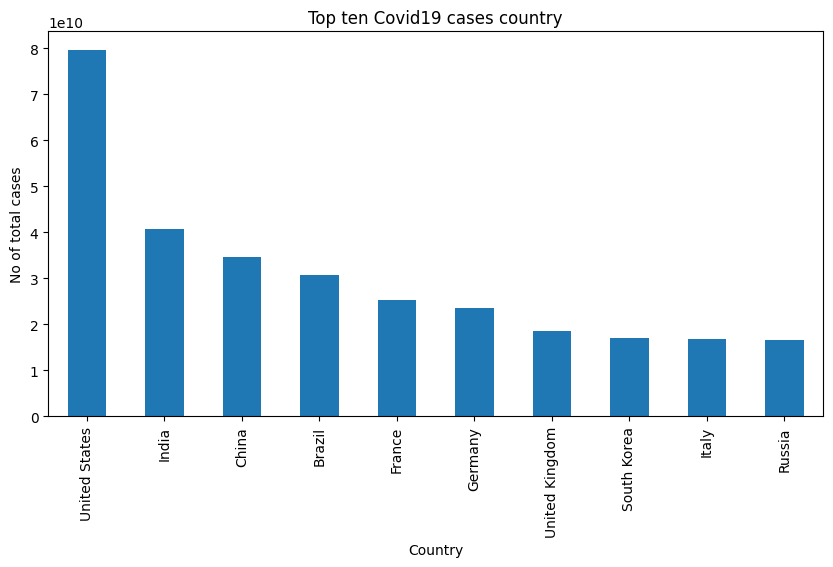

In [16]:
plt.figure(figsize = (10, 5))

# Bar plot for top 10 countries based on total_cases
top_10_cases.plot.bar();

plt.xlabel("Country")
plt.ylabel("No of total cases")
plt.title("Top ten Covid19 cases country")
plt.show()

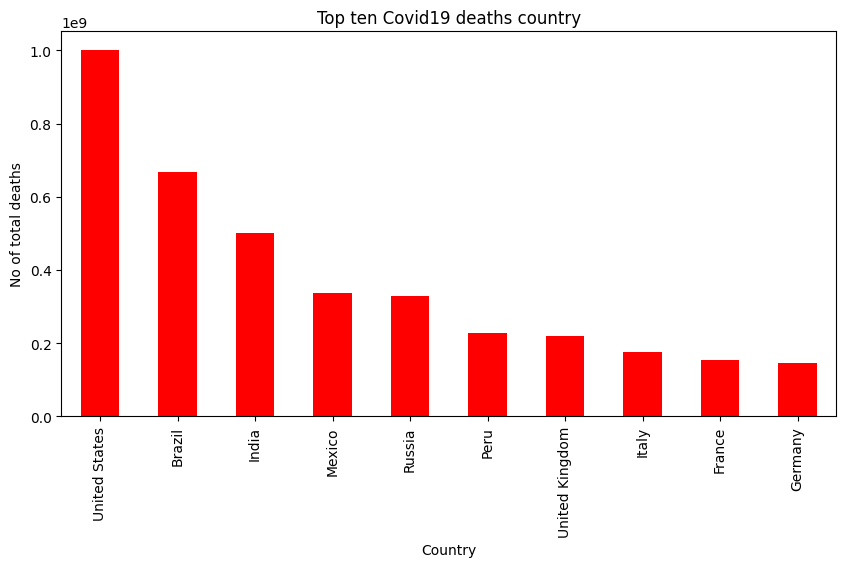

In [17]:
plt.figure(figsize = (10, 5))

# Bar plot for top 10 countries based on total_deaths
top_10_deaths.plot.bar(color="red");

plt.xlabel("Country")
plt.ylabel("No of total deaths")
plt.title("Top ten Covid19 deaths country")
plt.show()

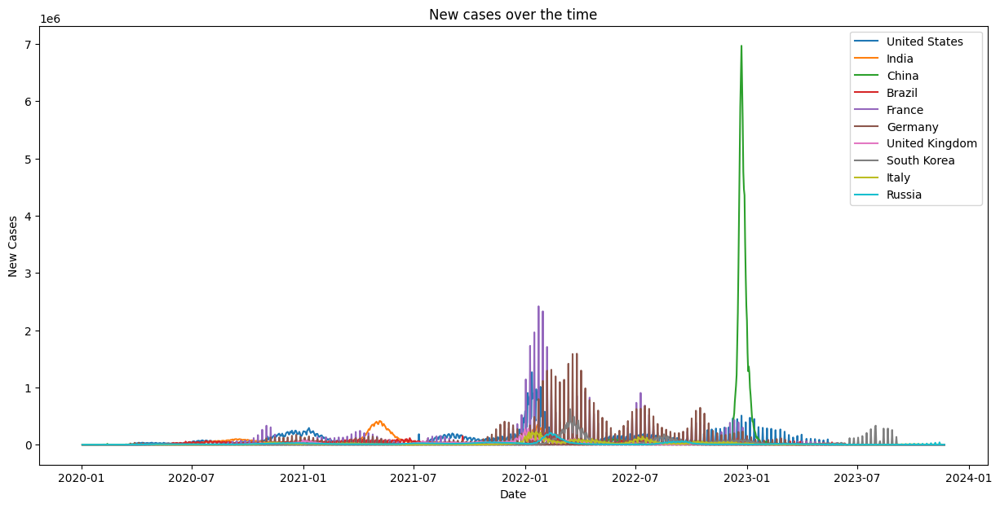

In [18]:
plt.figure(figsize=(15, 7))

#loop through for the top 10 countries total_cases
for country, value in top_10_cases.iteritems():

    # Filtering the data based on the current country for the loop
    country_data = filtered_forCountry_df[filtered_forCountry_df['location'] == country]
    plt.plot(country_data['date'], country_data['new_cases'], label= country)
    #sn.lineplot(data=country_data, x='date', y='new_cases', label=country)

plt.xlabel('Date')
plt.ylabel('New Cases')
plt.title('New cases over the time')
plt.legend()
plt.show()

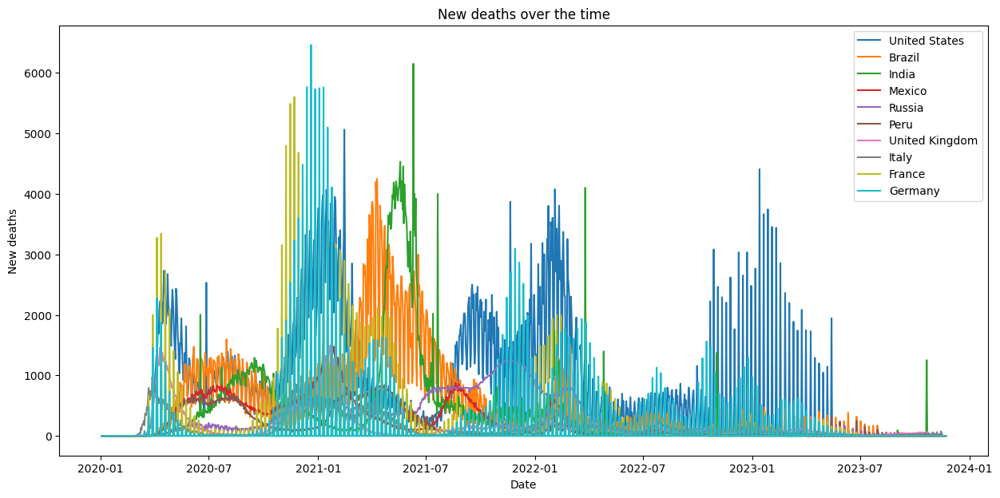

In [19]:
plt.figure(figsize=(15, 7))

#loop through for the top 10 countries total_cases
for country, value in top_10_deaths.iteritems():

    # Filtering the data based on the current country for the loop
    country_data = filtered_forCountry_df[filtered_forCountry_df['location'] == country]
    plt.plot(country_data['date'], country_data['new_deaths'], label= country)
    #sn.lineplot(data=country_data, x='date', y='new_cases', label=country)

plt.xlabel('Date')
plt.ylabel('New deaths')
plt.title('New deaths over the time')
plt.legend()
plt.show()

In [20]:
df.describe()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
count,3.206280e+05,3.490320e+05,3.477730e+05,2.990860e+05,349089.000000,347859.000000,320628.000000,349032.000000,347773.000000,299086.000000,...,205904.000000,136322.000000,245664.000000,330057.000000,269693.000000,3.586460e+05,1.221100e+04,12211.000000,12211.000000,12211.000000
mean,6.862419e+06,9.375506e+03,9.409256e+03,8.695437e+04,83.515536,83.807025,104442.411650,141.892453,142.397917,883.471201,...,32.909734,50.789387,3.097013,73.710366,0.722408,1.282212e+08,5.312168e+04,9.760347,11.337701,1675.398350
std,4.155251e+07,1.089256e+05,9.331850e+04,4.439683e+05,629.077727,554.982392,153566.194211,1149.763610,592.949571,1108.197725,...,13.574662,31.957291,2.548374,7.394886,0.148963,6.599107e+08,1.494480e+05,12.293895,25.166908,1941.471481
min,1.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,7.700000,1.188000,0.100000,53.280000,0.394000,4.700000e+01,-3.772610e+04,-44.230000,-95.920000,-2752.924800
25%,8.355000e+03,0.000000e+00,1.430000e-01,1.290000e+02,0.000000,0.000000,2692.589250,0.000000,0.025000,61.639250,...,22.600000,20.859000,1.300000,69.590000,0.602000,4.490020e+05,1.216500e+02,1.430000,-1.590000,73.764453
50%,7.271900e+04,1.000000e+00,2.285700e+01,1.349000e+03,0.000000,0.143000,29666.037500,0.061000,5.948000,388.263500,...,33.100000,49.839000,2.500000,75.050000,0.740000,5.882259e+06,5.968999e+03,8.100000,5.720000,1115.956200
75%,7.844830e+05,2.440000e+02,4.737140e+02,1.201900e+04,2.000000,4.857000,138728.976000,32.893000,78.600000,1382.952000,...,41.300000,83.241000,4.200000,79.460000,0.829000,2.830170e+07,3.770731e+04,15.380000,16.300000,2746.703700
max,7.721658e+08,8.401963e+06,6.402036e+06,6.981250e+06,57889.000000,14822.000000,746007.717000,228872.025000,37241.781000,6511.885000,...,78.100000,100.000000,13.800000,86.750000,0.957000,7.975105e+09,1.289776e+06,76.620000,377.630000,10292.916000


In [21]:
numerical_variable = ['total_cases', 'new_cases', 'total_deaths', 'new_deaths','total_tests', 'new_tests', 'icu_patients',
                          'hosp_patients','total_vaccinations', 'new_vaccinations' , 'people_vaccinated',
                          'people_fully_vaccinated','total_boosters']

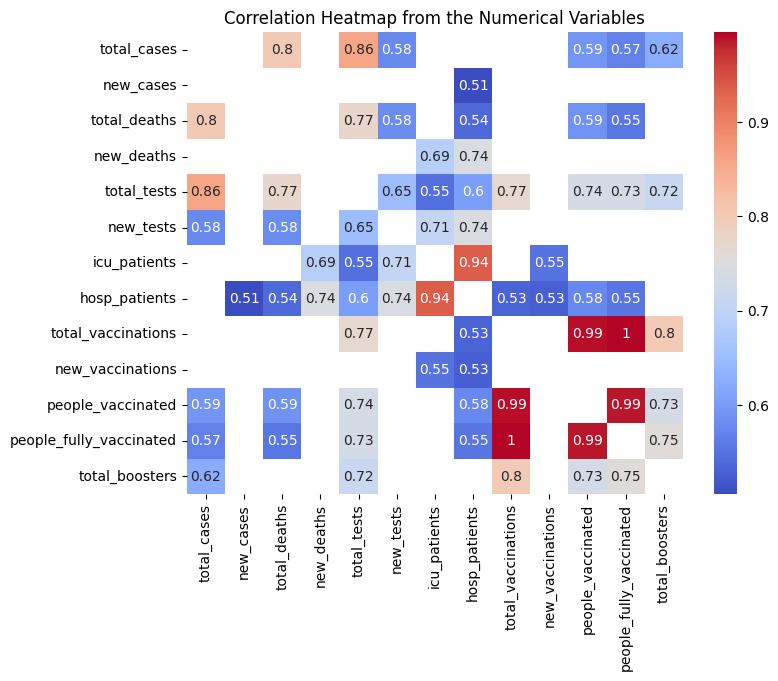

In [22]:
df_with_numerical = filtered_forCountry_df[numerical_variable]
correlation_matrix = df_with_numerical.corr()
plt.figure(figsize=(8, 6))
cor_filtered = correlation_matrix[((correlation_matrix >= .5) | (correlation_matrix <= -.5)) & (correlation_matrix !=1.000)]
sn.heatmap(cor_filtered, annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap from the Numerical Variables")
plt.show()

In [23]:
correlation_matrix

,total_cases,new_cases,total_deaths,new_deaths,total_tests,new_tests,icu_patients,hosp_patients,total_vaccinations,new_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters
total_cases,1.000000,0.181649,0.803004,0.218880,0.858919,0.576462,0.319524,0.450225,0.435104,0.118727,0.591699,0.568633,0.622730
new_cases,0.181649,1.000000,0.135232,0.272670,0.318105,0.385405,0.377795,0.505635,0.193347,0.056729,0.113007,0.099084,0.143223
total_deaths,0.803004,0.135232,1.000000,0.306503,0.771526,0.581441,0.460819,0.539723,0.382878,0.163083,0.588956,0.554451,0.495106
new_deaths,0.218880,0.272670,0.306503,1.000000,0.327357,0.432744,0.686807,0.744195,0.080897,0.133266,0.114237,0.079097,0.094618
total_tests,0.858919,0.318105,0.771526,0.327357,1.000000,0.650285,0.547616,0.604258,0.769181,0.479052,0.736164,0.734136,0.715737
new_tests,0.576462,0.385405,0.581441,0.432744,0.650285,1.000000,0.707600,0.742174,0.438701,0.462565,0.450210,0.394128,0.334530
icu_patients,0.319524,0.377795,0.460819,0.686807,0.547616,0.707600,1.000000,0.937670,0.402023,0.550797,0.473358,0.443374,0.174634
hosp_patients,0.450225,0.505635,0.539723,0.744195,0.604258,0.742174,0.937670,1.000000,0.534118,0.527679,0.575187,0.552274,0.424936
total_vaccinations,0.435104,0.193347,0.382878,0.080897,0.769181,0.438701,0.402023,0.534118,1.000000,0.382643,0.989775,0.995228,0.801344
new_vaccinations,0.118727,0.056729,0.163083,0.133266,0.479052,0.462565,0.550797,0.527679,0.382643,1.000000,0.438998,0.348309,0.148063


In [24]:
high_correlation = cor_filtered.max().nlargest(10).nlargest(10)
high_correlation

total_vaccinations         0.995228
people_fully_vaccinated    0.995228
people_vaccinated          0.989775
icu_patients               0.937670
hosp_patients              0.937670
total_cases                0.858919
total_tests                0.858919
total_deaths               0.803004
total_boosters             0.801344
new_deaths                 0.744195
dtype: float64

# Elbow method for these 10 countries to get the number of clusters for countries

In [25]:
columns_of_interest = ['date','new_cases', 'new_deaths','new_vaccinations','location']
data_columns_of_interest = filtered_forCountry_df[columns_of_interest].dropna()
new = data_columns_of_interest["location"].isin(top_10_cases.index.values)
new_data = data_columns_of_interest[new].dropna()

features = ['new_cases','new_deaths','new_vaccinations']

In [26]:
new_data.head()

,date,new_cases,new_deaths,new_vaccinations,location
42983,2021-01-18,61567.0,1050.0,997.0,Brazil
42984,2021-01-19,33040.0,551.0,12418.0,Brazil
42985,2021-01-20,23671.0,452.0,92297.0,Brazil
42986,2021-01-21,62094.0,1192.0,87875.0,Brazil
42987,2021-01-22,64385.0,1340.0,268570.0,Brazil


10


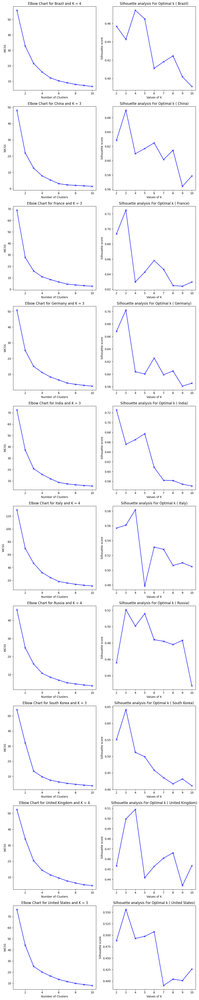

In [27]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
!pip install kneed
from kneed import KneeLocator
from sklearn.preprocessing import MaxAbsScaler

countries = []
wcss_values = []
silhouette_values = []
k_values = []
clusters = []

prep = MaxAbsScaler()

#Elbow values will be stored in k_values_found variable
k_values_found = []

for country in new_data['location'].unique():
    # Filtering the data based on the current country for the loop
    country_data = new_data[new_data['location'] == country][features]

    scaled_data = prep.fit_transform(country_data)

    # Initialize lists to store WCSS values, silhouette avg and corresponding k values for the current country
    country_wcss = []
    silhouette_avg = []
    country_k_values = []
    countries.append(country)


    # Looping through different values of k
    for k in range(1, 11):

        # KMeans model with the current k value
        kmeans = KMeans(n_clusters=k, random_state=42)

        # Fit the model to the scaled data
        kmeans.fit(scaled_data)

        # Calculating the WCSS
        country_wcss.append(kmeans.inertia_)
        country_k_values.append(k)

        if(k > 1):
            # Calculating silhouette score
            silhouette_avg.append(silhouette_score(scaled_data, kmeans.labels_))



    # Store the WCSS and k values for the current country
    wcss_values.append(country_wcss)
    k_values.append(country_k_values)
    # Store the silhouette_avg values for the current country
    silhouette_values.append(silhouette_avg)

# Calculating the grid size for visualization based on the number of countries
num_countries = len(countries)
num_rows = int((num_countries)) #num_rows = int((num_countries + 1) / 2)
num_cols = 2 #num_cols = 2 if num_countries > 1 else 1
print(num_rows)

# Plot the elbow charts for each country in the determined grid size
fig, axs = plt.subplots(num_rows, num_cols, figsize=(10, 5*num_rows))
axs = axs.flatten()
j = 0
for i in range(num_countries):
    k_values_found.append(KneeLocator(range(1, 11), wcss_values[i], curve="convex", direction="decreasing"))
    axs[j].plot(k_values[i], wcss_values[i], 'bx-')
    axs[j].set_xlabel('Number of Clusters')
    axs[j].set_ylabel('WCSS')
    axs[j].set_title('Elbow Chart for '+countries[i] +' and K = '+ str(k_values_found[i].elbow))
    j = j+1
    axs[j].plot([2, 3, 4, 5, 6, 7, 8,9,10],silhouette_values[i],'bx-')
    axs[j].set_xlabel('Values of K')
    axs[j].set_ylabel('Silhouette score')
    axs[j].set_title('Silhouette analysis For Optimal k ( '+countries[i] +')')
    j = j+1



plt.tight_layout()
plt.show()

Silhouette  Method for calculating K value

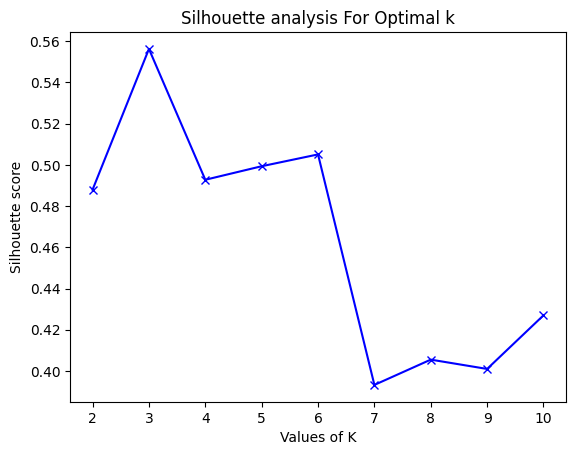

In [28]:
range_n_clusters = [2, 3, 4, 5, 6, 7, 8,9,10]
silhouette_avg = []
usa_data = new_data[new_data['location']== 'United States'][features]
scaled_data_USA = prep.fit_transform(usa_data)
for num_clusters in range_n_clusters:

    # initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(scaled_data_USA)
    #cluster_labels = kmeans.labels_

    # silhouette score
    silhouette_avg.append(silhouette_score(scaled_data_USA,  kmeans.labels_))

plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K')
plt.ylabel('Silhouette score')
plt.title('Silhouette analysis For Optimal k')
plt.show()

In [29]:
new_data[new_data['location']== 'United States'].head()

,date,new_cases,new_deaths,new_vaccinations,location
337913,2020-12-14,217153.0,2440.0,4848.0,United States
337914,2020-12-15,181275.0,2037.0,47885.0,United States
337915,2020-12-16,198204.0,1955.0,160151.0,United States
337916,2020-12-17,198650.0,2758.0,275238.0,United States
337917,2020-12-18,240266.0,3389.0,421048.0,United States


In [30]:
kmeans_s = KMeans(n_clusters=3, random_state=42).fit(scaled_data)


In [31]:
labels_s = kmeans_s.predict(scaled_data)
centers  = kmeans.cluster_centers_
print(centers)

[[0.11688678 0.40137897 0.10893621]
 [0.00774071 0.00931106 0.03659408]
 [0.10081023 0.3940249  0.40563683]
 [0.08345707 0.1190199  0.05607712]
 [0.64912202 0.49474308 0.19998685]
 [0.1979692  0.68020154 0.13284212]
 [0.04486362 0.16827871 0.74738773]
 [0.11397249 0.21188698 0.20470463]
 [0.02057839 0.05010496 0.15296268]
 [0.04119615 0.1167721  0.41871632]]


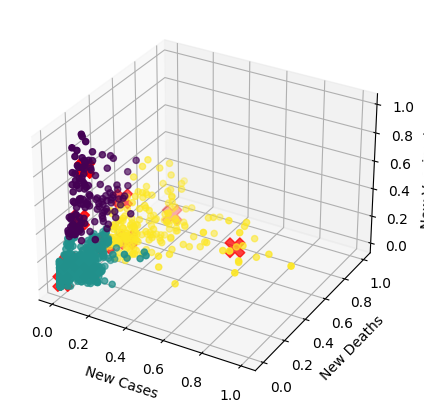

In [32]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(18, 5))

ax1 = fig.add_subplot(131, projection='3d')
ax1.set_xlabel('New Cases')
ax1.set_ylabel('New Deaths')
ax1.set_zlabel('New Vaccinations')
ax1.scatter(centers[:, 0], centers[:, 1], centers[:, 2], color='red', marker='X', s=200, label='Center')
ax1.scatter(scaled_data[:, 0], scaled_data[:, 1], scaled_data[:, 2], c=labels_s)

# Fuzzy Clustering


In [33]:
!pip install -U scikit-fuzzy
import skfuzzy as fuzz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 994.0/994.0 kB 9.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for scikit-fuzzy: filename=scikit_fuzzy-0.4.2-py3-none-any.whl size=894077 sha256=78fc7b069001a1c45ed3d0cd696b6624ea1f1fee1d5941def45db01cee778d1b
  Stored in directory: /root/.cache/pip/wheels/4f/86/1b/dfd97134a2c8313e519bcebd95d3fedc7be7944db022094bc8
Successfully built scikit-fuzzy


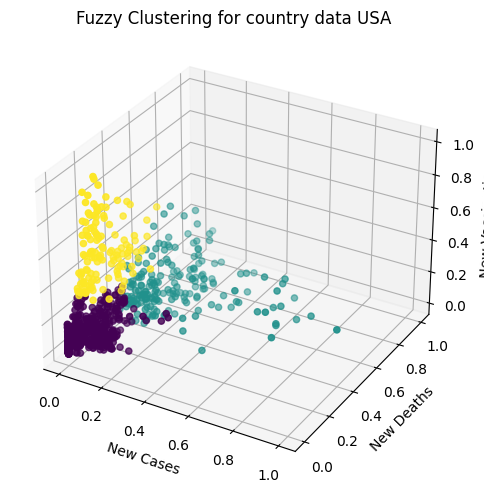

In [34]:

# Declare the figure size for 3d projection
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(6, 5), subplot_kw={'projection': '3d'})

# Set the initial fuzziness coefficient options
fuzzy_params = {'n_clusters': [2, 3, 4, 5, 6, 7, 8, 9, 10], 'm': [1.1, 1.5, 2.0]}

results = {}

for n_clusters in fuzzy_params['n_clusters']:
    for m in fuzzy_params['m']:
        # Apply Fuzzy C-Means for clustering
        cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(scaled_data_USA.T, n_clusters, m, error=0.005, maxiter=1000)

        # Save the results
        results[(n_clusters, m)] = {
            'fpc': round(fpc, 3),
        }

best_n_clusters_fpc, best_m_fpc = max(results, key=lambda x: results[x]['fpc'])

# Create an empty FCM model for FPC
fcm_fpc = fuzz.cluster.cmeans(scaled_data_USA.T, best_n_clusters_fpc, best_m_fpc, error=0.005, maxiter=1000)

# Calculate the membership matrix for FPC
u_fpc = fcm_fpc[1]


# Create a 3D scatter plot for FPC
axs.scatter(scaled_data_USA[:,0], scaled_data_USA[:,1], scaled_data_USA[:,2], c=u_fpc.argmax(axis=0))
axs.set_title('Fuzzy Clustering for country data USA')
axs.set_xlabel('New Cases')
axs.set_ylabel('New Deaths')
axs.set_zlabel('New Vaccinations')

# Adjust the layout and spacing between subplots
plt.tight_layout()

# Display the figure
plt.show()


# Interpret and visualize the covid19 dataset

In [35]:
from sklearn.preprocessing import StandardScaler

def create_clusters_and_plot(data, country, cluster_method, filtered_df):
    country_data = data[data['location'] == country][['date', 'new_cases', 'new_deaths', 'new_vaccinations']]
    country_data_with_cluster = country_data.copy()
    scaled_country_data = prep.fit_transform(country_data[['new_cases', 'new_deaths', 'new_vaccinations']])
    cluster_number = get_cluster_number(scaled_country_data)
    centers = None  # For reset  centers for each cluster

    fig = plt.figure(figsize=(20, 10))  # Adjust the figure size based on the number of subplots
    ax = fig.add_subplot(1, 2, 1, projection='3d')
    # Defining colormap color for each cluster
    colormap = plt.cm.get_cmap('viridis')

    # apply k-mean clustering
    if(cluster_method == 'K-mean'):
        labels, centers = apply_kmeans(scaled_country_data, cluster_number)
        country_data_with_cluster[cluster_method + '_cluster_labels'] = labels
    # apply Fuzzy clustering
    elif(cluster_method == 'Fuzzy'):
        labels, centers = apply_fuzzy(scaled_country_data, cluster_number)
        country_data_with_cluster[cluster_method + '_cluster_labels'] = labels

    silhouette, davies, calinski = evaluate_clustering(scaled_country_data, labels)
    print(
        f'\n{cluster_method} Clustering for {country}\nNumber of Clusters: {cluster_number}\nSilhouette Score: {silhouette:.3f}\nDavies-Bouldin Score: {davies:.3f}\nCalinski-Harabasz Score: {calinski:.3f}')

    plot_clusters(ax, scaled_country_data, labels, centers, colormap, cluster_number, cluster_method)
    print_cluster_sizes(labels, cluster_method)
    add_additional_columns(country_data_with_cluster, filtered_df)

    return country_data_with_cluster

def apply_kmeans(data, cluster_number):
    kmeans = KMeans(n_clusters=cluster_number, random_state=42)
    labels = kmeans.fit_predict(data)
    centers = np.array(kmeans.cluster_centers_)
    return labels, centers

def apply_fuzzy(data, cluster_number):
    fuzzy_params_m = [1.1, 1.5, 2.0]
    results = {}

    for m in fuzzy_params_m:
        # Apply Fuzzy C-Means
        cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(data.T, cluster_number, m, error=0.005, maxiter=1000)

        # Save the results
        results[(cluster_number, m)] = {
            'fpc': round(fpc, 3),
        }
    cluster_number, best_m_fpc = max(results, key=lambda x: results[x]['fpc'])
    # Create an empty FCM model for FPC
    cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(data.T, cluster_number, best_m_fpc, error=0.005, maxiter=1000)
    labels = u.argmax(axis=0)
    return labels, cntr


def evaluate_clustering(data, labels):
    silhouette = silhouette_score(data, labels)
    davies = davies_bouldin_score(data, labels)
    calinski = calinski_harabasz_score(data, labels)
    return silhouette, davies, calinski

def print_cluster_sizes(labels,cluster_method):
    print(f"\nSize of this {cluster_method}")
    # Calculate cluster sizes
    cluster_sizes = pd.Series(labels[labels != -1]).value_counts().sort_index()
    for cluster, size in enumerate(cluster_sizes):
        print(f"For {cluster_method}, Cluster {cluster} size: {size}")

def plot_clusters(ax, data, labels, centers, colormap, cluster_number, cluster_method):
    for label in np.unique(labels):
        label_indices = np.where(labels == label)
        ax.scatter(data[label_indices, 0], data[label_indices, 1], data[label_indices, 2],
                   color=colormap(label / cluster_number), s=50, label=f'Cluster {label}')

    if centers is not None:
        ax.scatter(centers[:, 0], centers[:, 1], centers[:, 2], color='red', marker='X', s=200, label='Center')

    ax.set_title(cluster_method + ' Clustering for ' + country, fontsize=16)
    ax.set_xlabel('New Cases')
    ax.set_ylabel('New Deaths')
    ax.set_zlabel('New Vaccinations')
    # Show legend
    ax.legend()

# Add 'people_fully_vaccinated' and others column to the DataFrame
def add_additional_columns(country_data_with_cluster, filtered_df):
    country_data_with_cluster['people_fully_vaccinated'] = filtered_df['people_fully_vaccinated']
    country_data_with_cluster['total_cases'] = filtered_df['total_cases']
    country_data_with_cluster['total_deaths'] = filtered_df['total_deaths']
    country_data_with_cluster['hosp_patients'] = filtered_df['hosp_patients']
    country_data_with_cluster['stringency_index'] = filtered_df['stringency_index']

def get_cluster_number(scaled_country_data):

    silhouette_max = 0.0
    cluster_max = 2
    range_n_clusters = [2, 3, 4, 5, 6, 7, 8 , 9, 10]
    for num_clusters in range_n_clusters:
        # initialise kmeans
        kmeans = KMeans(n_clusters=num_clusters)
        kmeans.fit(scaled_country_data)
        #cluster_labels = kmeans.labels_

        # max silhouette score
        silhoete_score = silhouette_score(scaled_country_data,  kmeans.labels_)
        if(silhouette_max < silhoete_score):
            silhouette_max = silhoete_score
            cluster_max = num_clusters

    return cluster_max


In [36]:
def summarize_clusters(data_with_clusters):
    # Ensure 'date' is of datetime type
    data_with_clusters['date'] = pd.to_datetime(data_with_clusters['date'])

    # Check for KMeans_cluster_labels
    if 'K-mean_cluster_labels' in data_with_clusters.columns:
        # Print summary for KMeans
        print_summary('K-mean', data_with_clusters)

    # Check for Fuzzy C-Means_cluster_labels
    if 'Fuzzy_cluster_labels' in data_with_clusters.columns:
        # Print summary for Fuzzy C-Means
        print_summary('Fuzzy', data_with_clusters)


def print_summary(cluster_label, data):
    # Calculate mean new cases and deaths by cluster
    cluster_summary = data.groupby(f'{cluster_label}_cluster_labels')[['new_cases', 'new_deaths', 'new_vaccinations']].mean()
    print(f'\n{cluster_label} Cluster sizes')
    print(cluster_summary)
    #print('Kmeans')
    # Identify the cluster with the highest average new cases
    max_new_cases_cluster = cluster_summary['new_cases'].idxmax()
    print(f"Cluster {max_new_cases_cluster} has the highest average new cases.")

    # Identify the cluster with the highest average new deaths
    max_new_deaths_cluster = cluster_summary['new_deaths'].idxmax()
    print(f"Cluster {max_new_deaths_cluster} has the highest average new deaths.")

    max_new_vaccinations_cluster = cluster_summary['new_vaccinations'].idxmax()
    print(f"Cluster {max_new_vaccinations_cluster} has the highest average  new_vaccinations.")


    # Date range
    date_range = data.groupby(f'{cluster_label}_cluster_labels')['date'].agg(['min', 'max'])
    print(f"\n{cluster_label} Date Range:")
    print(date_range)

    # People fully vaccinated
    result = data.groupby(f'{cluster_label}_cluster_labels')['people_fully_vaccinated'].agg(['min', 'max'])
    print(f"\n{cluster_label} people fully vaccinated:")
    print(result)

    # Stringency index
    stringency_index = data.groupby(f'{cluster_label}_cluster_labels')['stringency_index'].agg(['min', 'max'])
    print(f"\n{cluster_label} stringency_index:")
    print(stringency_index)

    # Hospital patients
    hosp_patients = data.groupby(f'{cluster_label}_cluster_labels')['hosp_patients'].mean()
    print(f"\n{cluster_label} Average hosp_patients:")
    print(hosp_patients)


In [37]:
def plot_variables_over_time(dataframe):
    # Ensure 'date' column is in datetime format
    dataframe['date'] = pd.to_datetime(dataframe['date'])

    # Define list of variables for plot
    variables = ['new_cases', 'new_deaths', 'new_vaccinations']

    # Create plot for each variable for KMeans clusters
    if 'K-mean_cluster_labels' in dataframe.columns:
        for variable in variables:
            plt.figure(figsize=(14, 6))
            for cluster in dataframe['K-mean_cluster_labels'].unique():
                # Filter rows for a particular cluster
                cluster_rows = dataframe[dataframe['K-mean_cluster_labels'] == cluster]
                plt.plot(cluster_rows['date'], cluster_rows[variable], 'o', linestyle='none', label=f'K-mean Cluster {cluster}')

            plt.xlabel('Date')
            plt.ylabel(variable)
            plt.title(f'K mean clustering over time for {variable}')
            plt.legend()
            plt.show()


    # Create a plot for each variable for Fuzzy C-Means clusters
    if 'Fuzzy_cluster_labels' in dataframe.columns:
        for variable in variables:
            plt.figure(figsize=(14, 6))
            for cluster in dataframe['Fuzzy_cluster_labels'].unique():
                # Filter rows for a particular cluster
                cluster_rows = dataframe[dataframe['Fuzzy_cluster_labels'] == cluster]
                plt.plot(cluster_rows['date'], cluster_rows[variable], 'o', linestyle='none', label=f'Fuzzy Cluster {cluster}')

            plt.xlabel('Date')
            plt.ylabel(variable)
            plt.title(f'Fuzzy clustering over time for {variable}')
            plt.legend()
            plt.show()




K-mean Clustering for United States
Number of Clusters: 3
Silhouette Score: 0.556
Davies-Bouldin Score: 0.768
Calinski-Harabasz Score: 886.394

Size of this K-mean
For K-mean, Cluster 0 size: 131
For K-mean, Cluster 1 size: 549
For K-mean, Cluster 2 size: 196

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                       69140.480916   947.893130      2.421070e+06
1                       51799.819672   363.071038      3.981894e+05
2                      253952.551020  2542.984694      7.178852e+05
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-01-27 2021-12-28
1                     2021-03-14 2023-05-09
2                     2020-12-14 2023

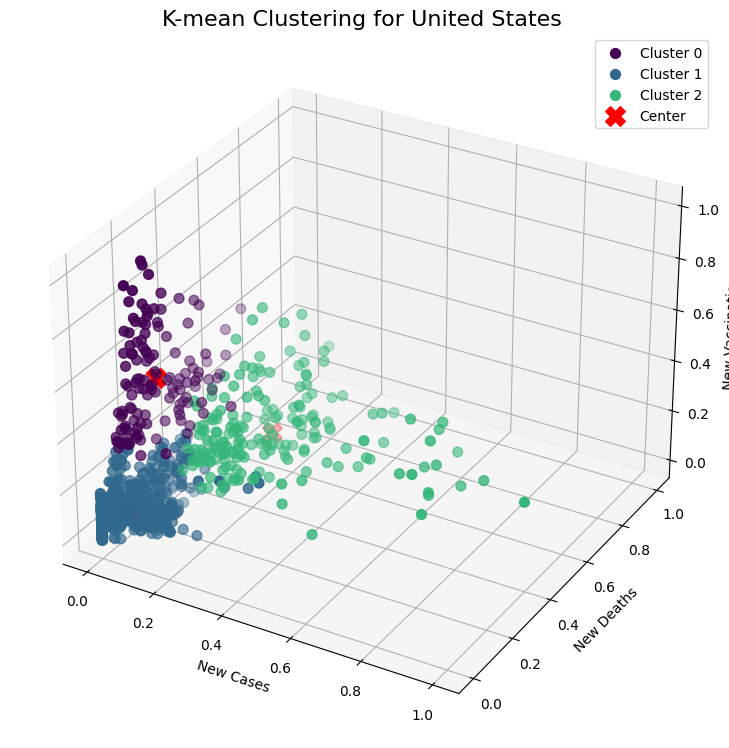

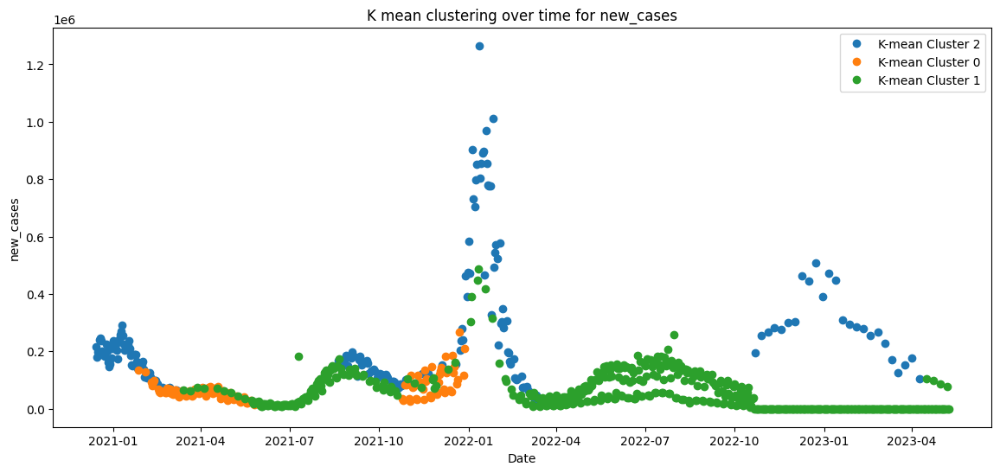

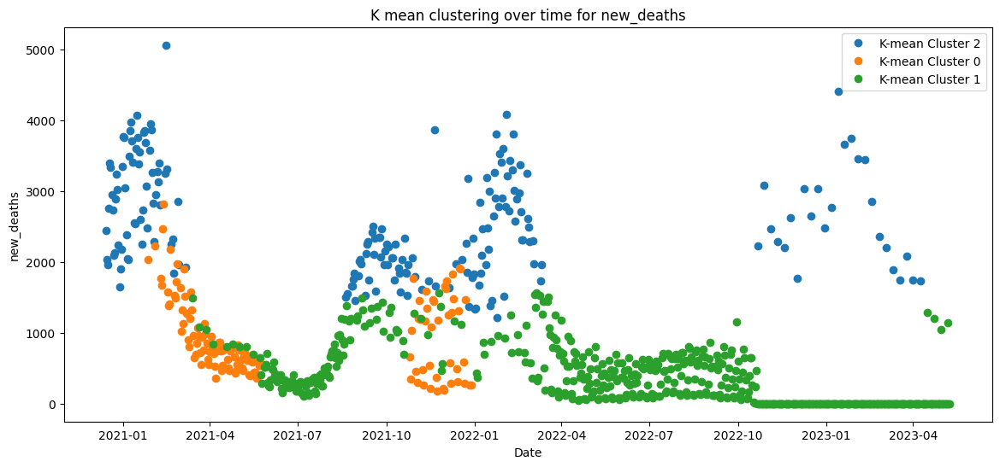

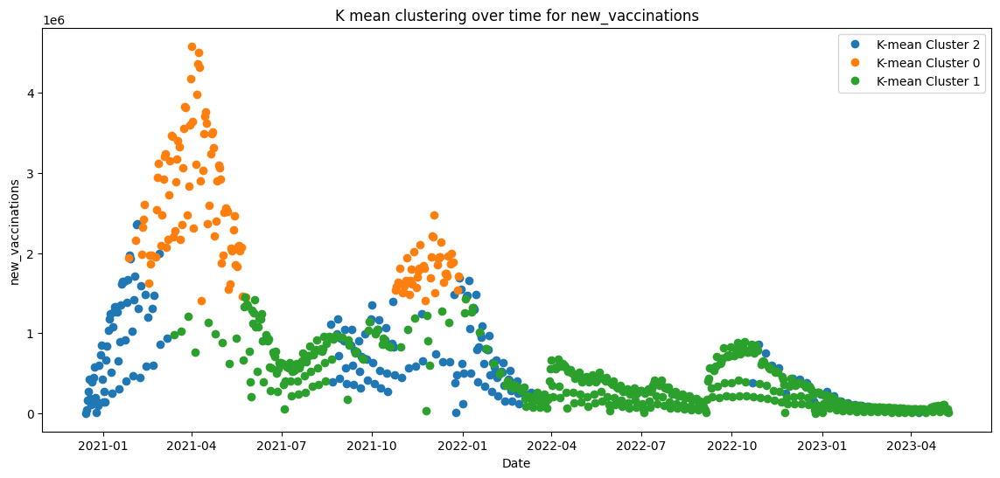

In [38]:
usa_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'United States', 'K-mean',  filtered_forCountry_df)
summarize_clusters(usa_data_with_clusters)
plot_variables_over_time(usa_data_with_clusters)



Fuzzy Clustering for United States
Number of Clusters: 3
Silhouette Score: 0.556
Davies-Bouldin Score: 0.770
Calinski-Harabasz Score: 886.324

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 132
For Fuzzy, Cluster 1 size: 548
For Fuzzy, Cluster 2 size: 196

Fuzzy Cluster sizes
                          new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                              
0                      69657.833333   949.515152      2.412356e+06
1                      51643.558394   361.613139      3.965971e+05
2                     253952.551020  2542.984694      7.178852e+05
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-01-27 2021-12-28
1                    2021-03-14 2023-05-09
2                    2020-12-14 2023-04-09

Fuzzy peo

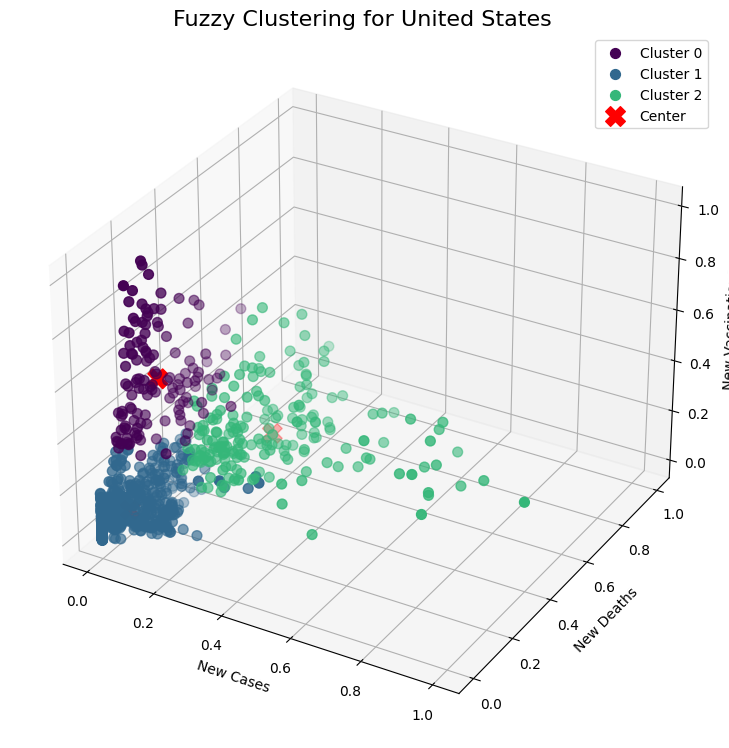

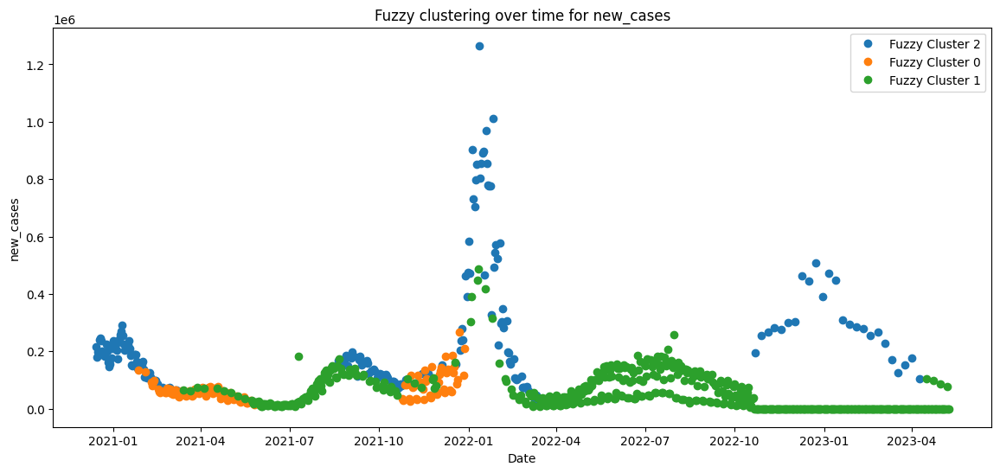

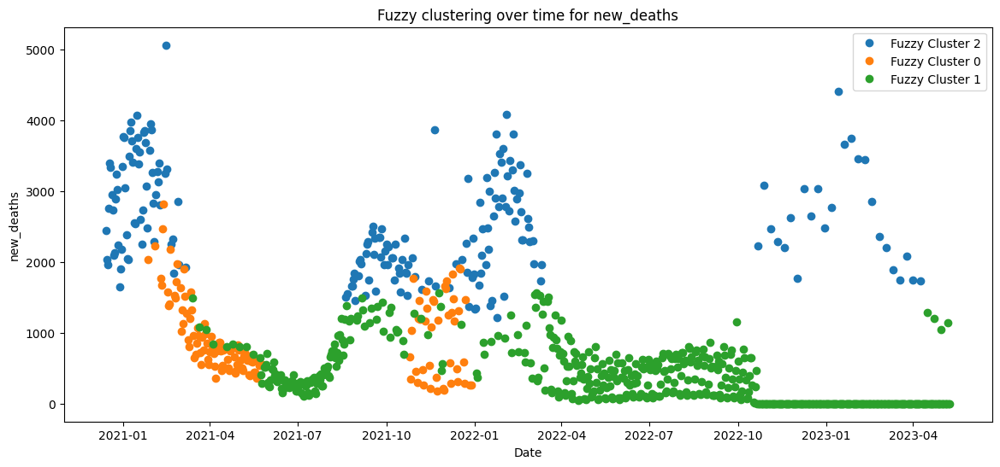

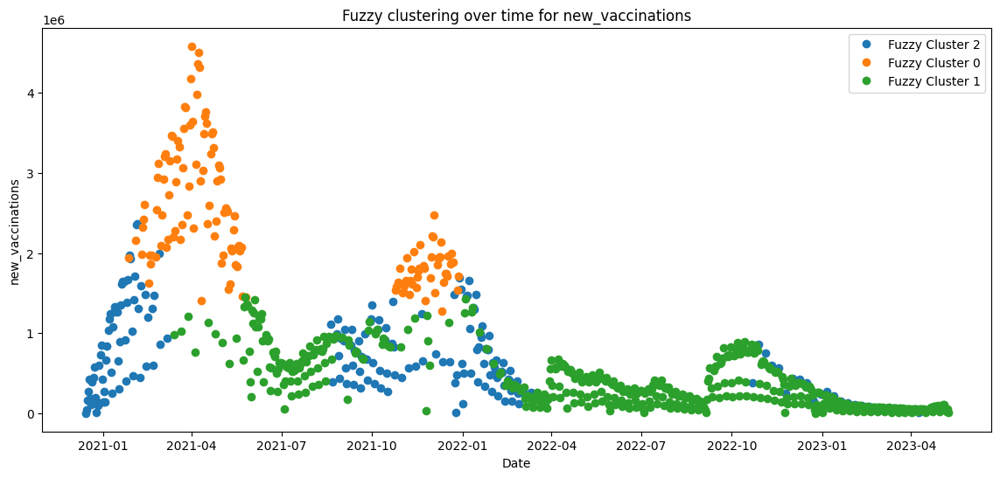

In [39]:
usa_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'United States', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(usa_data_with_clusters)
plot_variables_over_time(usa_data_with_clusters)


K-mean Clustering for India
Number of Clusters: 2
Silhouette Score: 0.726
Davies-Bouldin Score: 0.744
Calinski-Harabasz Score: 939.717

Size of this K-mean
For K-mean, Cluster 0 size: 899
For K-mean, Cluster 1 size: 90

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                       11733.720801   153.529477      1.974439e+06
1                      235178.200000  2392.188889      3.743277e+06
Cluster 1 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 1 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-01-16 2023-11-21
1                     2021-04-10 2022-03-26

K-mean people fully vaccinated:
                              min          max
K-mean_cluster_labels                         
0                  

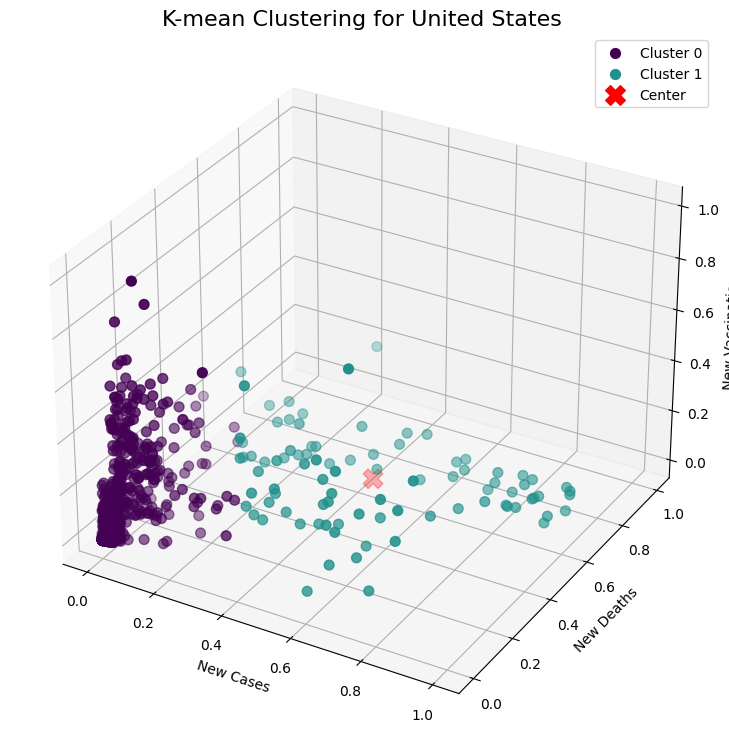

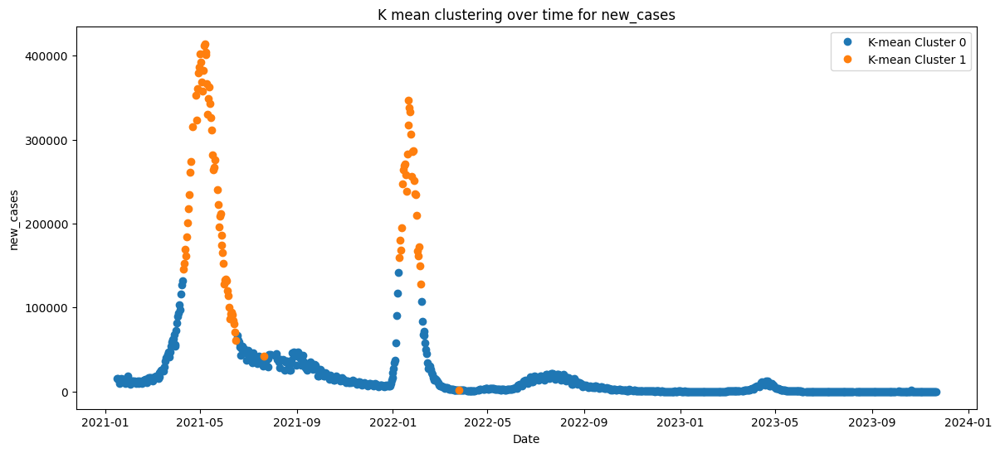

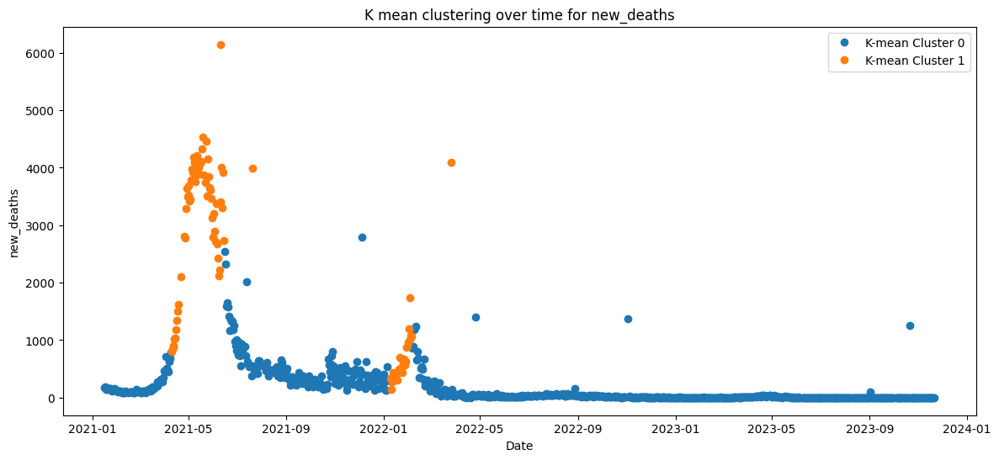

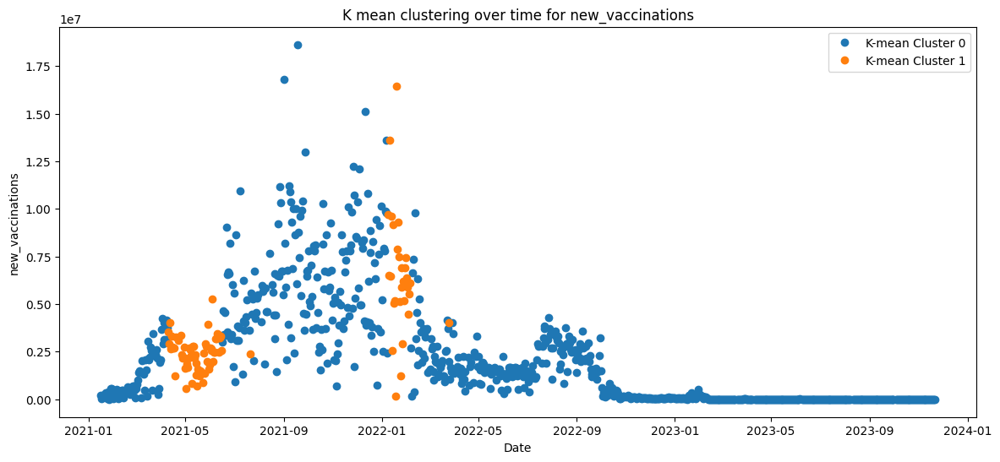

In [40]:
india_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'India', 'K-mean',  filtered_forCountry_df)
summarize_clusters(india_data_with_clusters)
plot_variables_over_time(india_data_with_clusters)


Fuzzy Clustering for India
Number of Clusters: 2
Silhouette Score: 0.726
Davies-Bouldin Score: 0.744
Calinski-Harabasz Score: 939.717

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 899
For Fuzzy, Cluster 1 size: 90

Fuzzy Cluster sizes
                          new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                              
0                      11733.720801   153.529477      1.974439e+06
1                     235178.200000  2392.188889      3.743277e+06
Cluster 1 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 1 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-01-16 2023-11-21
1                    2021-04-10 2022-03-26

Fuzzy people fully vaccinated:
                             min          max
Fuzzy_cluster_labels                         
0                         7668.0  95

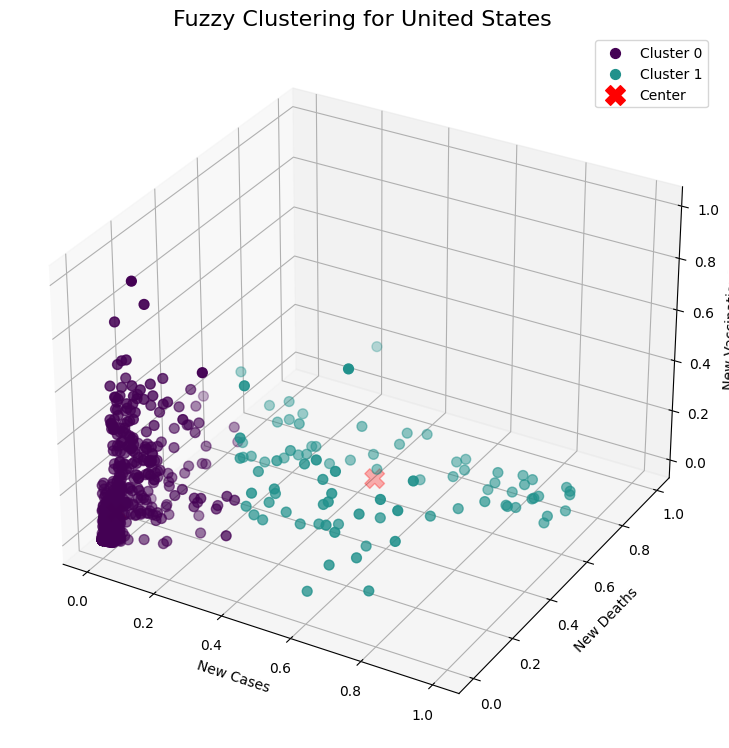

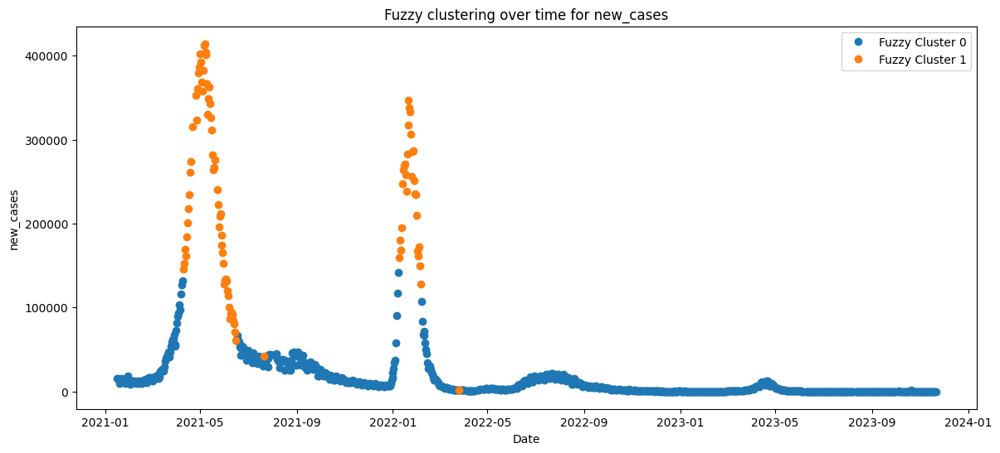

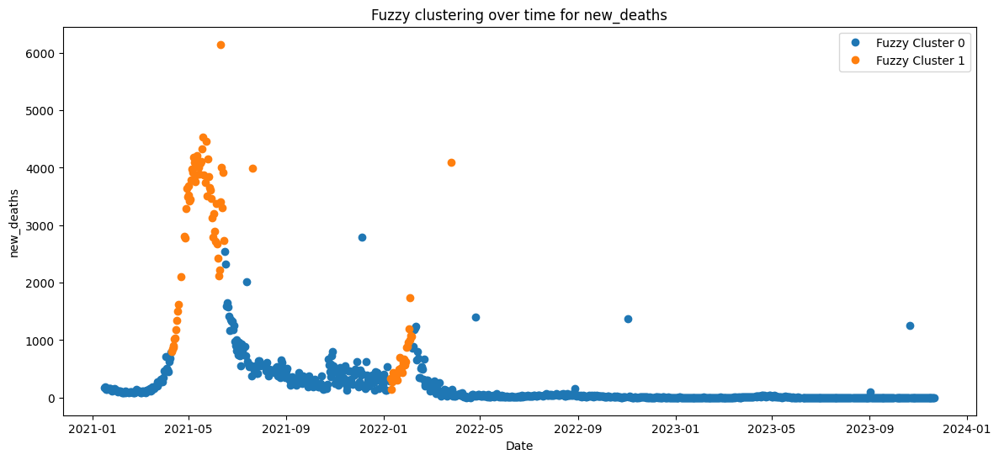

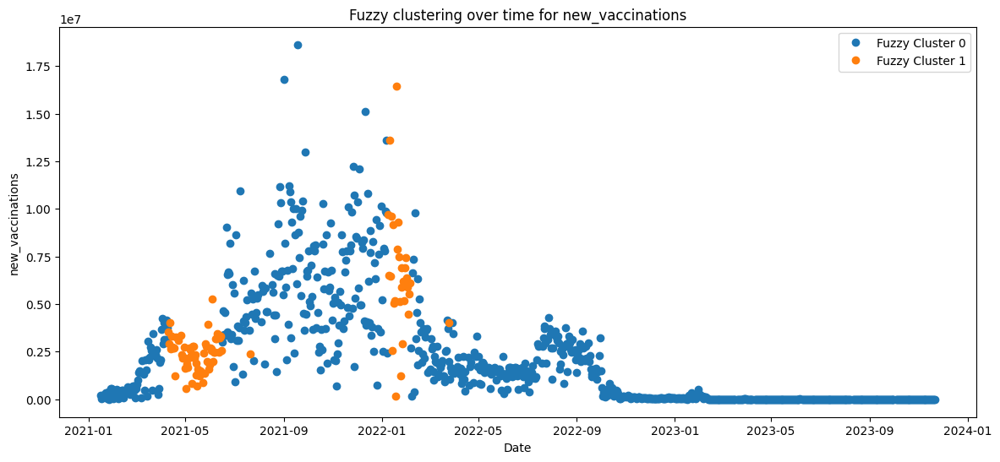

In [41]:
india_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'India', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(india_data_with_clusters)
plot_variables_over_time(india_data_with_clusters)


K-mean Clustering for China
Number of Clusters: 3
Silhouette Score: 0.670
Davies-Bouldin Score: 0.626
Calinski-Harabasz Score: 923.334

Size of this K-mean
For K-mean, Cluster 0 size: 163
For K-mean, Cluster 1 size: 481
For K-mean, Cluster 2 size: 18

K-mean Cluster sizes
                          new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                             
0                      1.504969e+02     5.092025      1.374569e+07
1                      5.086447e+04    56.449064      2.377333e+06
2                      4.027113e+06  2058.222222      1.308389e+06
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-04-29 2022-01-05
1                     2021-03-23 2023-01-13
2                     2022-12-18 2023-01-04

K-mean

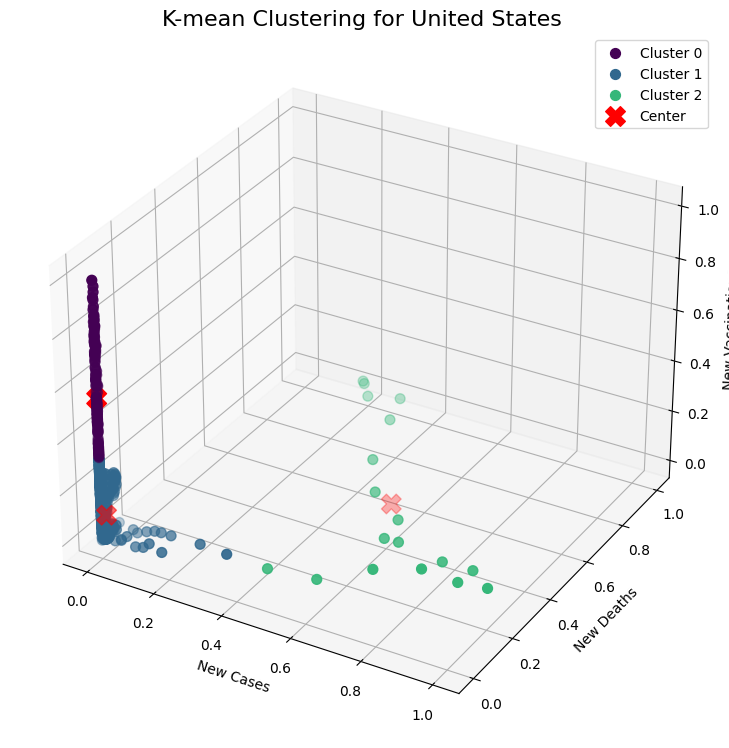

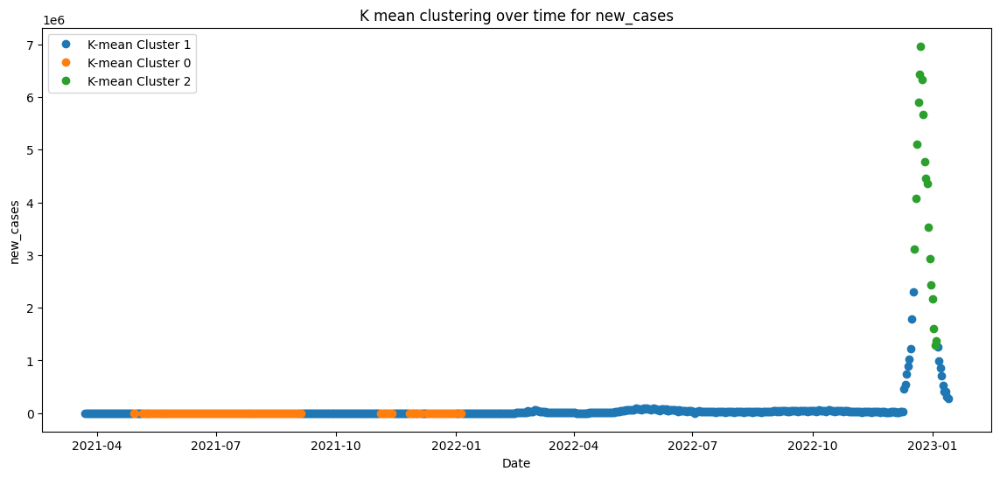

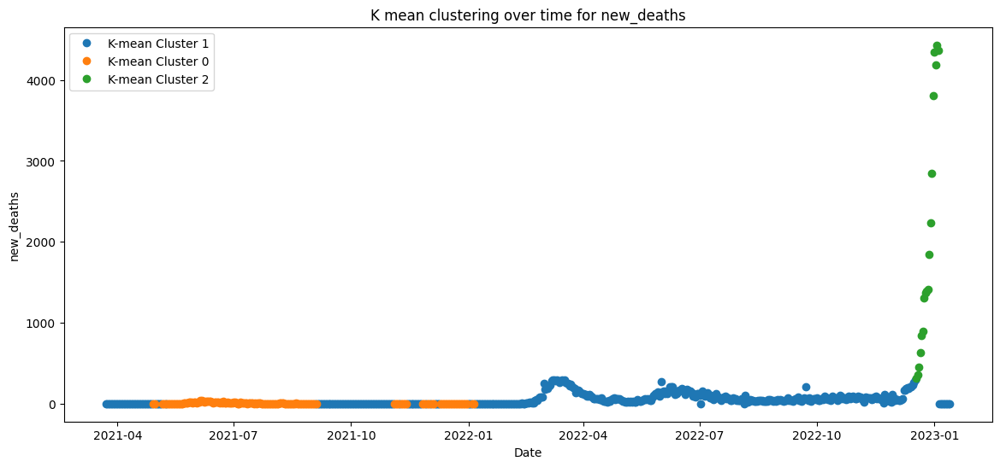

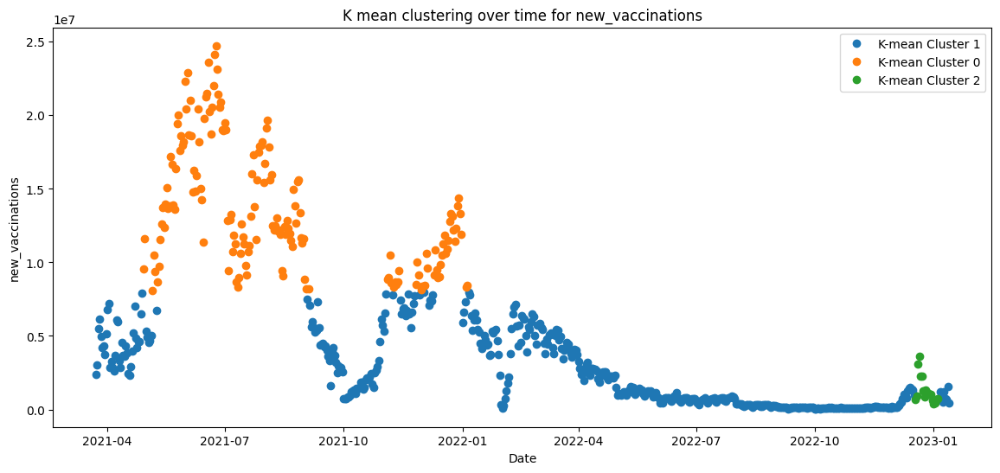

In [42]:
china_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'China', 'K-mean',  filtered_forCountry_df)
summarize_clusters(china_data_with_clusters)
plot_variables_over_time(china_data_with_clusters)



Fuzzy Clustering for China
Number of Clusters: 3
Silhouette Score: 0.531
Davies-Bouldin Score: 0.682
Calinski-Harabasz Score: 610.742

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 116
For Fuzzy, Cluster 1 size: 202
For Fuzzy, Cluster 2 size: 344

Fuzzy Cluster sizes
                          new_cases  new_deaths  new_vaccinations
Fuzzy_cluster_labels                                             
0                        181.905172    6.801724      1.556632e+07
1                       3831.262376   36.737624      6.303600e+06
2                     279602.811047  165.174419      9.551590e+05
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-04-30 2021-12-31
1                    2021-03-25 2022-03-31
2                    2021-03-23 2023-01-13

Fuzzy people fully vac

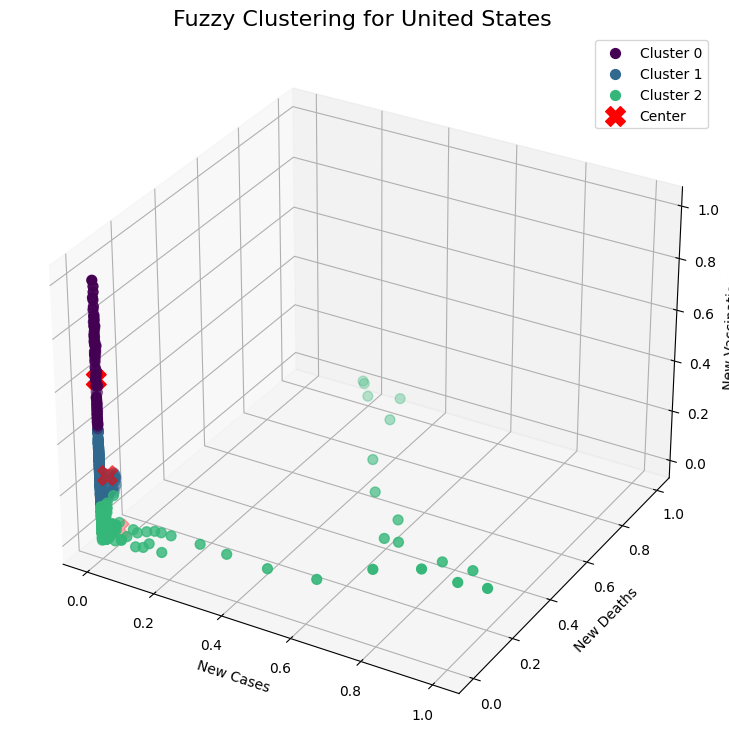

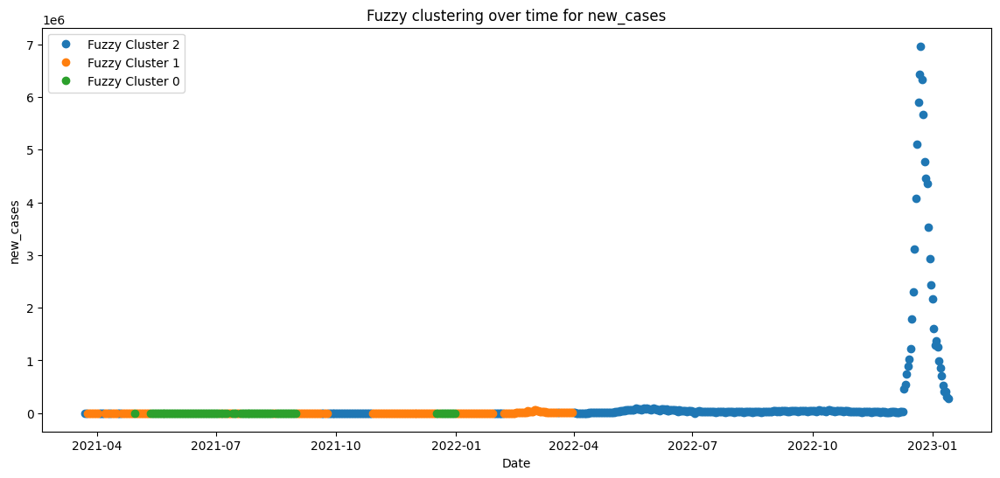

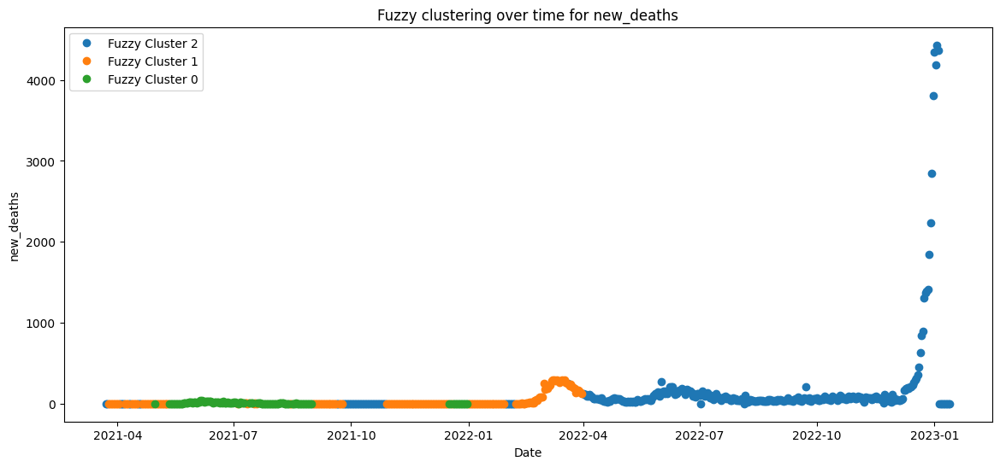

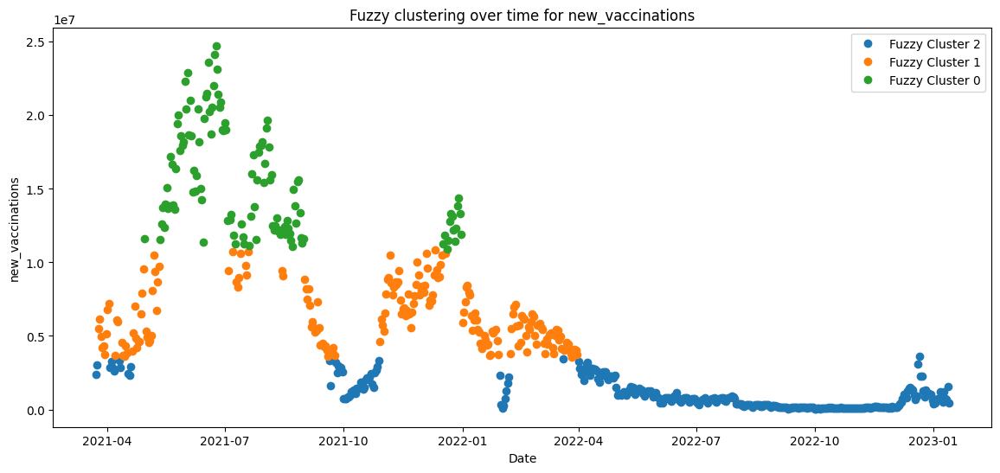

In [43]:
china_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'China', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(china_data_with_clusters)
plot_variables_over_time(china_data_with_clusters)


K-mean Clustering for Brazil
Number of Clusters: 4
Silhouette Score: 0.474
Davies-Bouldin Score: 0.791
Calinski-Harabasz Score: 521.130

Size of this K-mean
For K-mean, Cluster 0 size: 314
For K-mean, Cluster 1 size: 127
For K-mean, Cluster 2 size: 161
For K-mean, Cluster 3 size: 33

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                       21870.894904   227.136943      2.934609e+05
1                       70559.763780  2219.511811      6.341378e+05
2                       26514.285714   570.832298      1.548802e+06
3                      165202.272727   795.242424      1.113834e+06
Cluster 3 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 2 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-01-18 

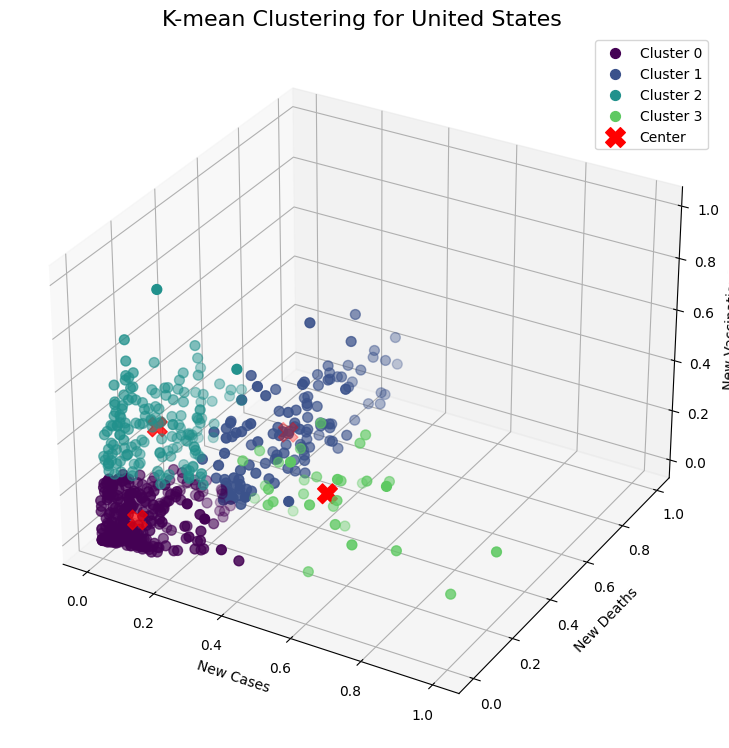

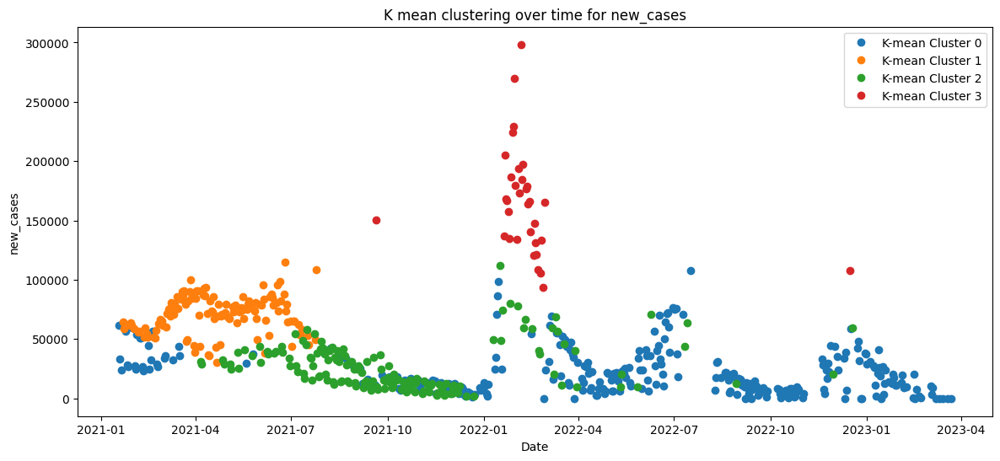

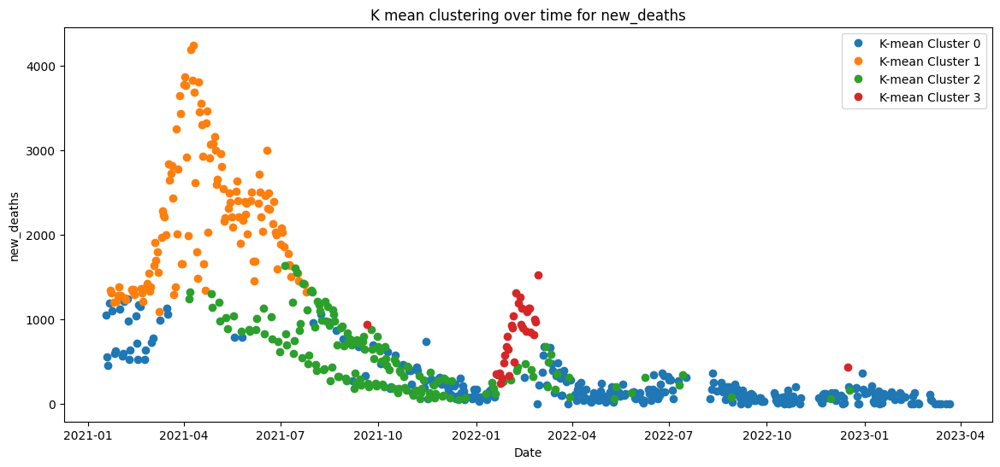

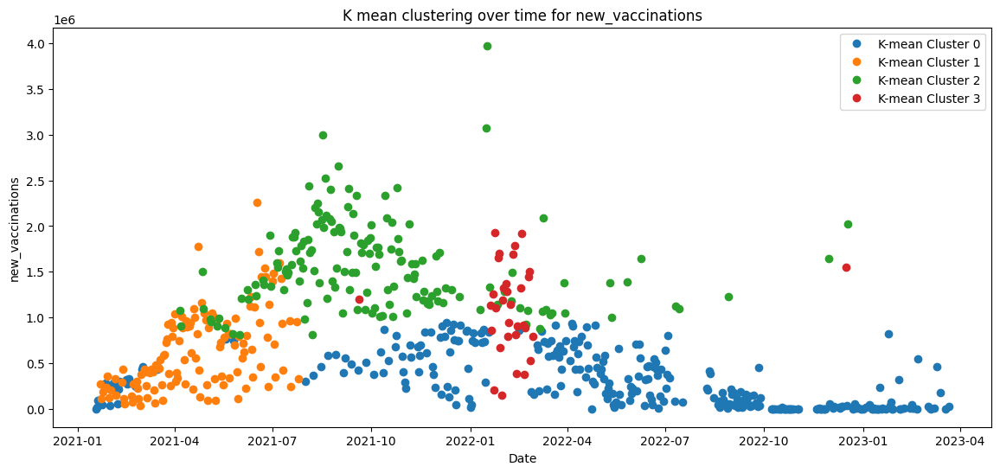

In [44]:
brazil_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'Brazil', 'K-mean',  filtered_forCountry_df)
summarize_clusters(brazil_data_with_clusters)
plot_variables_over_time(brazil_data_with_clusters)


Fuzzy Clustering for Brazil
Number of Clusters: 4
Silhouette Score: 0.454
Davies-Bouldin Score: 1.041
Calinski-Harabasz Score: 502.837

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 152
For Fuzzy, Cluster 1 size: 113
For Fuzzy, Cluster 2 size: 80
For Fuzzy, Cluster 3 size: 290

Fuzzy Cluster sizes
                         new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                             
0                     26054.894737   535.381579      1.588320e+06
1                     87327.778761  1116.955752      6.656213e+05
2                     77848.837500  2668.000000      7.269215e+05
3                     18940.468966   173.489655      2.896629e+05
Cluster 1 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-04-06 2022-12-18
1           

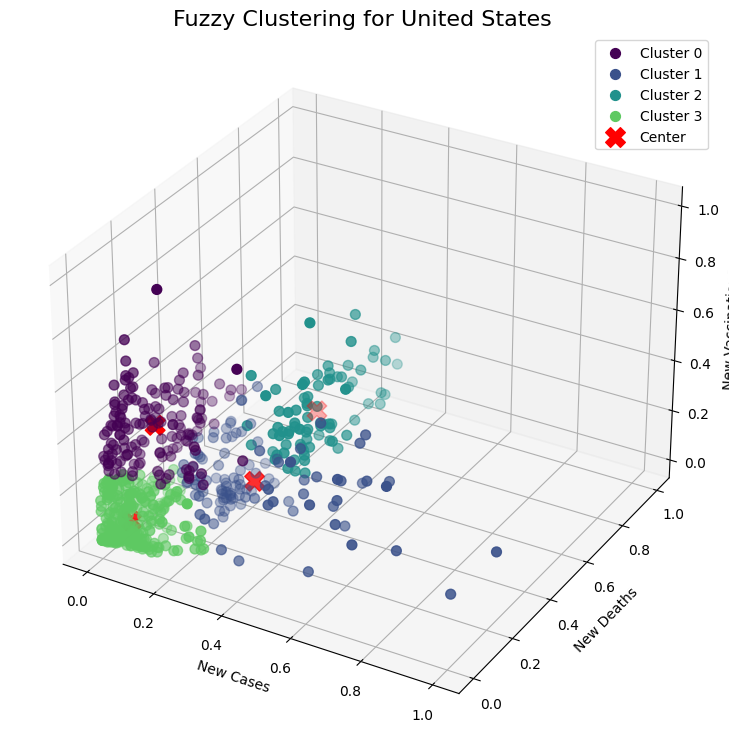

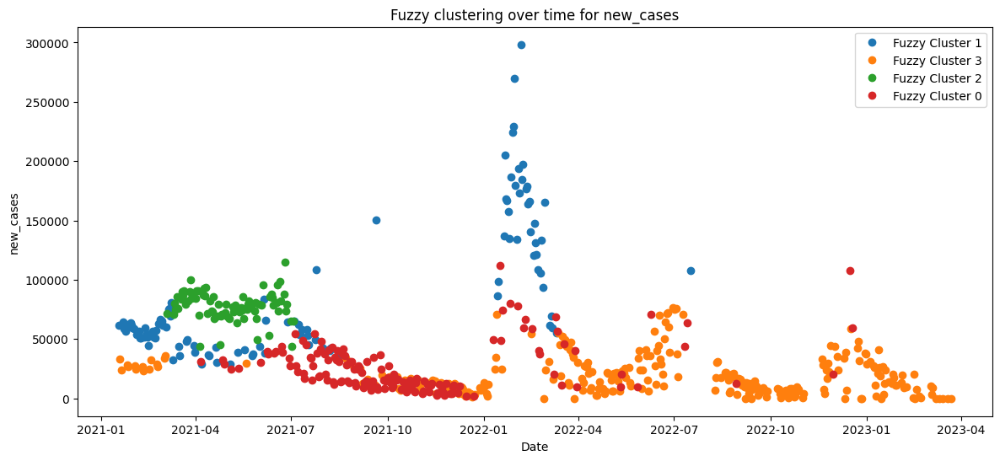

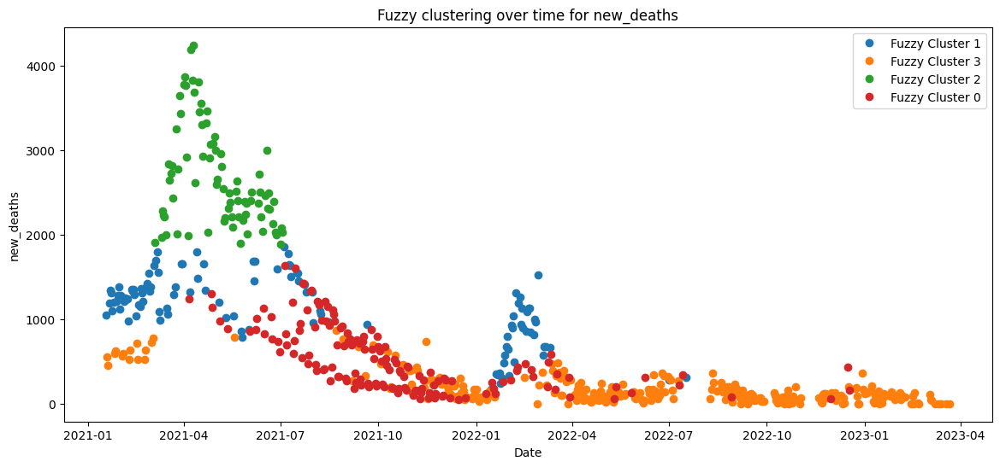

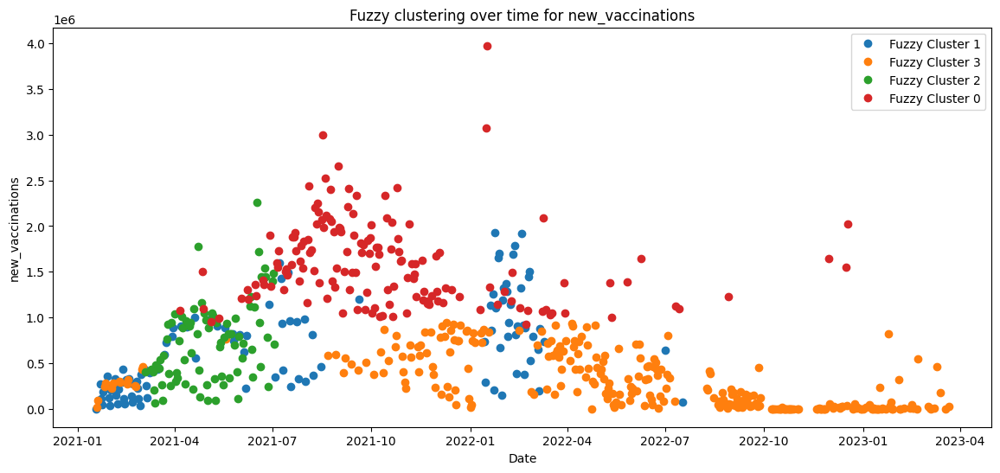

In [45]:
brazil_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'Brazil', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(brazil_data_with_clusters)
plot_variables_over_time(brazil_data_with_clusters)


K-mean Clustering for France
Number of Clusters: 3
Silhouette Score: 0.725
Davies-Bouldin Score: 0.649
Calinski-Harabasz Score: 1528.656

Size of this K-mean
For K-mean, Cluster 0 size: 180
For K-mean, Cluster 1 size: 707
For K-mean, Cluster 2 size: 38

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                           0.000000     0.000000     582633.572222
1                       20696.294201    48.158416      67106.055163
2                      579656.631579  1852.710526      57227.000000
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-03-12 2022-01-28
1                     2020-12-28 2023-07-10
2                     2021-01-03 2022-04-24


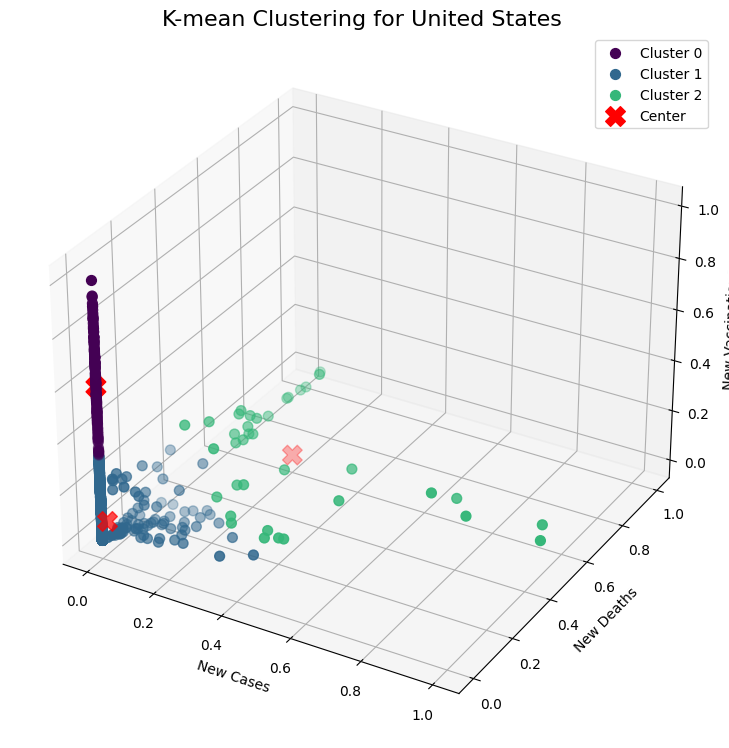

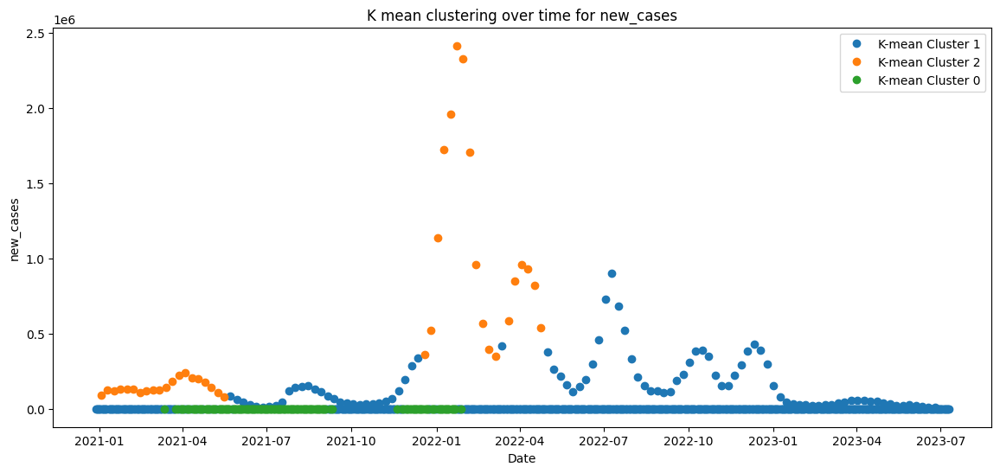

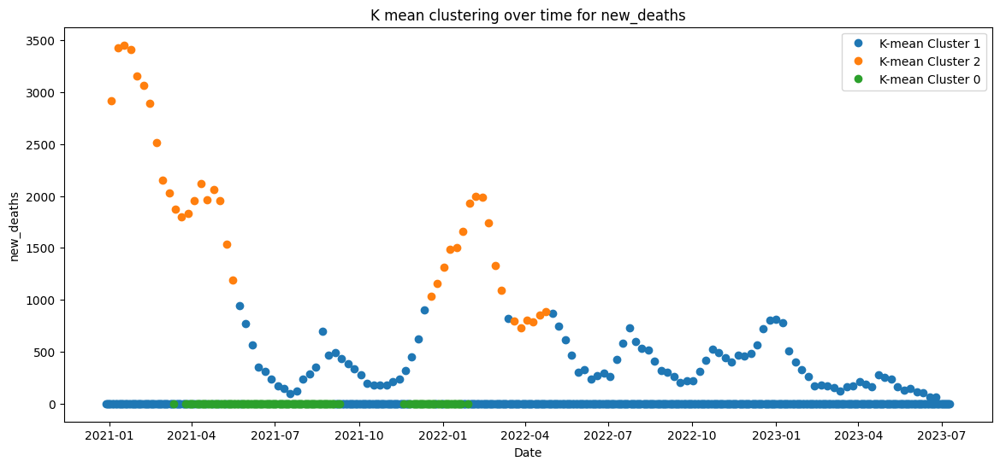

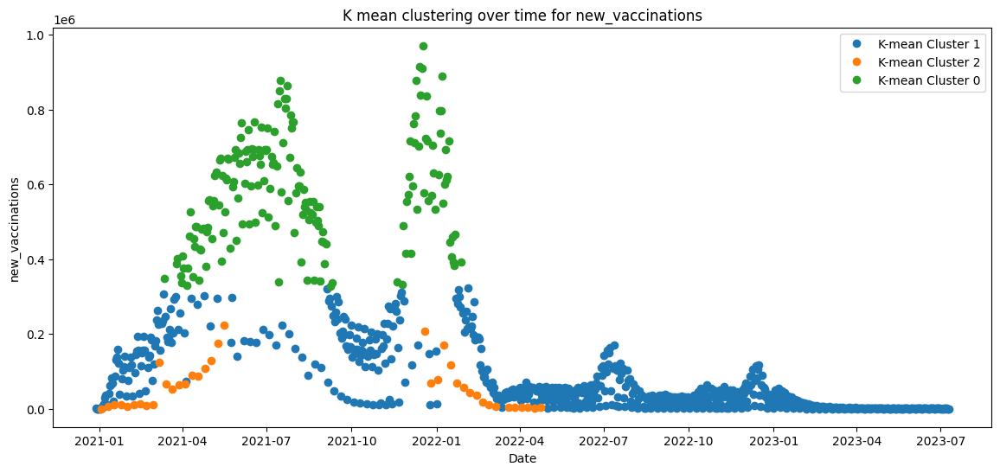

In [46]:
france_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'France', 'K-mean',  filtered_forCountry_df)
summarize_clusters(france_data_with_clusters)
plot_variables_over_time(france_data_with_clusters)


Fuzzy Clustering for France
Number of Clusters: 3
Silhouette Score: 0.725
Davies-Bouldin Score: 0.649
Calinski-Harabasz Score: 1528.656

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 38
For Fuzzy, Cluster 1 size: 707
For Fuzzy, Cluster 2 size: 180

Fuzzy Cluster sizes
                          new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                              
0                     579656.631579  1852.710526      57227.000000
1                      20696.294201    48.158416      67106.055163
2                          0.000000     0.000000     582633.572222
Cluster 0 has the highest average new cases.
Cluster 0 has the highest average new deaths.
Cluster 2 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-01-03 2022-04-24
1                    2020-12-28 2023-07-10
2                    2021-03-12 2022-01-28

Fuzzy people ful

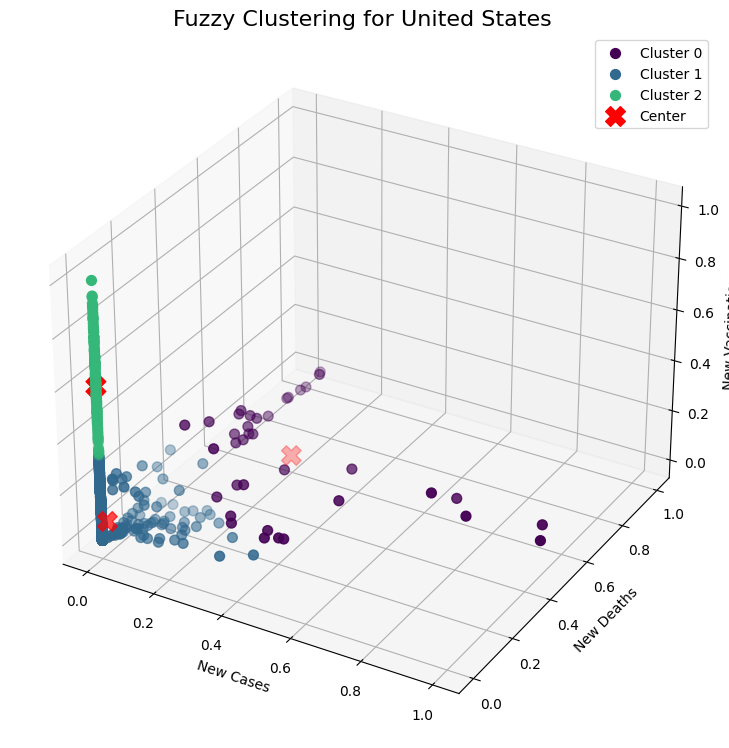

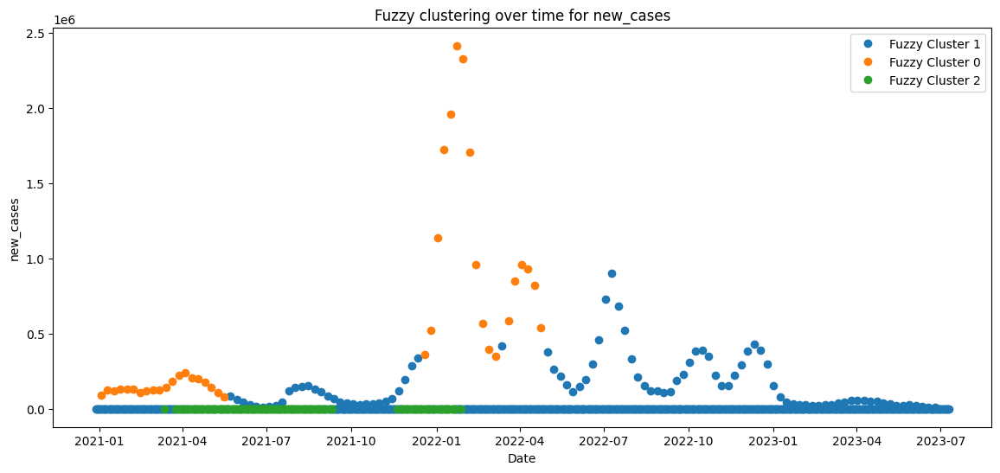

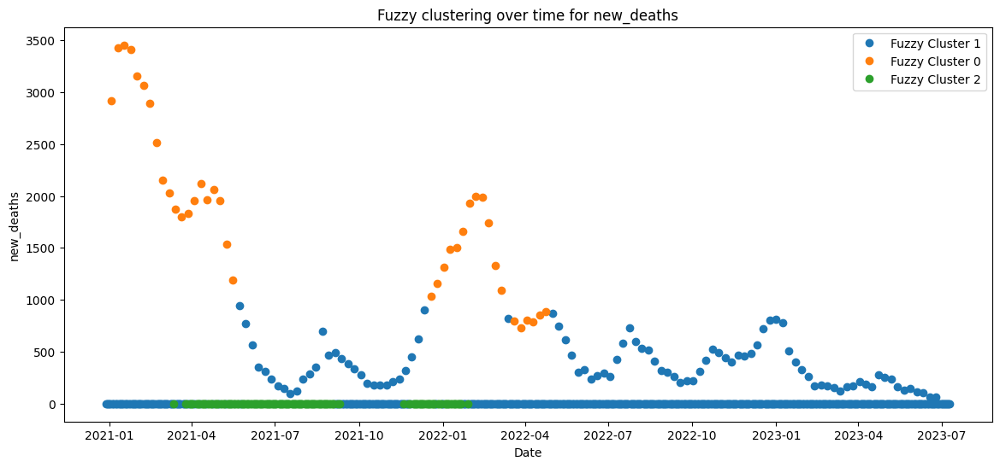

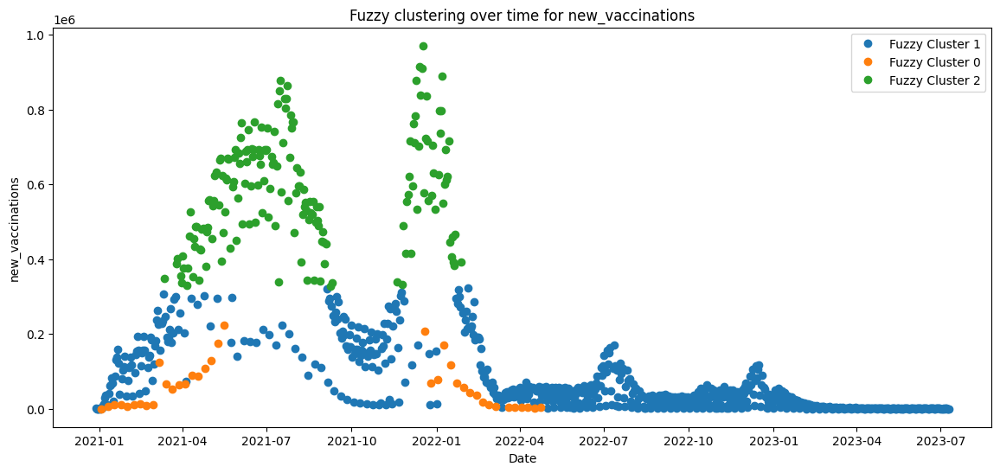

In [47]:
france_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'France', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(france_data_with_clusters)
plot_variables_over_time(france_data_with_clusters)


K-mean Clustering for Germany
Number of Clusters: 3
Silhouette Score: 0.702
Davies-Bouldin Score: 0.701
Calinski-Harabasz Score: 988.201

Size of this K-mean
For K-mean, Cluster 0 size: 128
For K-mean, Cluster 1 size: 664
For K-mean, Cluster 2 size: 39

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                           0.000000     0.000000     872701.664062
1                       15067.777108    80.635542     118068.731928
2                      684402.307692  1868.717949      53681.794872
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-04-07 2022-01-27
1                     2020-12-28 2023-04-07
2                     2021-01-03 2022-10-30


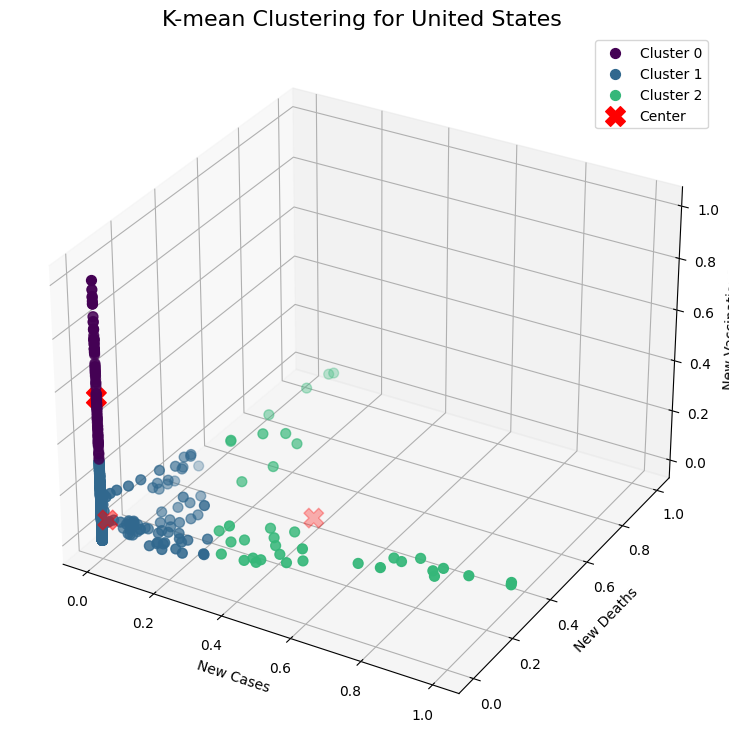

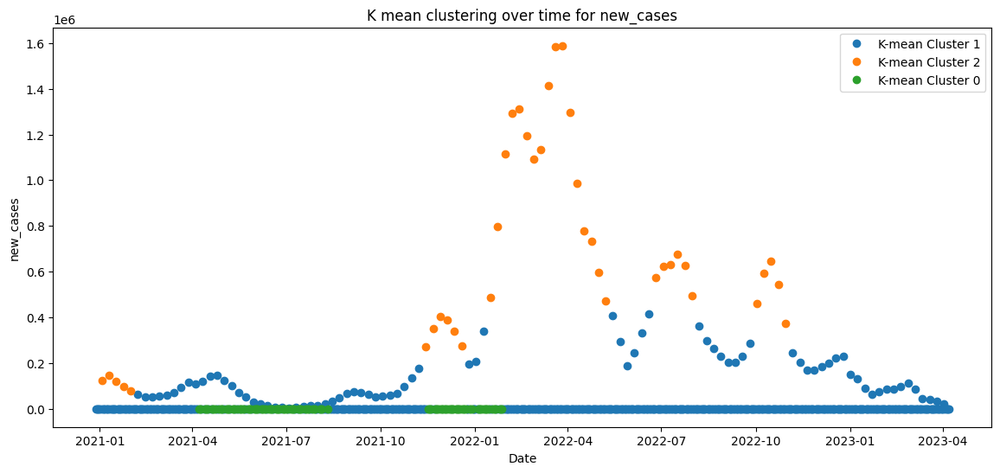

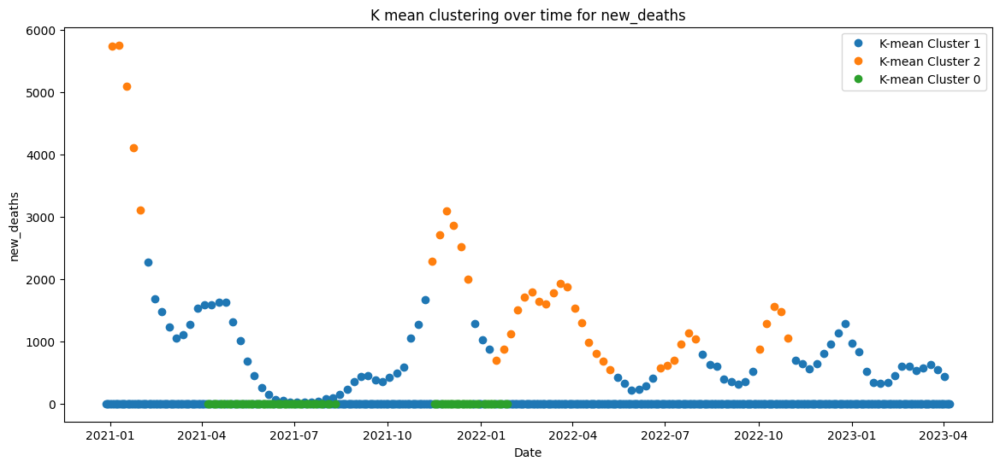

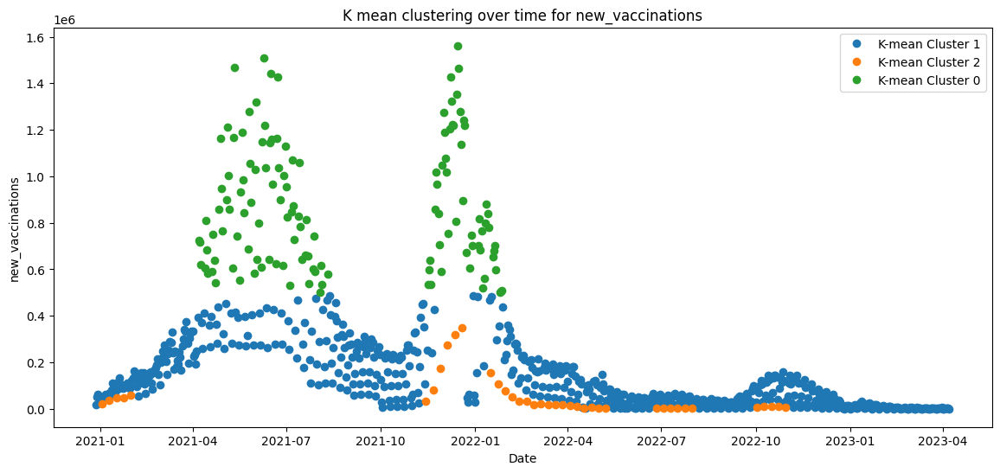

In [48]:
germany_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'Germany', 'K-mean',  filtered_forCountry_df)
summarize_clusters(germany_data_with_clusters)
plot_variables_over_time(germany_data_with_clusters)


Fuzzy Clustering for Germany
Number of Clusters: 3
Silhouette Score: 0.702
Davies-Bouldin Score: 0.701
Calinski-Harabasz Score: 988.201

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 39
For Fuzzy, Cluster 1 size: 664
For Fuzzy, Cluster 2 size: 128

Fuzzy Cluster sizes
                          new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                              
0                     684402.307692  1868.717949      53681.794872
1                      15067.777108    80.635542     118068.731928
2                          0.000000     0.000000     872701.664062
Cluster 0 has the highest average new cases.
Cluster 0 has the highest average new deaths.
Cluster 2 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-01-03 2022-10-30
1                    2020-12-28 2023-04-07
2                    2021-04-07 2022-01-27

Fuzzy people ful

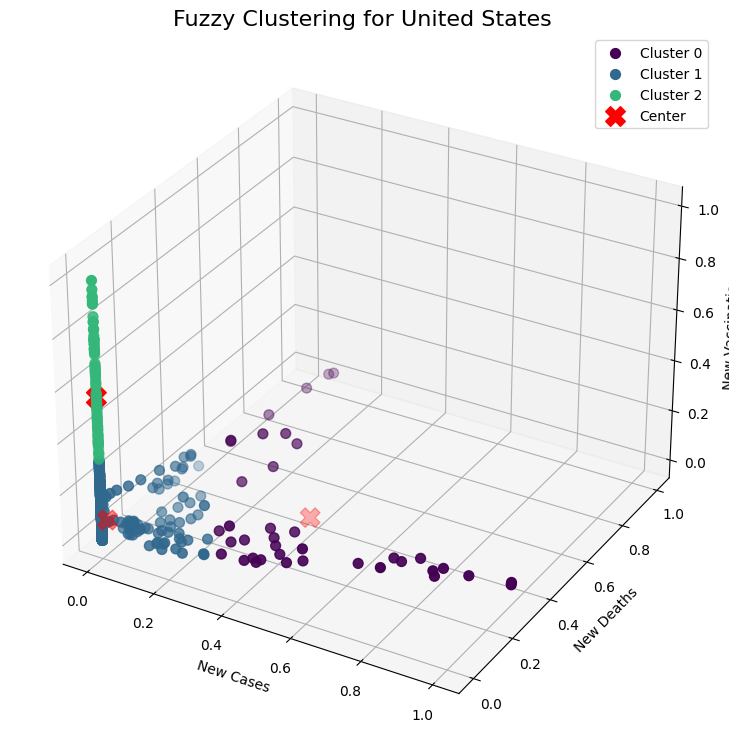

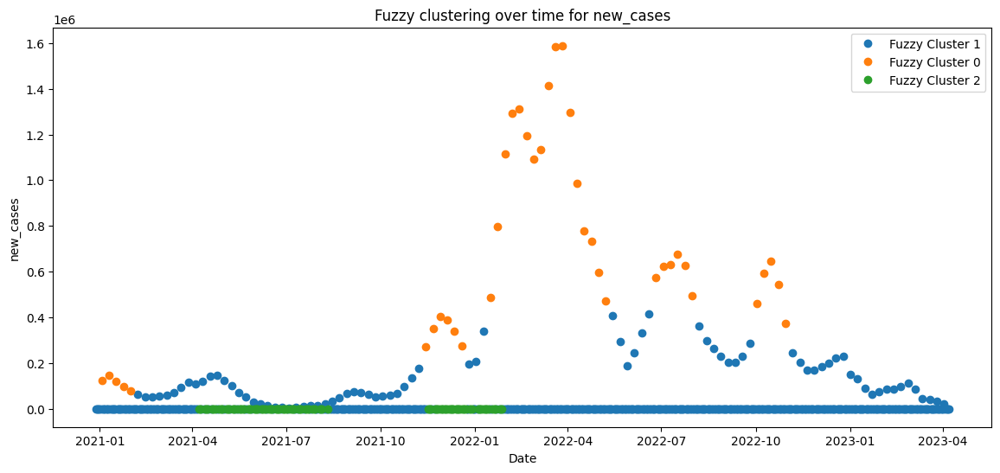

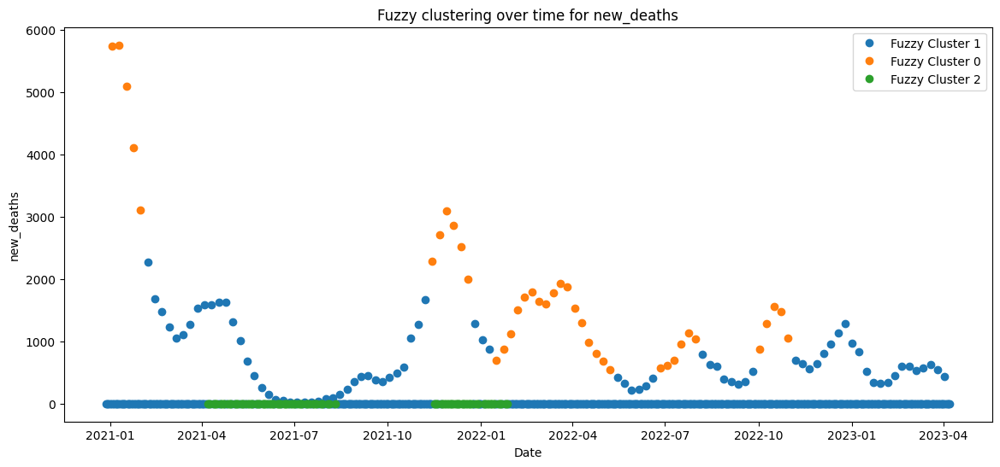

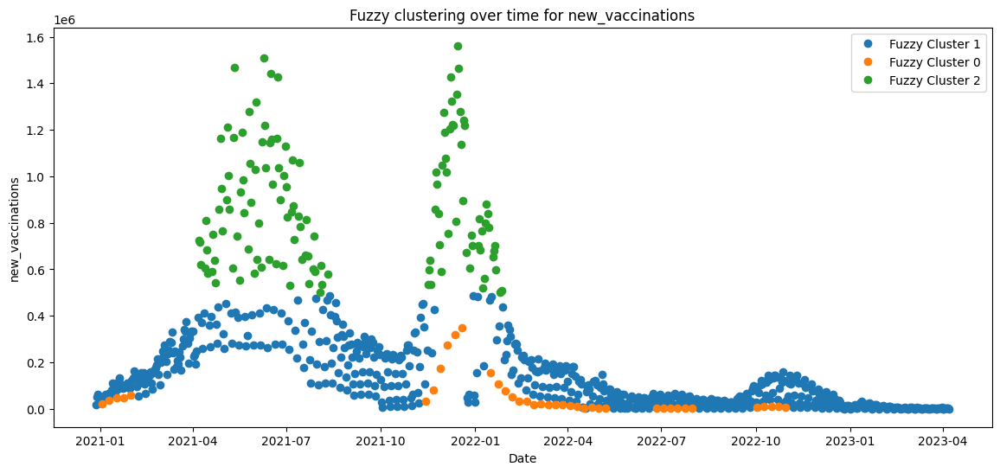

In [49]:
germany_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'Germany', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(germany_data_with_clusters)
plot_variables_over_time(germany_data_with_clusters)


K-mean Clustering for United Kingdom
Number of Clusters: 4
Silhouette Score: 0.509
Davies-Bouldin Score: 0.692
Calinski-Harabasz Score: 522.694

Size of this K-mean
For K-mean, Cluster 0 size: 172
For K-mean, Cluster 1 size: 339
For K-mean, Cluster 2 size: 38
For K-mean, Cluster 3 size: 51

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                       23175.802326   101.651163     510769.250000
1                       25919.457227   107.861357     113586.091445
2                       26146.789474  1068.578947     376811.447368
3                      125880.274510   192.196078     150306.313725
Cluster 3 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021

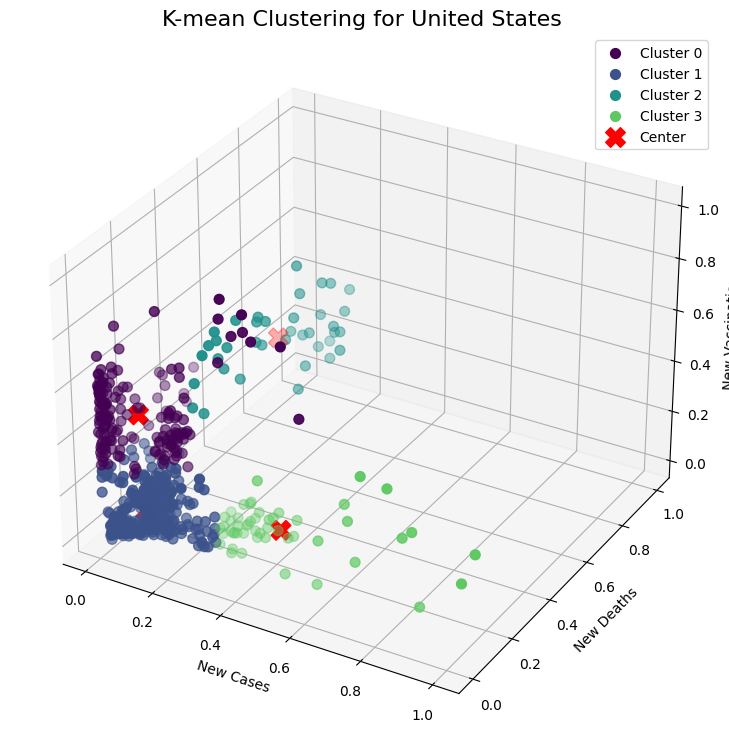

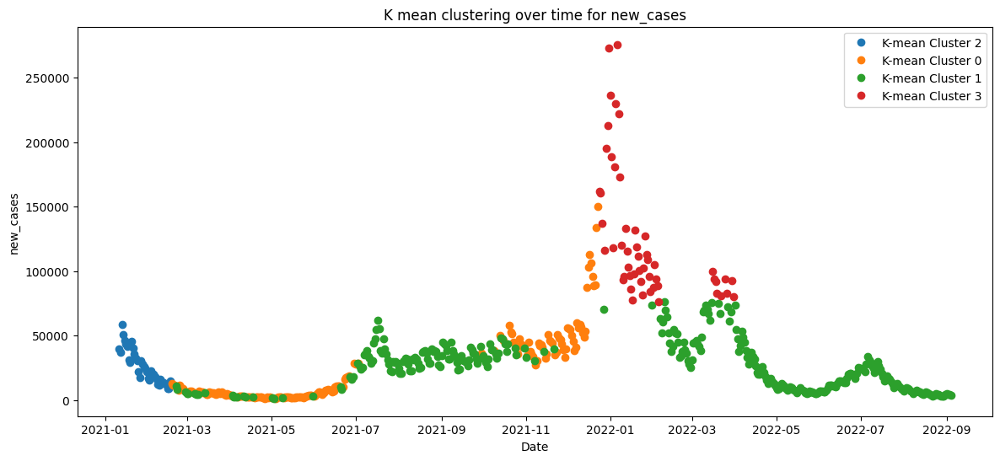

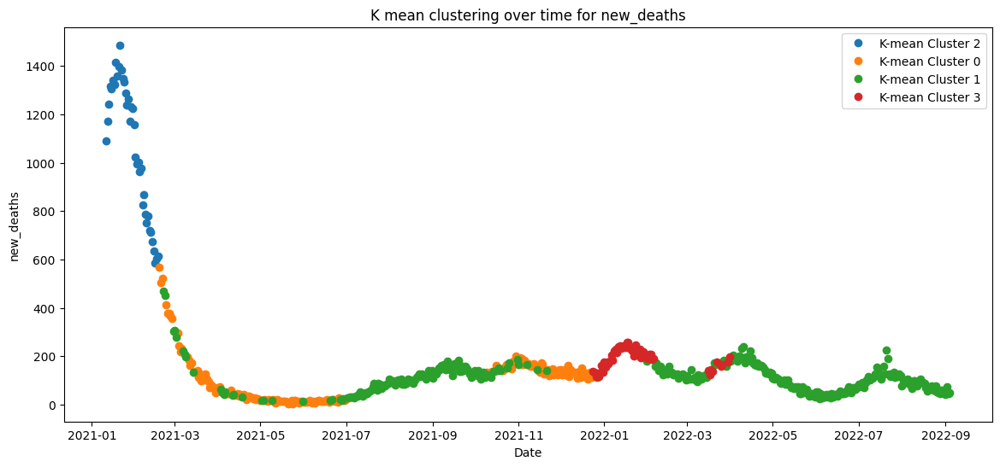

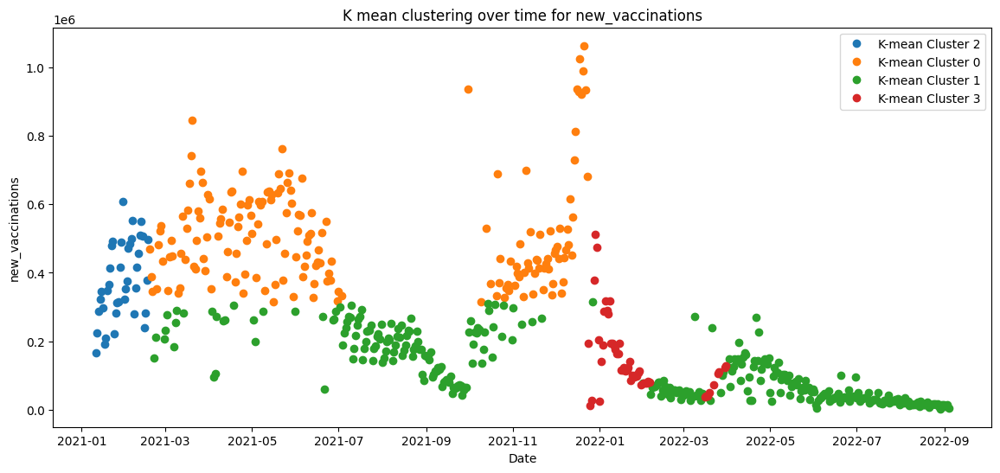

In [50]:
uk_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'United Kingdom', 'K-mean',  filtered_forCountry_df)
summarize_clusters(uk_data_with_clusters)
plot_variables_over_time(uk_data_with_clusters)


Fuzzy Clustering for United Kingdom
Number of Clusters: 4
Silhouette Score: 0.490
Davies-Bouldin Score: 0.793
Calinski-Harabasz Score: 352.107

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 26
For Fuzzy, Cluster 1 size: 23
For Fuzzy, Cluster 2 size: 166
For Fuzzy, Cluster 3 size: 385

Fuzzy Cluster sizes
                         new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                             
0                     31999.961538  1232.653846     357588.307692
1                     11777.173913   576.347826     402514.000000
2                     26407.421687    84.433735     514046.042169
3                     38181.558442   117.236364     115469.329870
Cluster 3 has the highest average new cases.
Cluster 0 has the highest average new deaths.
Cluster 2 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-01-11 2021-02-05
1    

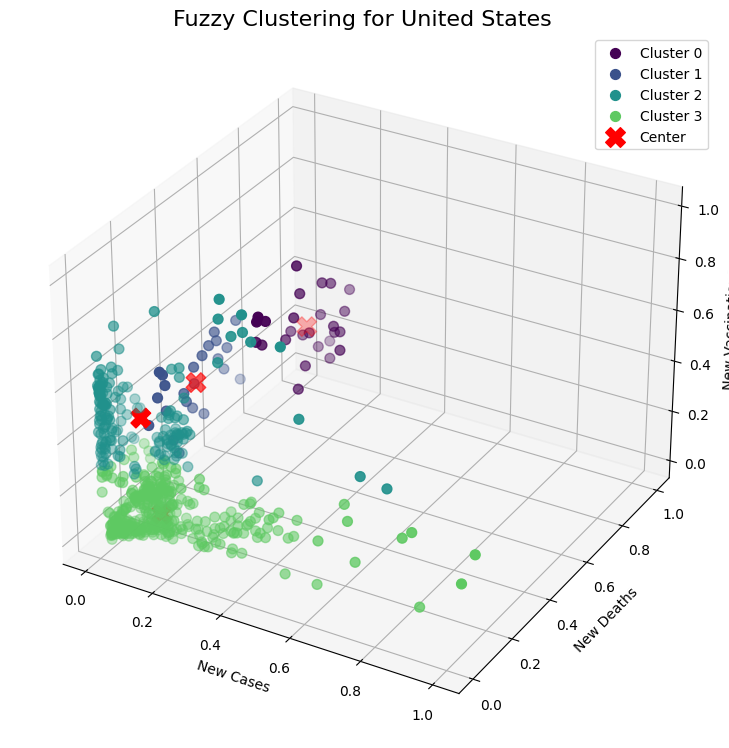

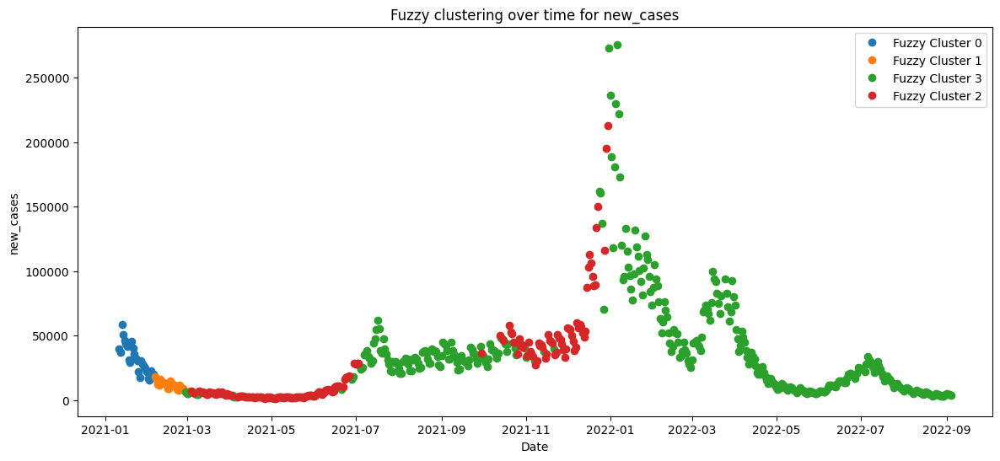

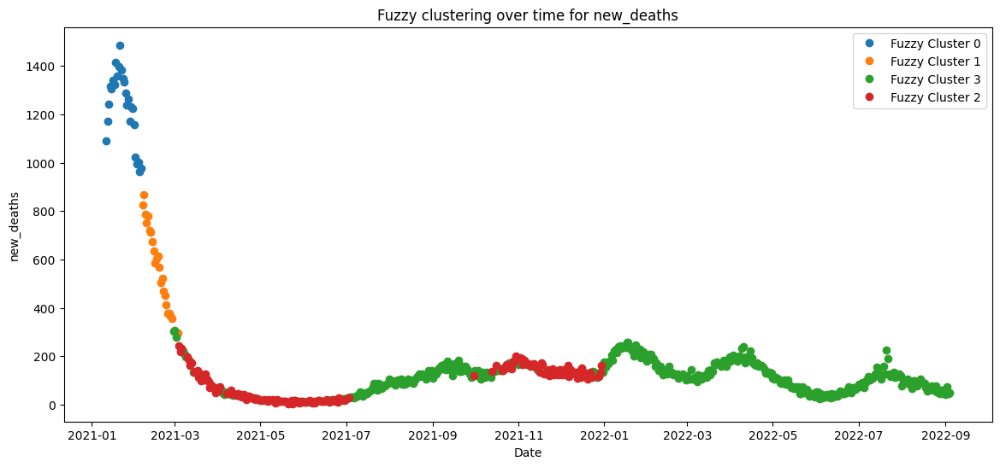

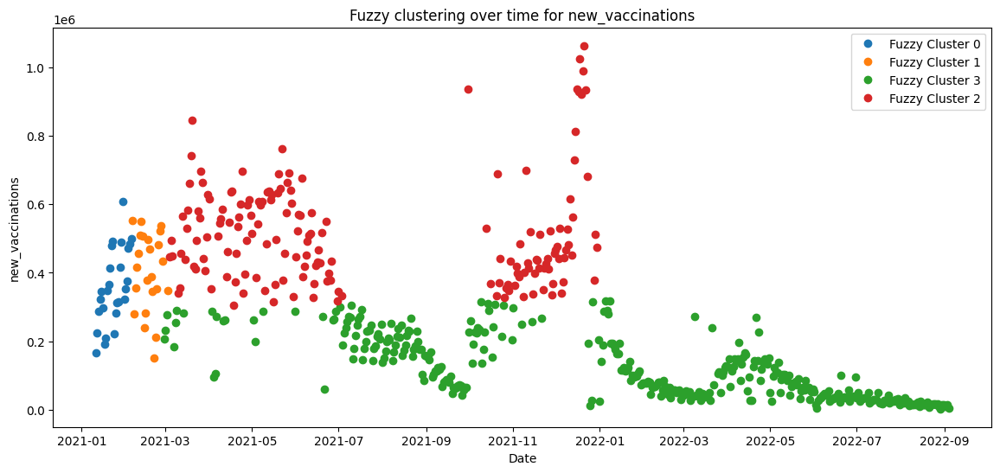

In [51]:
uk_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'United Kingdom', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(uk_data_with_clusters)
plot_variables_over_time(uk_data_with_clusters)


K-mean Clustering for South Korea
Number of Clusters: 3
Silhouette Score: 0.642
Davies-Bouldin Score: 0.524
Calinski-Harabasz Score: 984.015

Size of this K-mean
For K-mean, Cluster 0 size: 497
For K-mean, Cluster 1 size: 108
For K-mean, Cluster 2 size: 47

K-mean Cluster sizes
                           new_cases  new_deaths  new_vaccinations
K-mean_cluster_labels                                             
0                       28954.778672   28.211268      91607.853119
1                        2864.277778   22.944444     757336.694444
2                      274343.085106  277.276596      48064.255319
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 1 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-02-27 2022-12-12
1                     2021-05-27 2022-01-28
2                     2022-03-02 2022-04-21



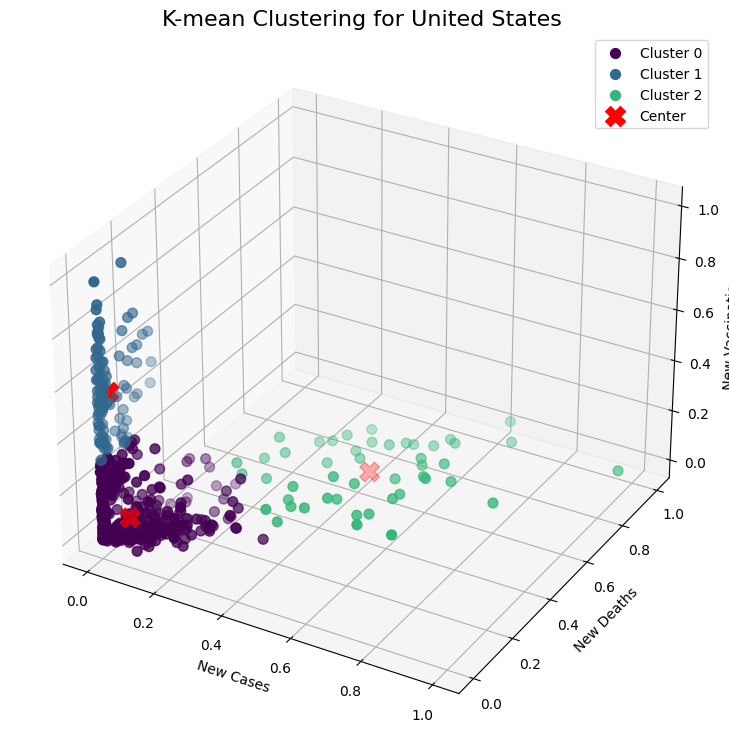

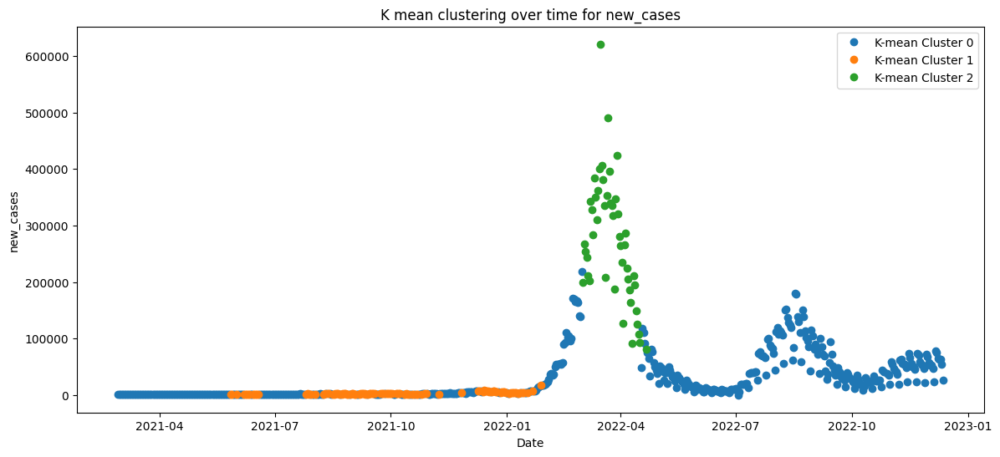

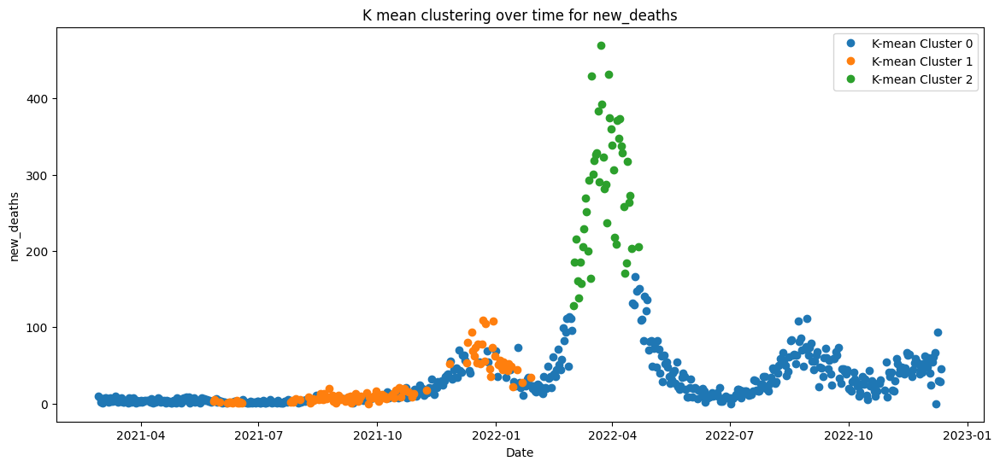

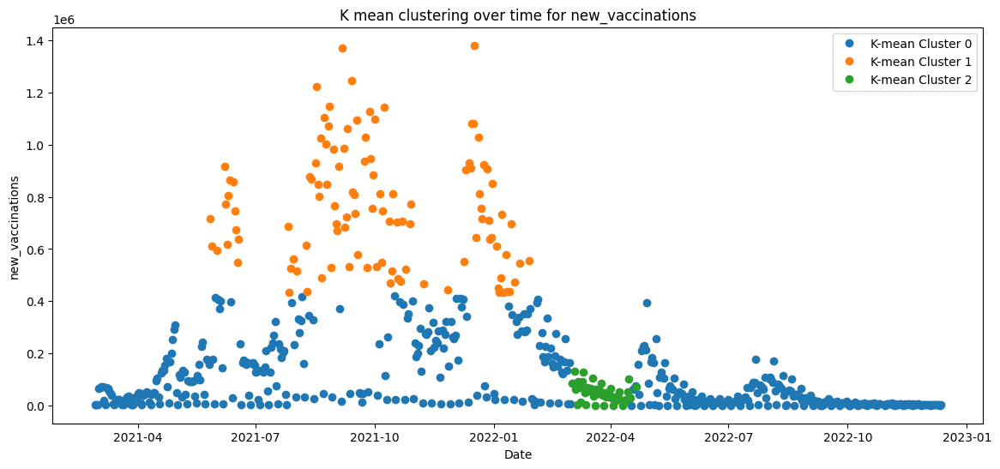

In [52]:
south_korea_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'South Korea', 'K-mean',  filtered_forCountry_df)
summarize_clusters(south_korea_data_with_clusters)
plot_variables_over_time(south_korea_data_with_clusters)


Fuzzy Clustering for South Korea
Number of Clusters: 3
Silhouette Score: 0.640
Davies-Bouldin Score: 0.527
Calinski-Harabasz Score: 983.926

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 495
For Fuzzy, Cluster 1 size: 47
For Fuzzy, Cluster 2 size: 110

Fuzzy Cluster sizes
                          new_cases  new_deaths  new_vaccinations
Fuzzy_cluster_labels                                             
0                      29065.222222   28.286869      90289.048485
1                     274343.085106  277.276596      48064.255319
2                       2841.654545   22.700000     751167.154545
Cluster 1 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 2 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-02-27 2022-12-12
1                    2022-03-02 2022-04-21
2                    2021-05-27 2022-01-28

Fuzzy people full

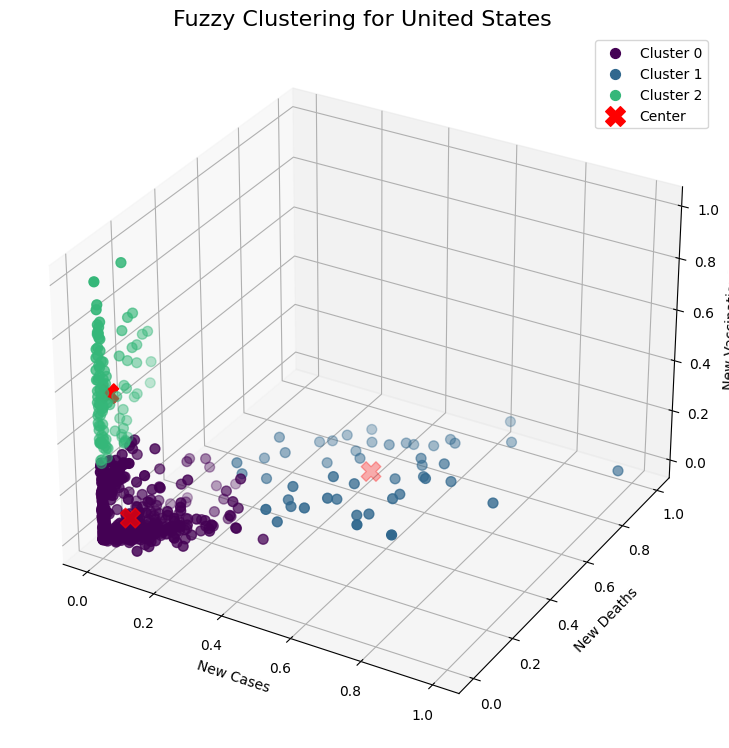

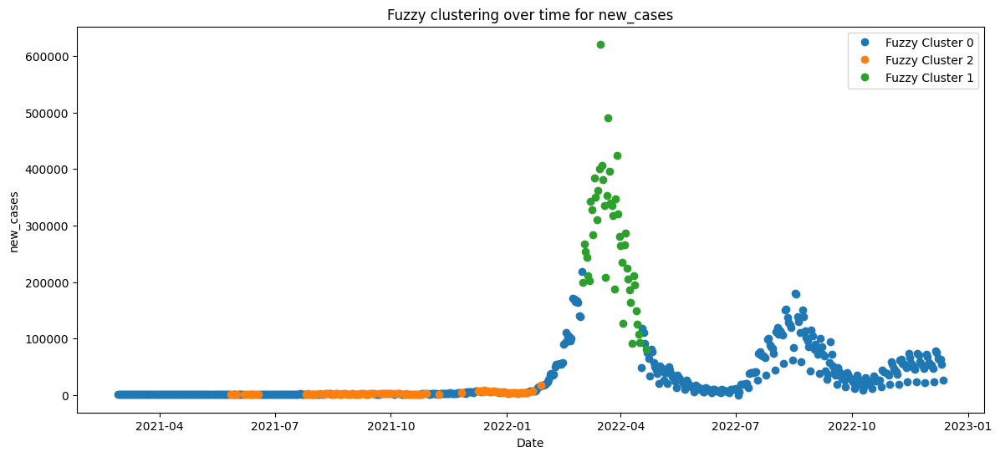

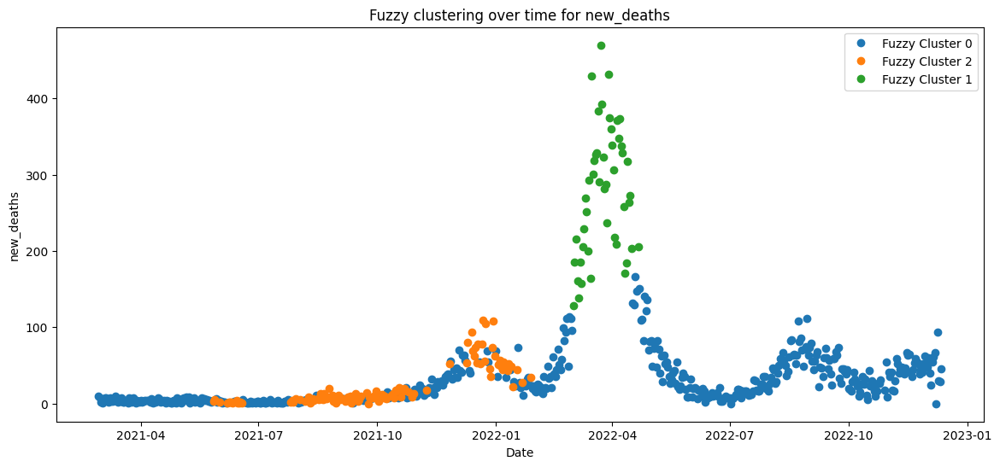

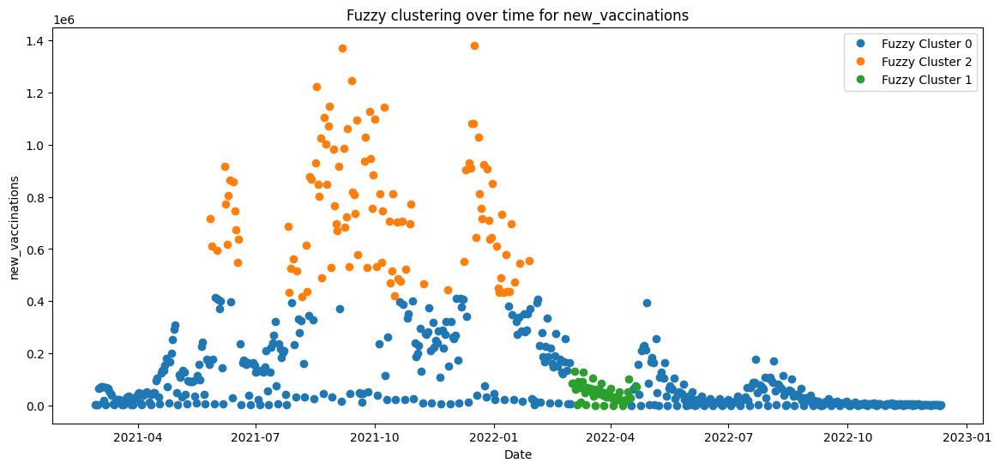

In [53]:
south_korea_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'South Korea', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(south_korea_data_with_clusters)
plot_variables_over_time(south_korea_data_with_clusters)


K-mean Clustering for Italy
Number of Clusters: 4
Silhouette Score: 0.582
Davies-Bouldin Score: 0.661
Calinski-Harabasz Score: 1024.489

Size of this K-mean
For K-mean, Cluster 0 size: 159
For K-mean, Cluster 1 size: 688
For K-mean, Cluster 2 size: 140
For K-mean, Cluster 3 size: 34

K-mean Cluster sizes
                           new_cases  new_deaths  new_vaccinations
K-mean_cluster_labels                                             
0                        8402.094340   81.874214     483148.333333
1                       20759.476744   63.194767      39719.561047
2                       23079.478571  386.050000     160305.085714
3                      157712.588235  307.264706     529726.794118
Cluster 3 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 3 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-04-26 2022-0

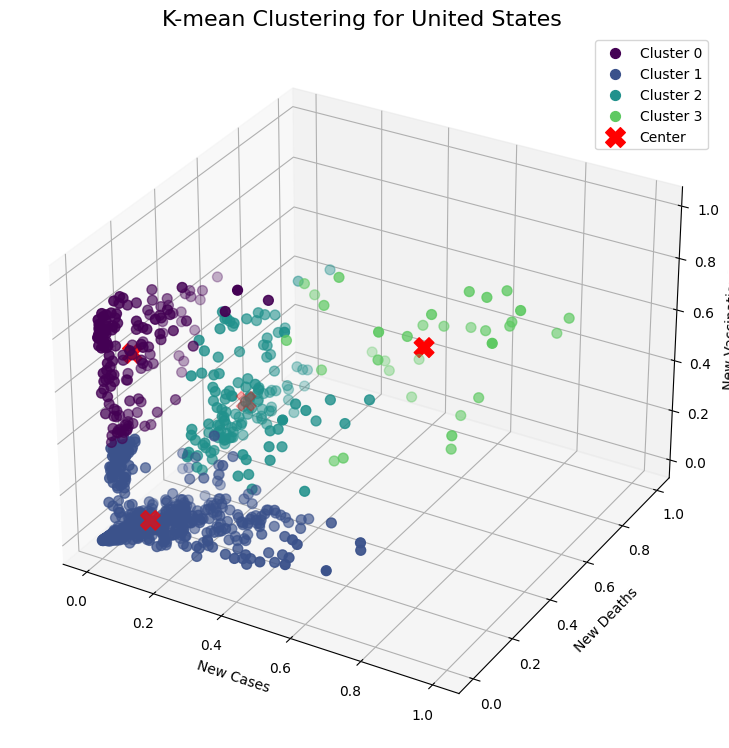

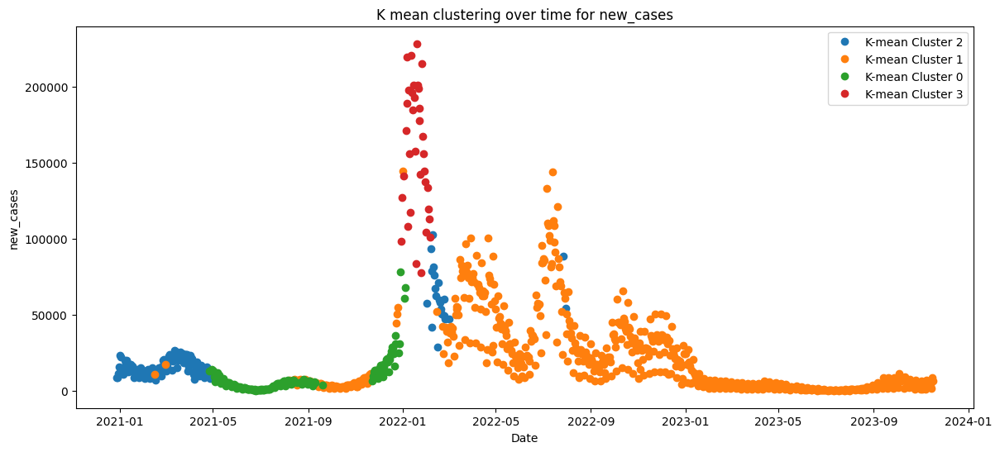

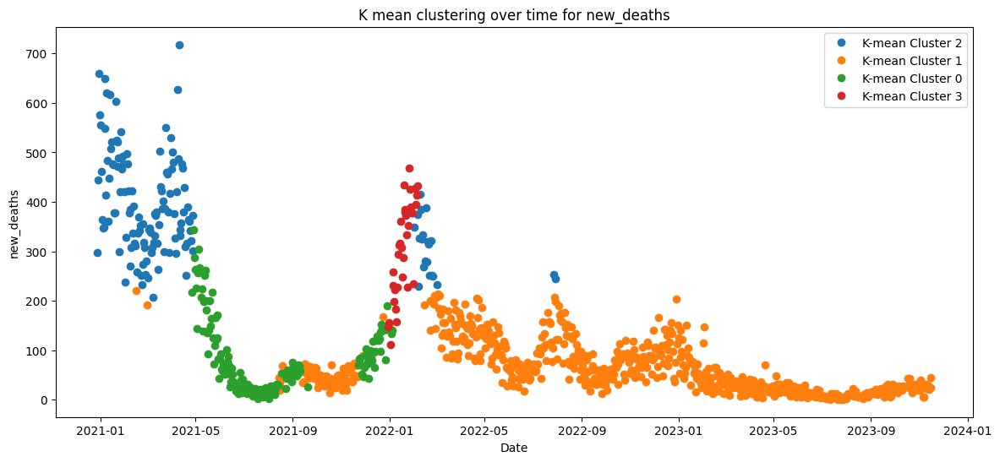

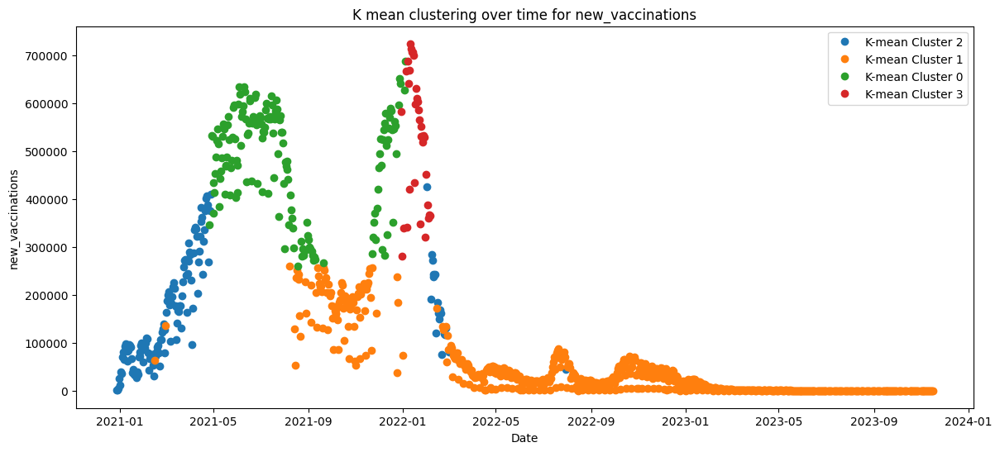

In [54]:
italy_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'Italy', 'K-mean',  filtered_forCountry_df)
summarize_clusters(italy_data_with_clusters)
plot_variables_over_time(italy_data_with_clusters)


Fuzzy Clustering for Italy
Number of Clusters: 4
Silhouette Score: 0.484
Davies-Bouldin Score: 0.795
Calinski-Harabasz Score: 781.143

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 147
For Fuzzy, Cluster 1 size: 120
For Fuzzy, Cluster 2 size: 611
For Fuzzy, Cluster 3 size: 143

Fuzzy Cluster sizes
                         new_cases  new_deaths  new_vaccinations
Fuzzy_cluster_labels                                            
0                     38420.197279  128.619048     542214.129252
1                      7221.858333   57.408333     241467.333333
2                     22615.080196   64.759411      19601.893617
3                     27130.083916  388.993007     167431.832168
Cluster 0 has the highest average new cases.
Cluster 3 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-04-29 2022-02-01
1                 

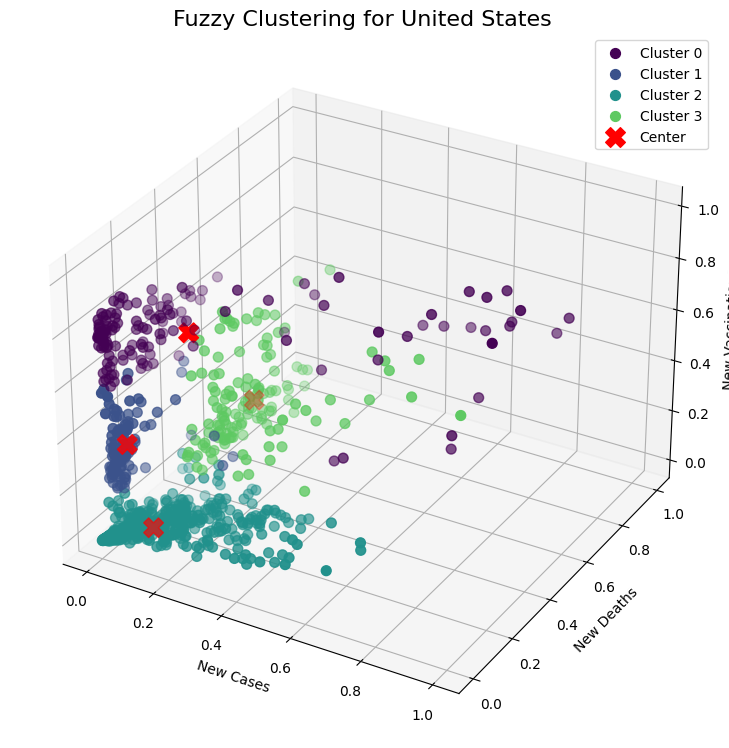

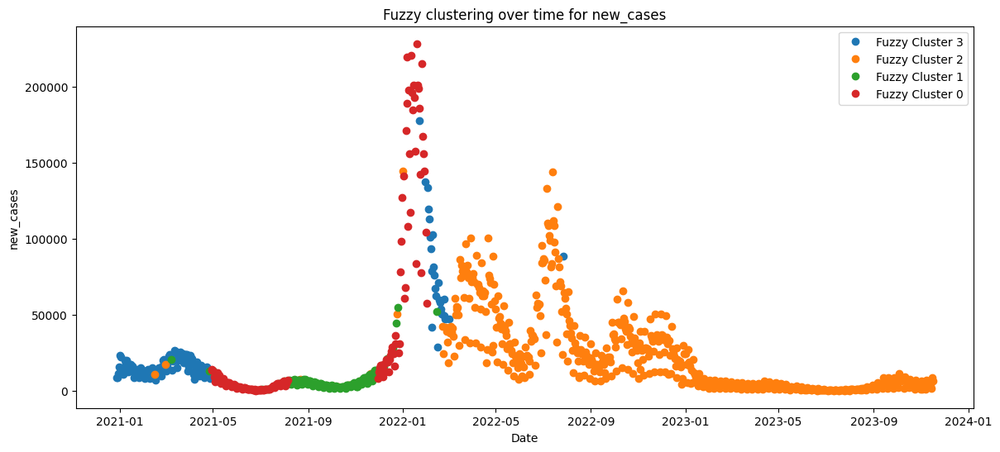

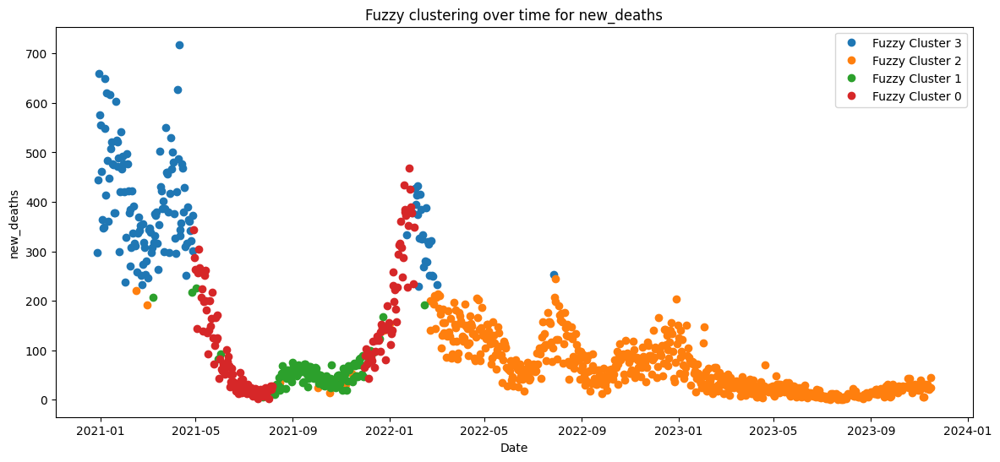

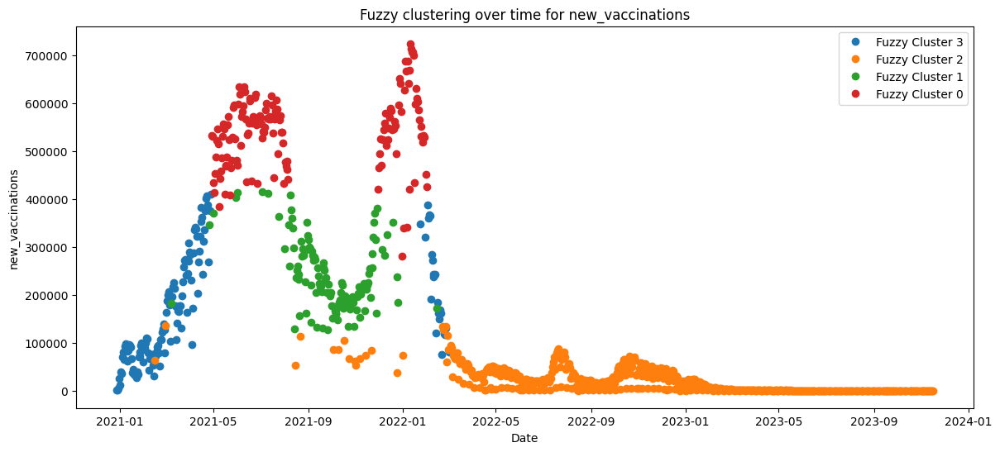

In [55]:
italy_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'Italy', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(italy_data_with_clusters)
plot_variables_over_time(italy_data_with_clusters)


K-mean Clustering for Russia
Number of Clusters: 3
Silhouette Score: 0.521
Davies-Bouldin Score: 0.663
Calinski-Harabasz Score: 350.236

Size of this K-mean
For K-mean, Cluster 0 size: 162
For K-mean, Cluster 1 size: 190
For K-mean, Cluster 2 size: 20

K-mean Cluster sizes
                           new_cases  new_deaths  new_vaccinations
K-mean_cluster_labels                                             
0                       14880.691358  323.246914     226678.290123
1                       28473.694737  897.310526     571554.610526
2                      166892.250000  686.500000     369959.400000
Cluster 2 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 1 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-03-03 2022-12-04
1                     2021-06-24 2022-03-11
2                     2022-01-29 2022-02-17

K-mea

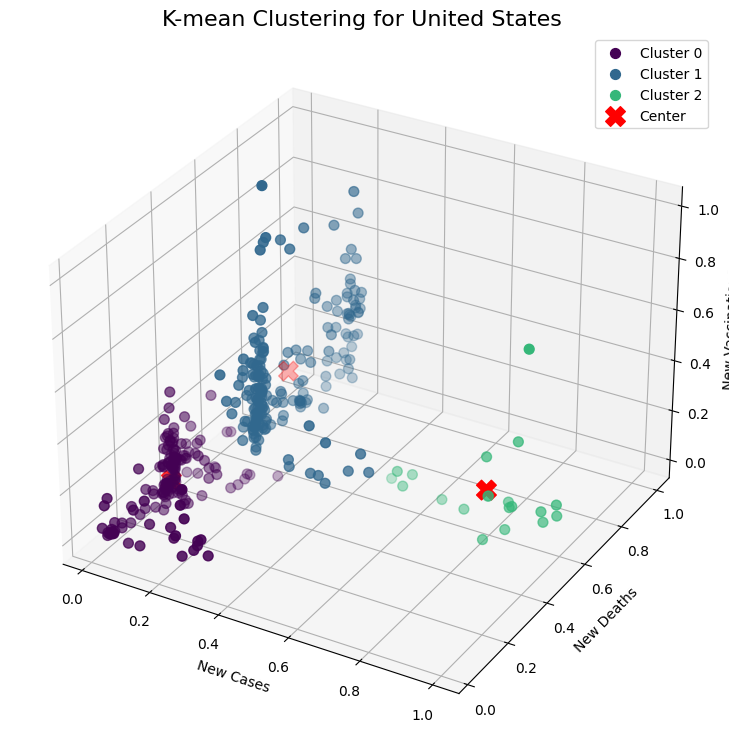

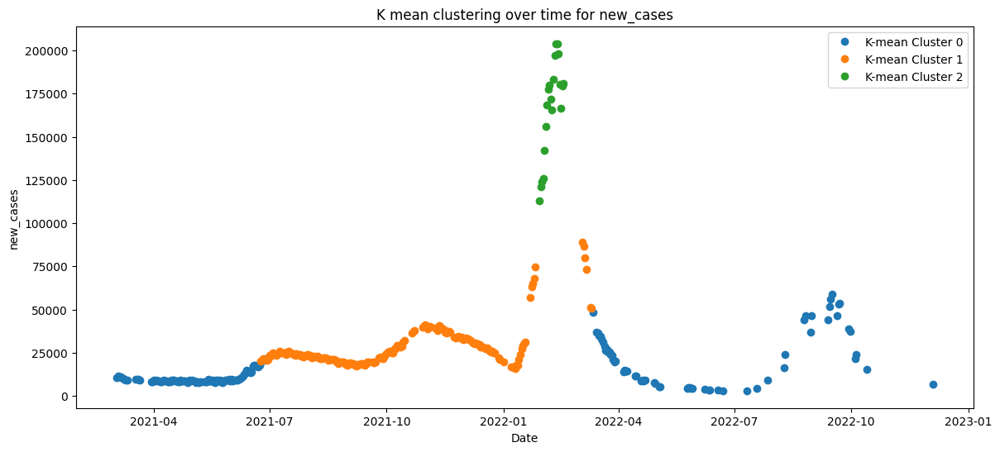

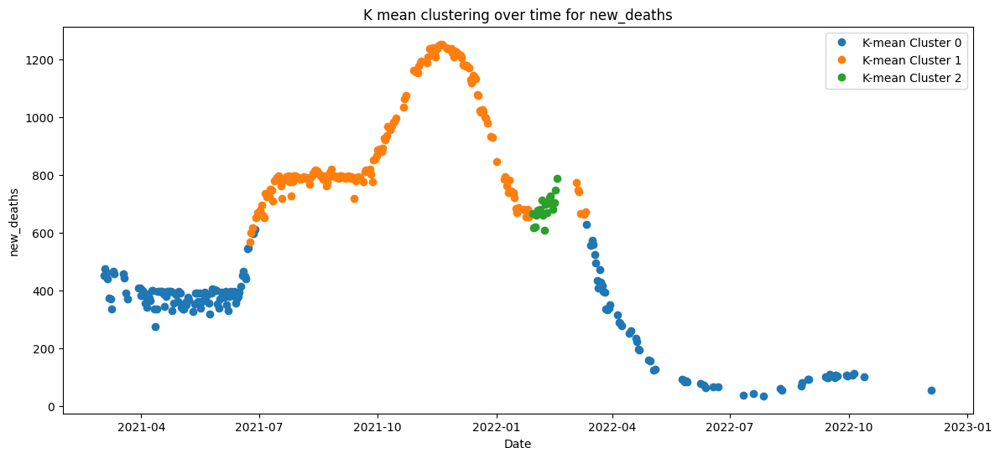

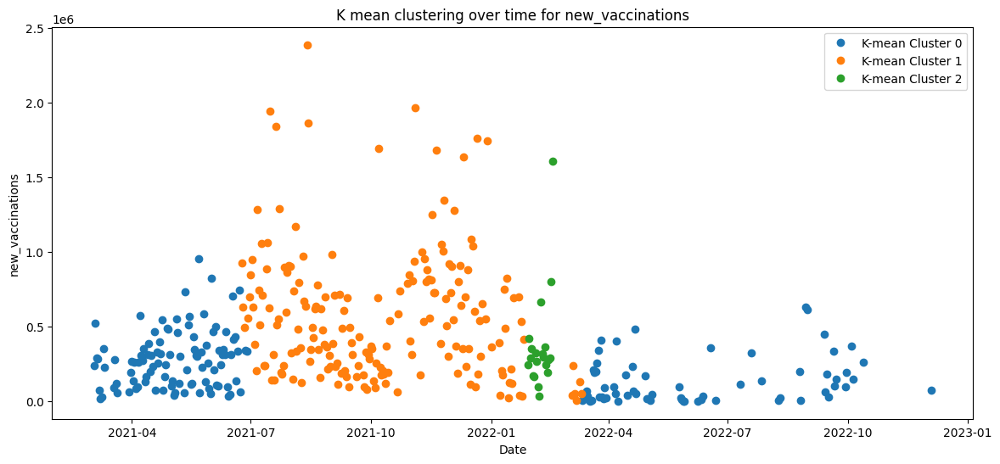

In [56]:
russia_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'Russia', 'K-mean',  filtered_forCountry_df)
summarize_clusters(russia_data_with_clusters)
plot_variables_over_time(russia_data_with_clusters)


Fuzzy Clustering for Russia
Number of Clusters: 3
Silhouette Score: 0.434
Davies-Bouldin Score: 1.143
Calinski-Harabasz Score: 260.998

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 146
For Fuzzy, Cluster 1 size: 155
For Fuzzy, Cluster 2 size: 71

Fuzzy Cluster sizes
                         new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                             
0                     45091.856164   768.219178     345662.938356
1                     14165.154839   311.516129     227017.109677
2                     33514.211268  1072.394366     944535.295775
Cluster 0 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 2 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-06-22 2022-03-17
1                    2021-03-03 2022-12-04
2                    2021-07-06 2022-02-17

Fuzzy people fully vac

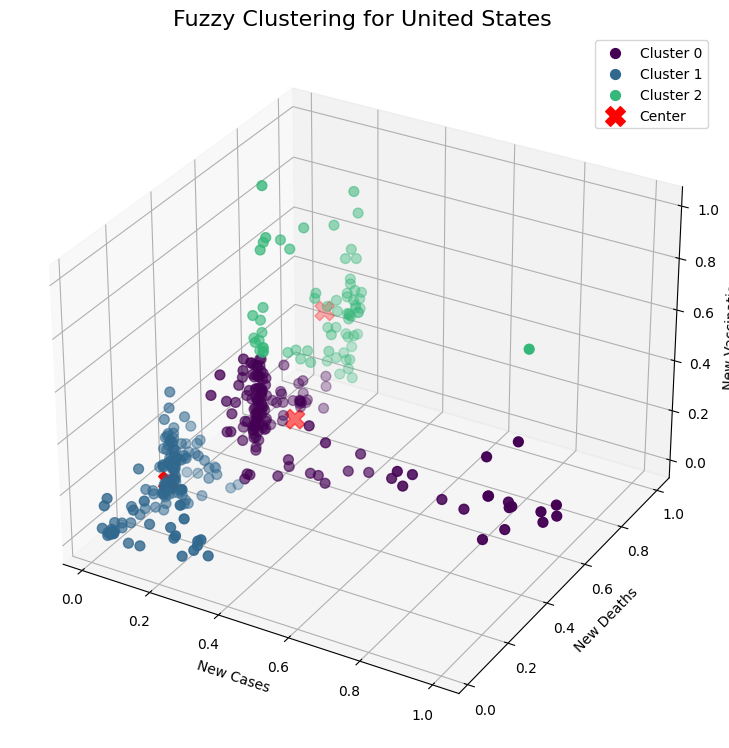

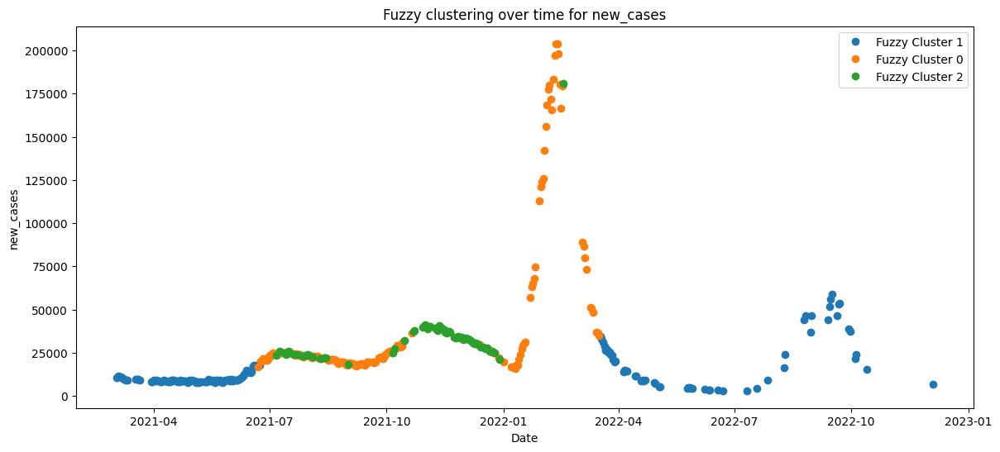

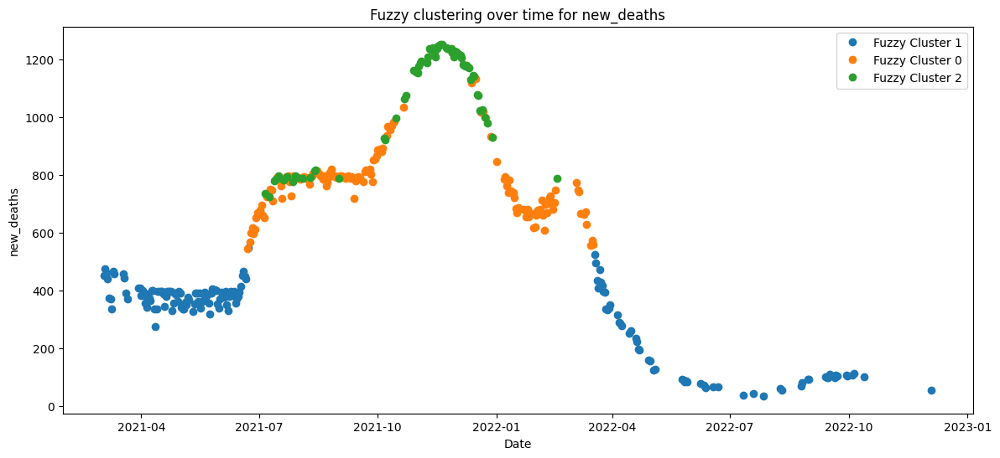

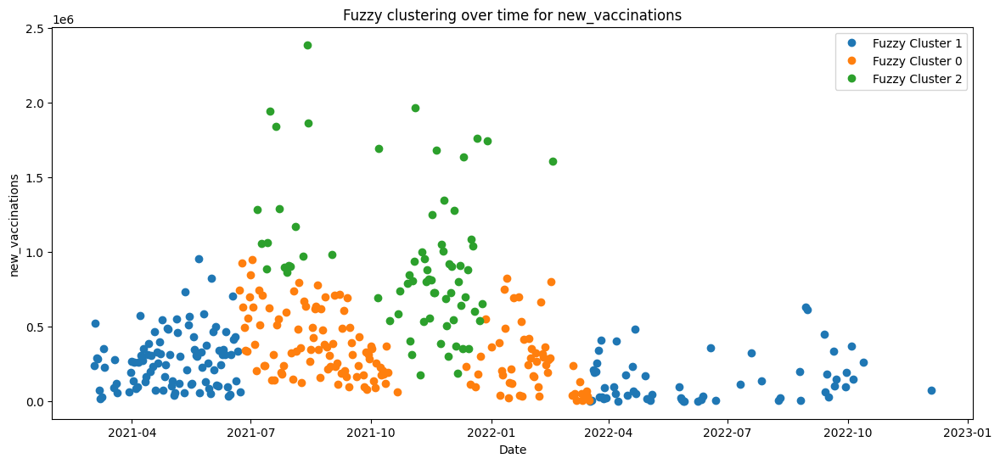

In [57]:
russia_data_with_clusters = create_clusters_and_plot(data_columns_of_interest, 'Russia', 'Fuzzy',  filtered_forCountry_df)
summarize_clusters(russia_data_with_clusters)
plot_variables_over_time(russia_data_with_clusters)


K-mean Clustering for United States
Number of Clusters: 3
Silhouette Score: 0.556
Davies-Bouldin Score: 0.768
Calinski-Harabasz Score: 886.394

Size of this K-mean
For K-mean, Cluster 0 size: 131
For K-mean, Cluster 1 size: 549
For K-mean, Cluster 2 size: 196

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                       69140.480916   947.893130      2.421070e+06
1                       51799.819672   363.071038      3.981894e+05
2                      253952.551020  2542.984694      7.178852e+05
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-01-27 2021-12-28
1                     2021-03-14 2023-05-09
2                     2020-12-14 2023

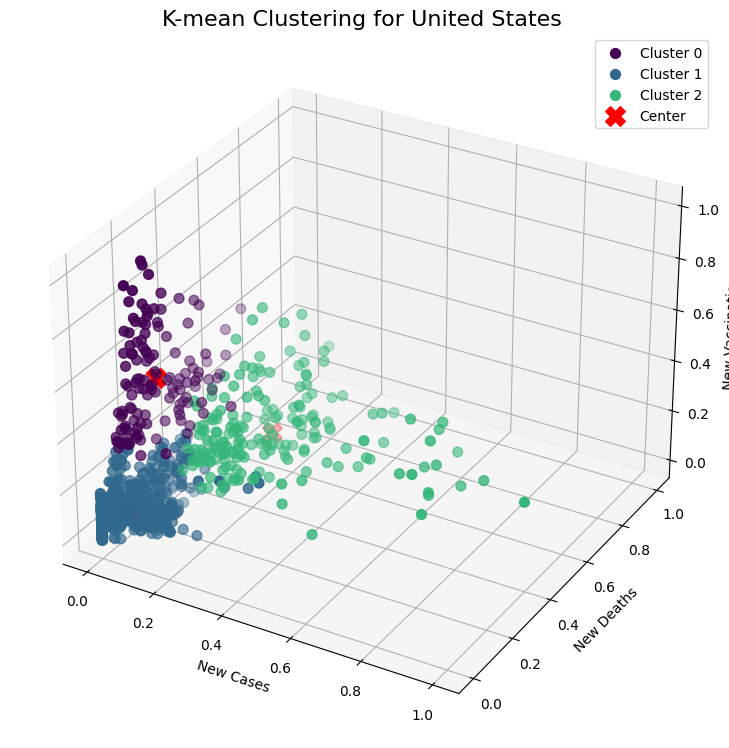

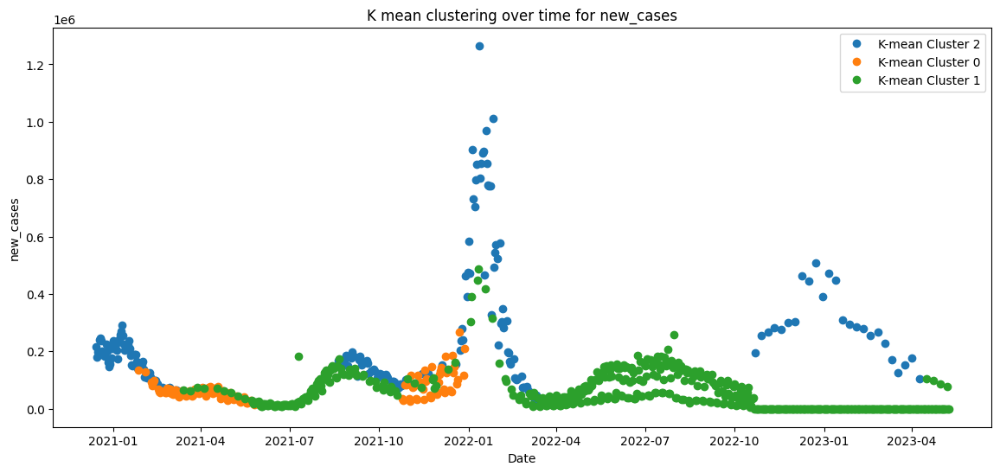

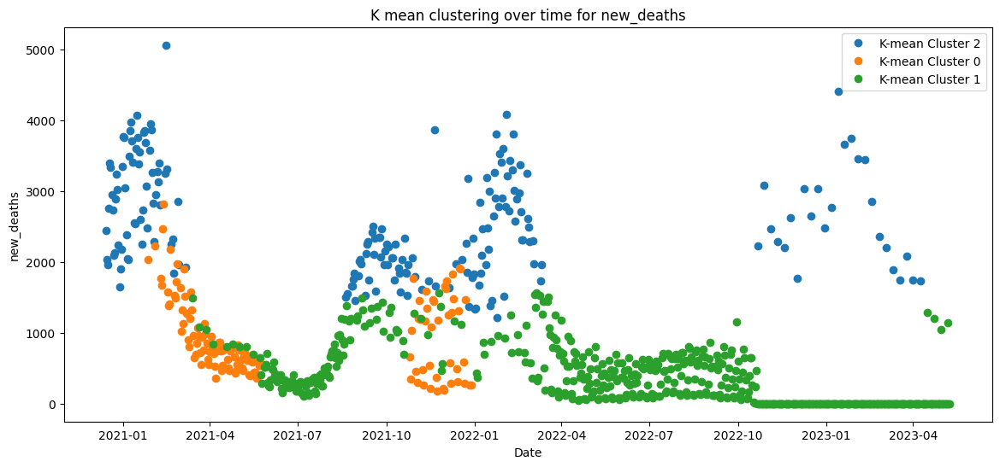

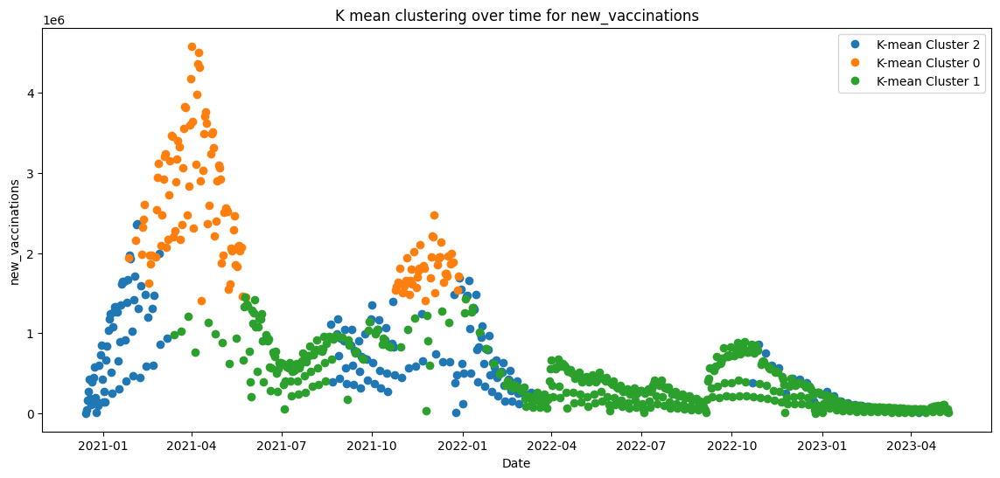


Fuzzy Clustering for United States
Number of Clusters: 3
Silhouette Score: 0.556
Davies-Bouldin Score: 0.770
Calinski-Harabasz Score: 886.324

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 548
For Fuzzy, Cluster 1 size: 132
For Fuzzy, Cluster 2 size: 196

Fuzzy Cluster sizes
                          new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                              
0                      51643.558394   361.613139      3.965971e+05
1                      69657.833333   949.515152      2.412356e+06
2                     253952.551020  2542.984694      7.178852e+05
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 1 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-03-14 2023-05-09
1                    2021-01-27 2021-12-28
2                    2020-12-14 2023-04-09

Fuzzy peo

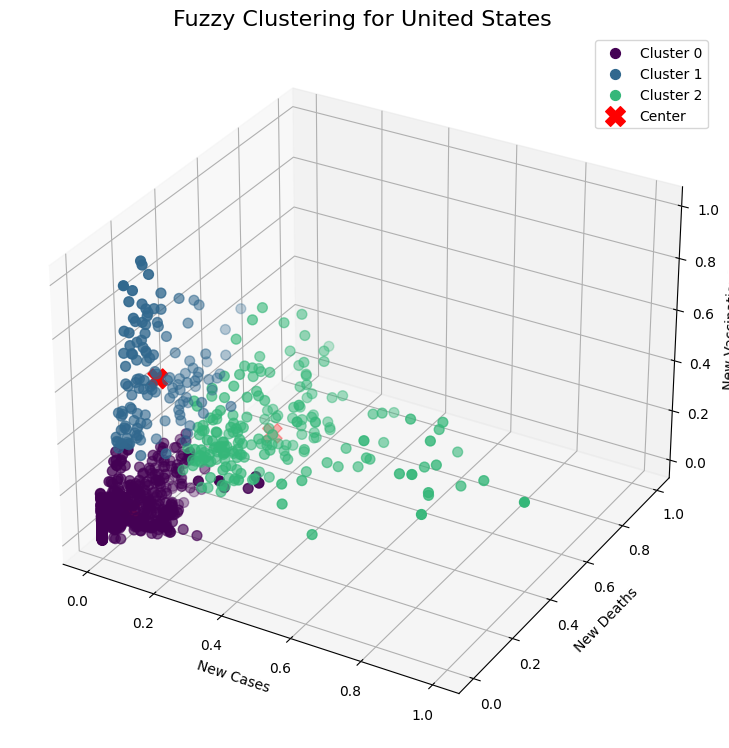

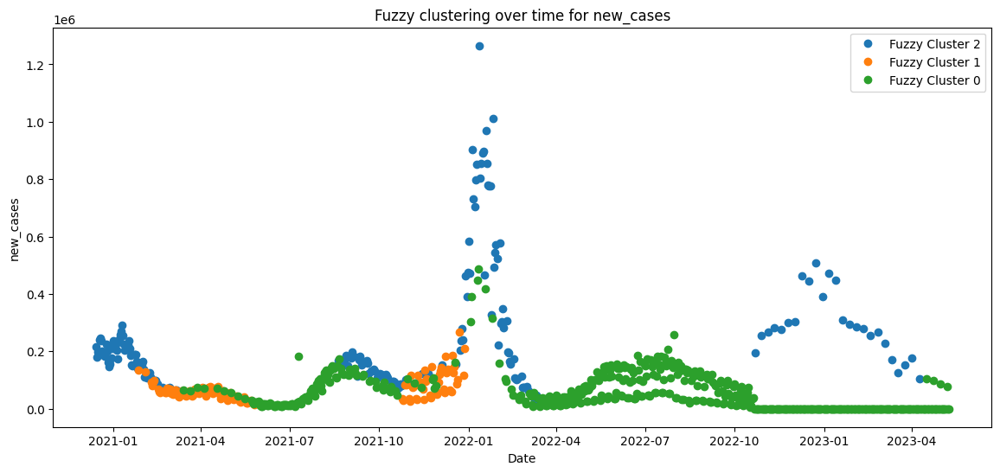

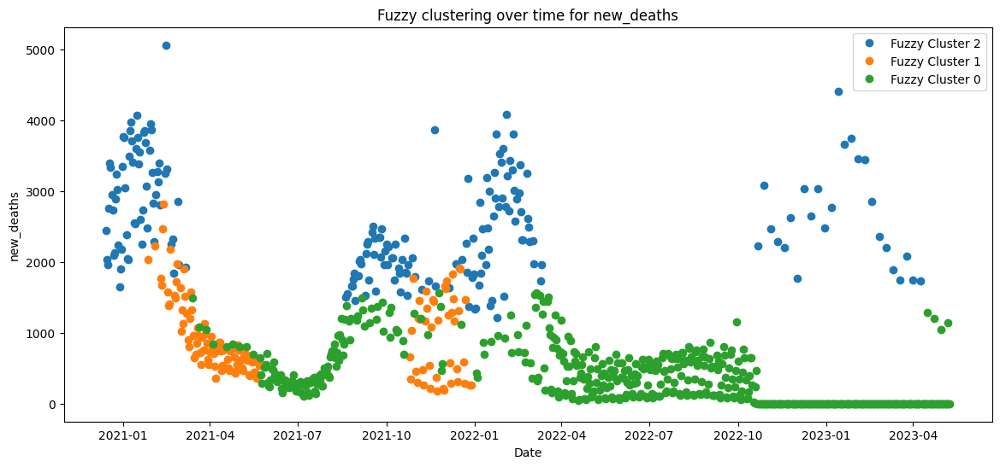

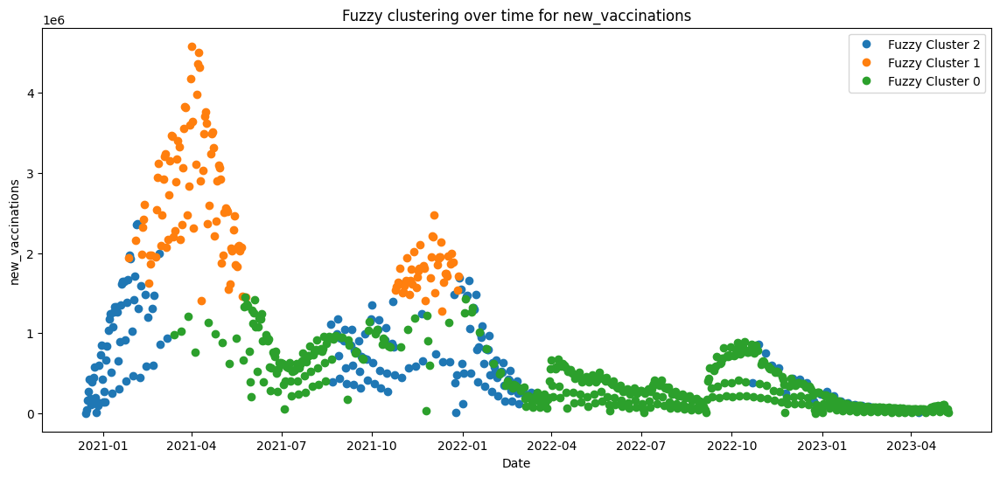


K-mean Clustering for India
Number of Clusters: 2
Silhouette Score: 0.726
Davies-Bouldin Score: 0.744
Calinski-Harabasz Score: 939.717

Size of this K-mean
For K-mean, Cluster 0 size: 899
For K-mean, Cluster 1 size: 90

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                       11733.720801   153.529477      1.974439e+06
1                      235178.200000  2392.188889      3.743277e+06
Cluster 1 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 1 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-01-16 2023-11-21
1                     2021-04-10 2022-03-26

K-mean people fully vaccinated:
                              min          max
K-mean_cluster_labels                         
0                  

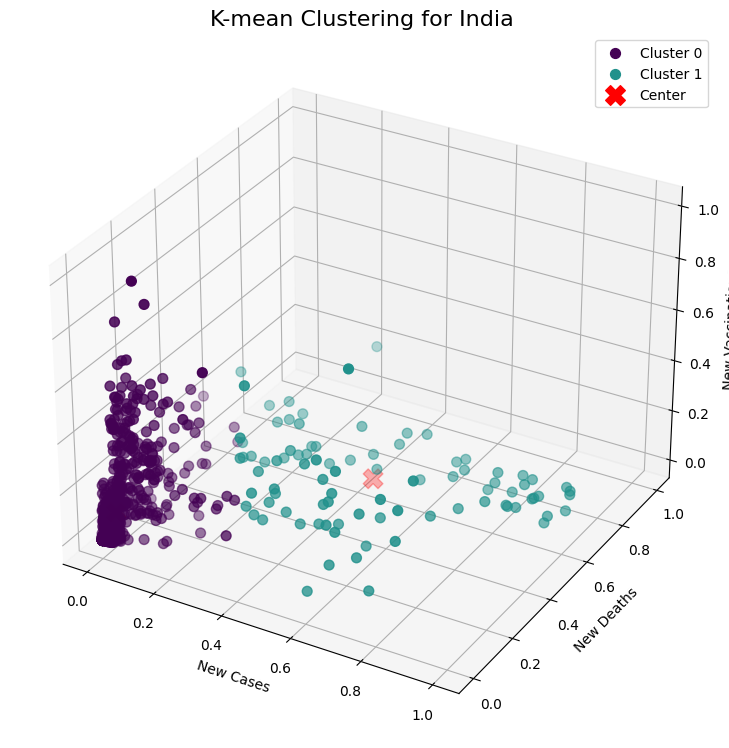

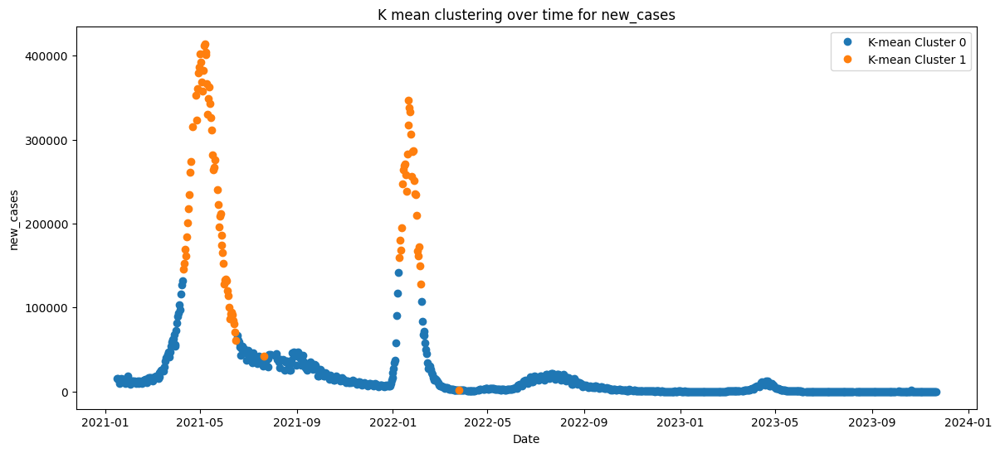

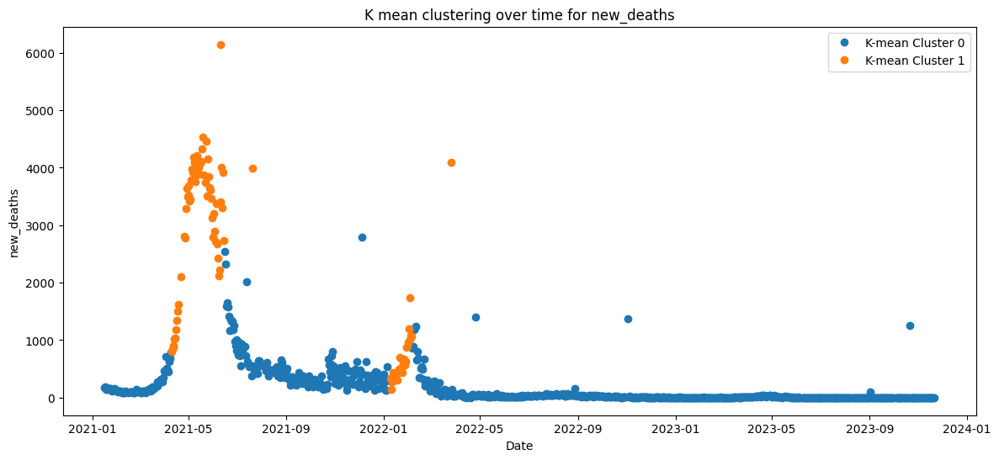

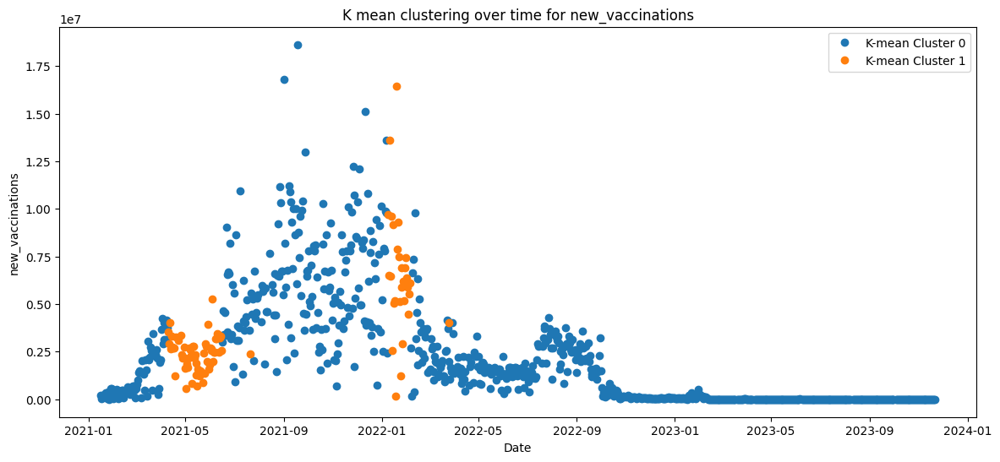


Fuzzy Clustering for India
Number of Clusters: 2
Silhouette Score: 0.726
Davies-Bouldin Score: 0.744
Calinski-Harabasz Score: 939.717

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 90
For Fuzzy, Cluster 1 size: 899

Fuzzy Cluster sizes
                          new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                              
0                     235178.200000  2392.188889      3.743277e+06
1                      11733.720801   153.529477      1.974439e+06
Cluster 0 has the highest average new cases.
Cluster 0 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-04-10 2022-03-26
1                    2021-01-16 2023-11-21

Fuzzy people fully vaccinated:
                             min          max
Fuzzy_cluster_labels                         
0                     12709186.0  82

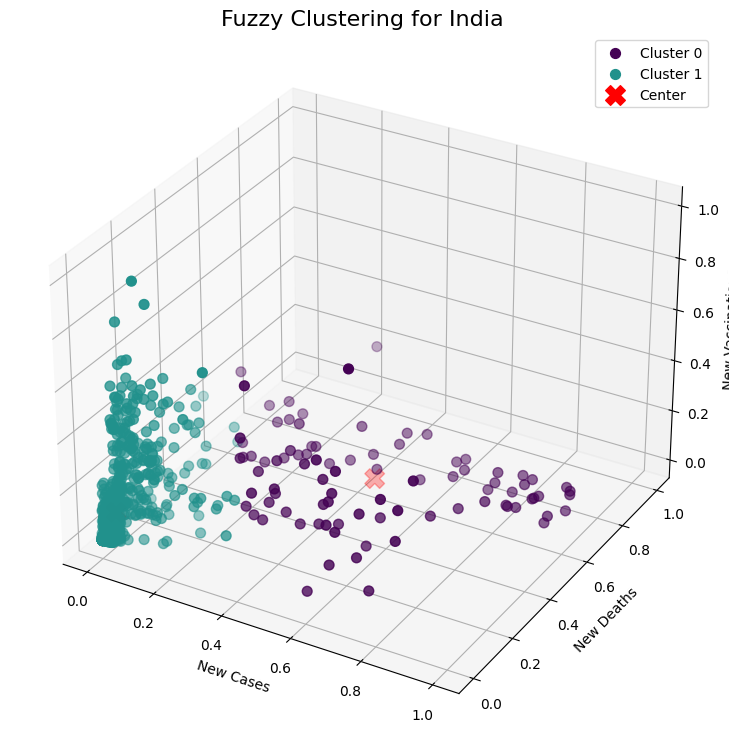

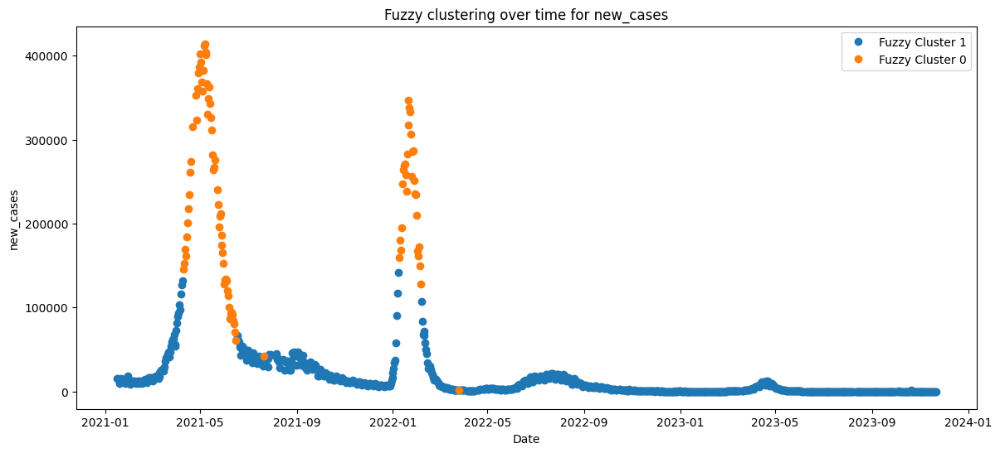

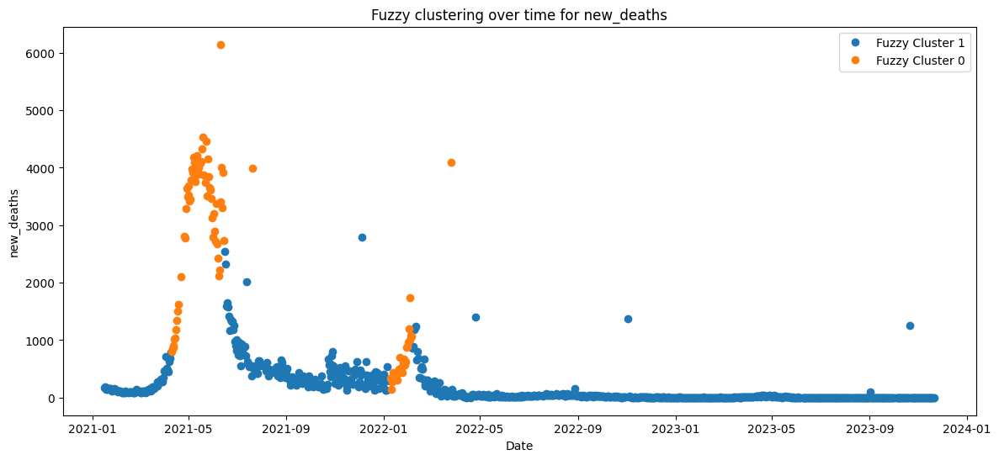

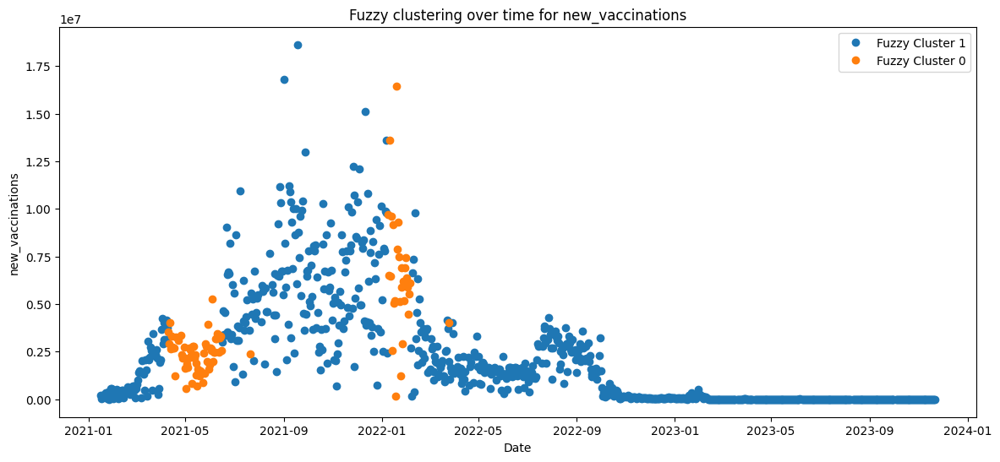


K-mean Clustering for China
Number of Clusters: 3
Silhouette Score: 0.670
Davies-Bouldin Score: 0.626
Calinski-Harabasz Score: 923.334

Size of this K-mean
For K-mean, Cluster 0 size: 163
For K-mean, Cluster 1 size: 481
For K-mean, Cluster 2 size: 18

K-mean Cluster sizes
                          new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                             
0                      1.504969e+02     5.092025      1.374569e+07
1                      5.086447e+04    56.449064      2.377333e+06
2                      4.027113e+06  2058.222222      1.308389e+06
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-04-29 2022-01-05
1                     2021-03-23 2023-01-13
2                     2022-12-18 2023-01-04

K-mean

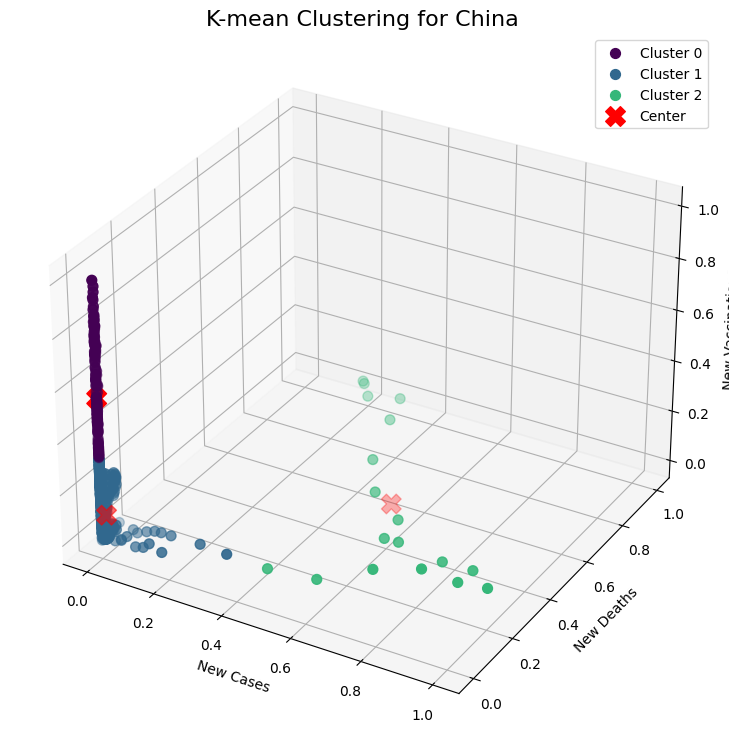

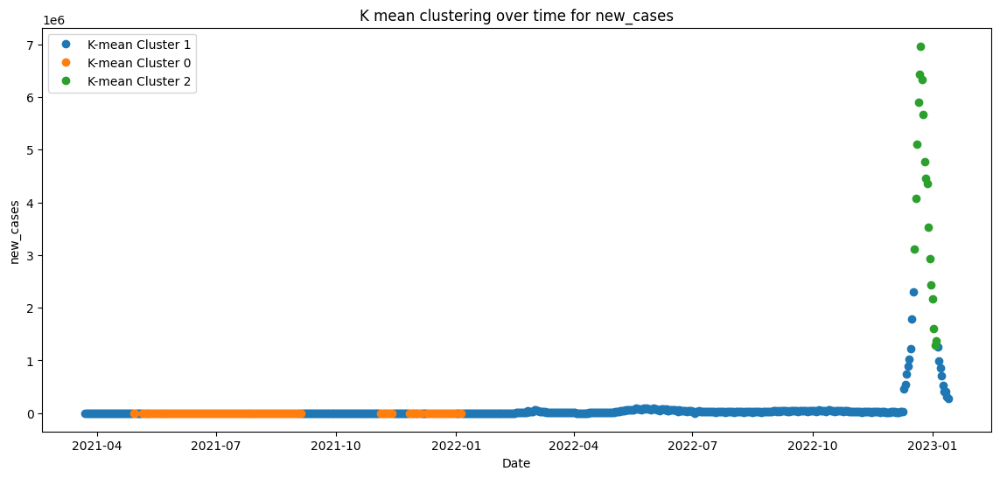

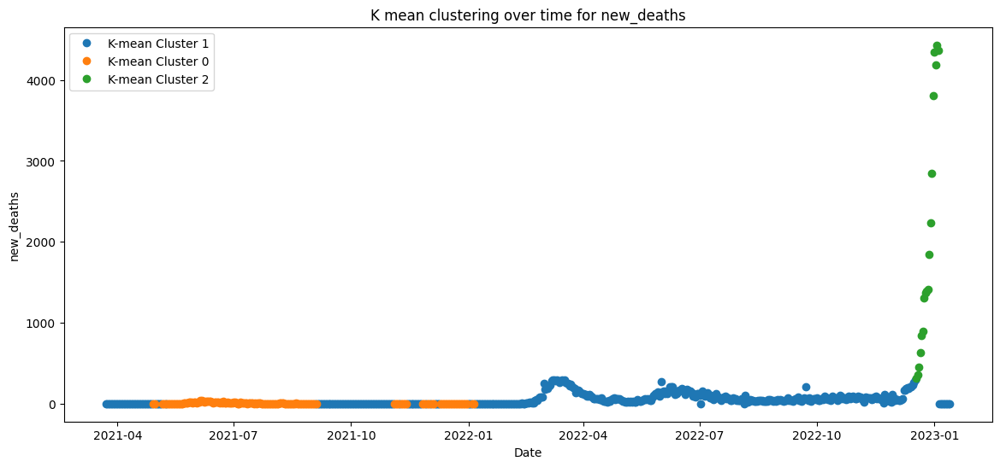

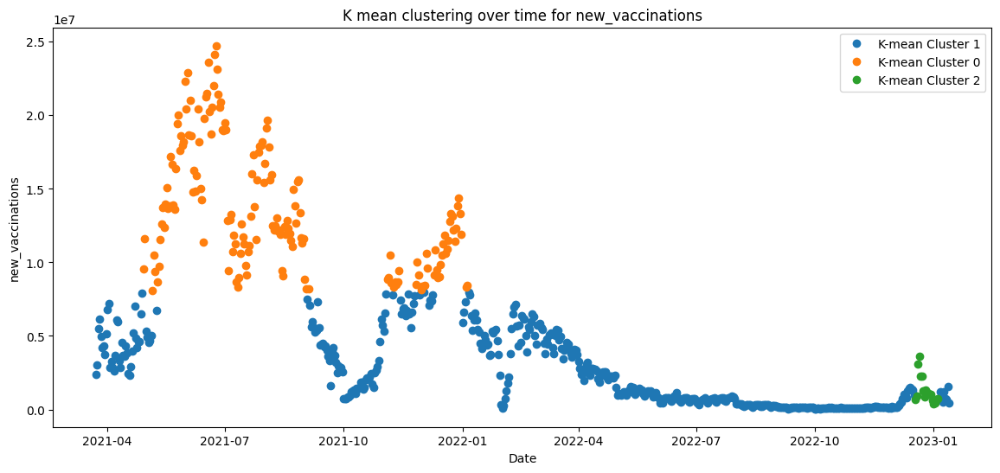


Fuzzy Clustering for China
Number of Clusters: 3
Silhouette Score: 0.531
Davies-Bouldin Score: 0.682
Calinski-Harabasz Score: 610.742

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 202
For Fuzzy, Cluster 1 size: 116
For Fuzzy, Cluster 2 size: 344

Fuzzy Cluster sizes
                          new_cases  new_deaths  new_vaccinations
Fuzzy_cluster_labels                                             
0                       3831.262376   36.737624      6.303600e+06
1                        181.905172    6.801724      1.556632e+07
2                     279602.811047  165.174419      9.551590e+05
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 1 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-03-25 2022-03-31
1                    2021-04-30 2021-12-31
2                    2021-03-23 2023-01-13

Fuzzy people fully vac

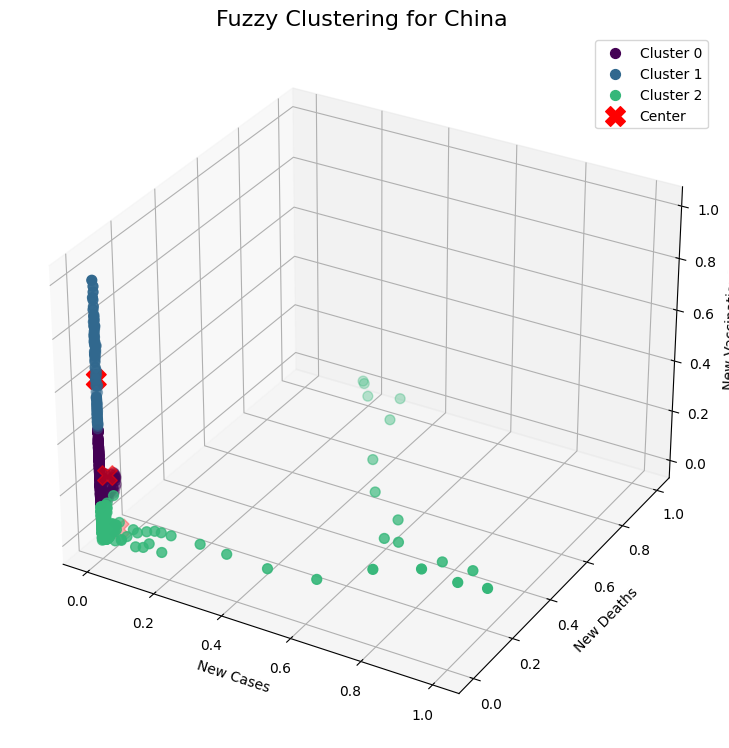

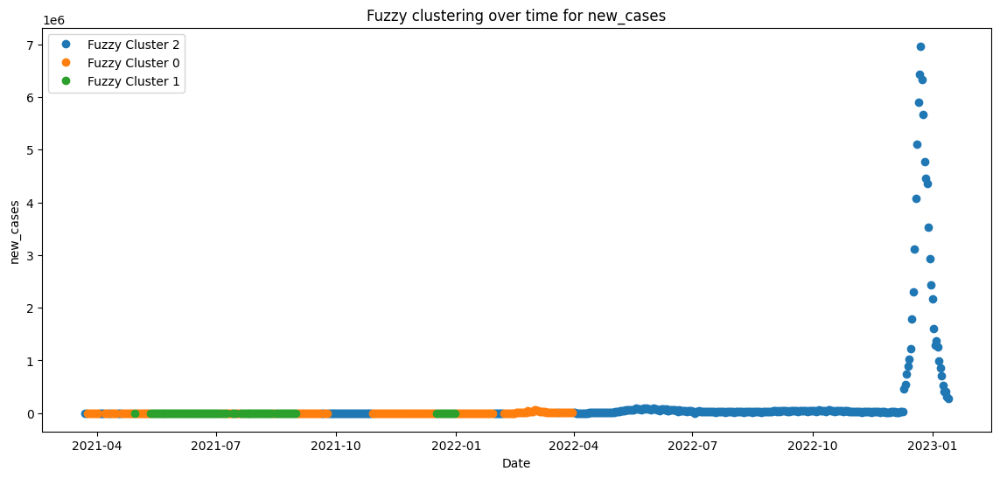

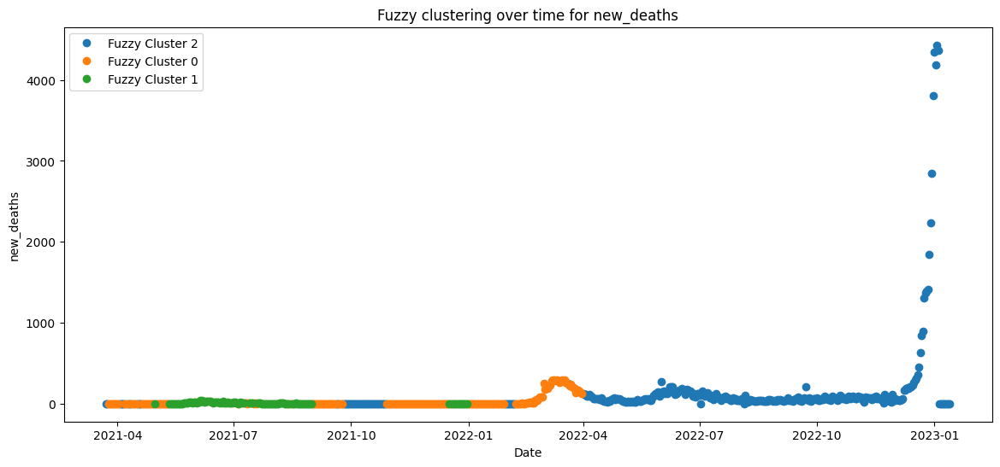

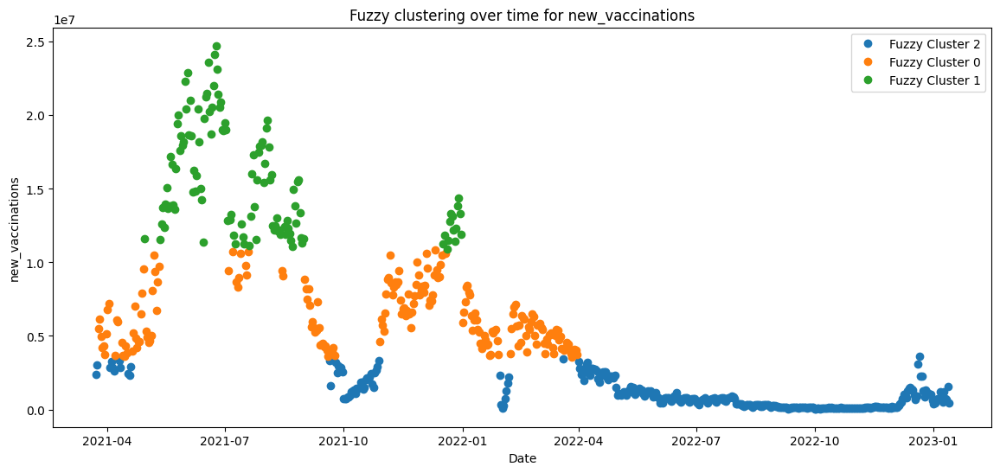


K-mean Clustering for Brazil
Number of Clusters: 4
Silhouette Score: 0.474
Davies-Bouldin Score: 0.791
Calinski-Harabasz Score: 521.130

Size of this K-mean
For K-mean, Cluster 0 size: 314
For K-mean, Cluster 1 size: 127
For K-mean, Cluster 2 size: 161
For K-mean, Cluster 3 size: 33

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                       21870.894904   227.136943      2.934609e+05
1                       70559.763780  2219.511811      6.341378e+05
2                       26514.285714   570.832298      1.548802e+06
3                      165202.272727   795.242424      1.113834e+06
Cluster 3 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 2 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-01-18 

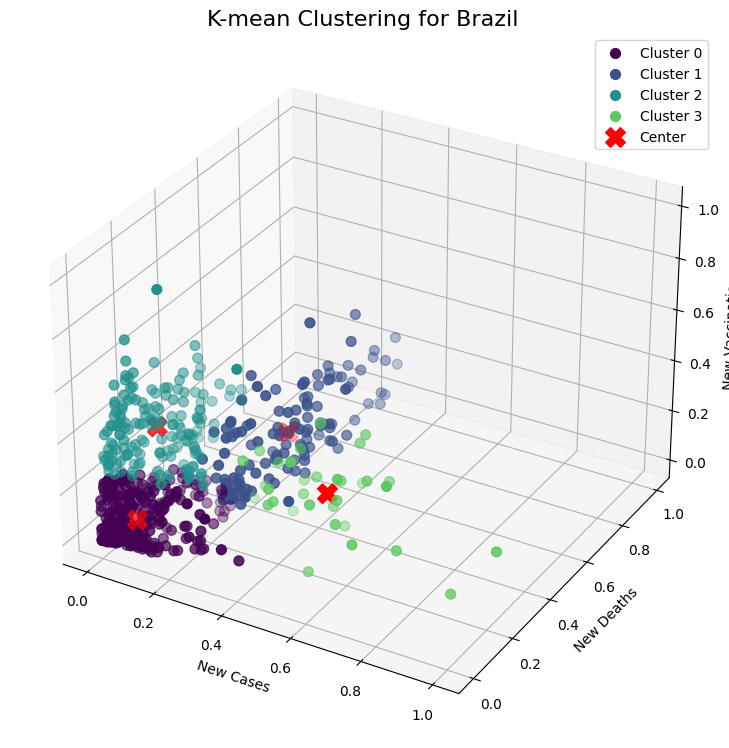

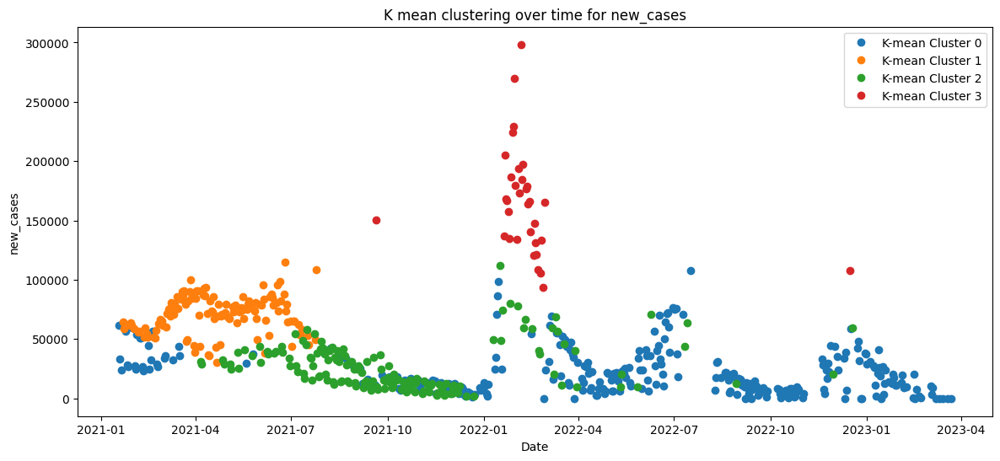

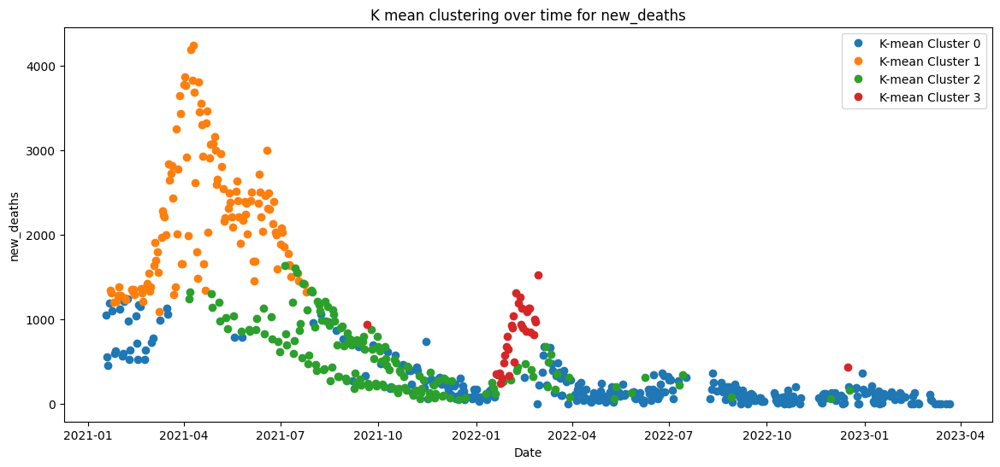

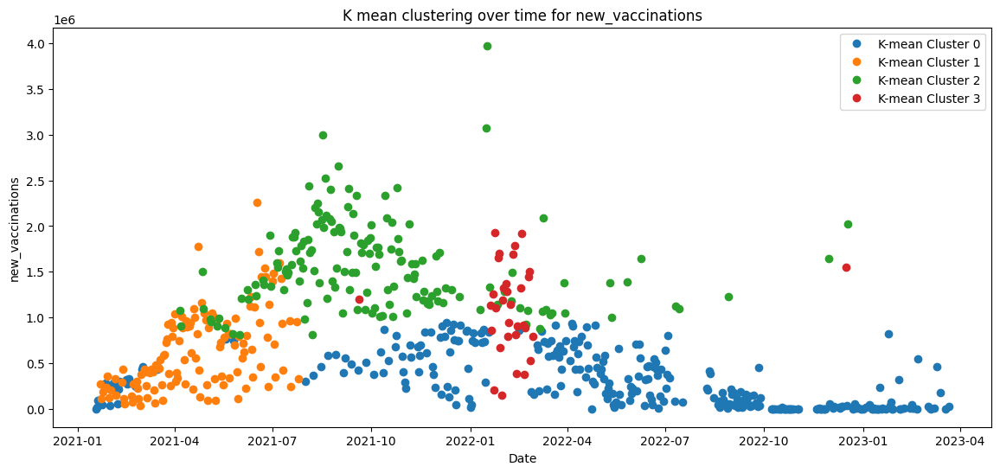


Fuzzy Clustering for Brazil
Number of Clusters: 4
Silhouette Score: 0.454
Davies-Bouldin Score: 1.041
Calinski-Harabasz Score: 502.837

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 113
For Fuzzy, Cluster 1 size: 80
For Fuzzy, Cluster 2 size: 152
For Fuzzy, Cluster 3 size: 290

Fuzzy Cluster sizes
                         new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                             
0                     87327.778761  1116.955752      6.656213e+05
1                     77848.837500  2668.000000      7.269215e+05
2                     26054.894737   535.381579      1.588320e+06
3                     18940.468966   173.489655      2.896629e+05
Cluster 0 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 2 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-01-18 2022-07-17
1           

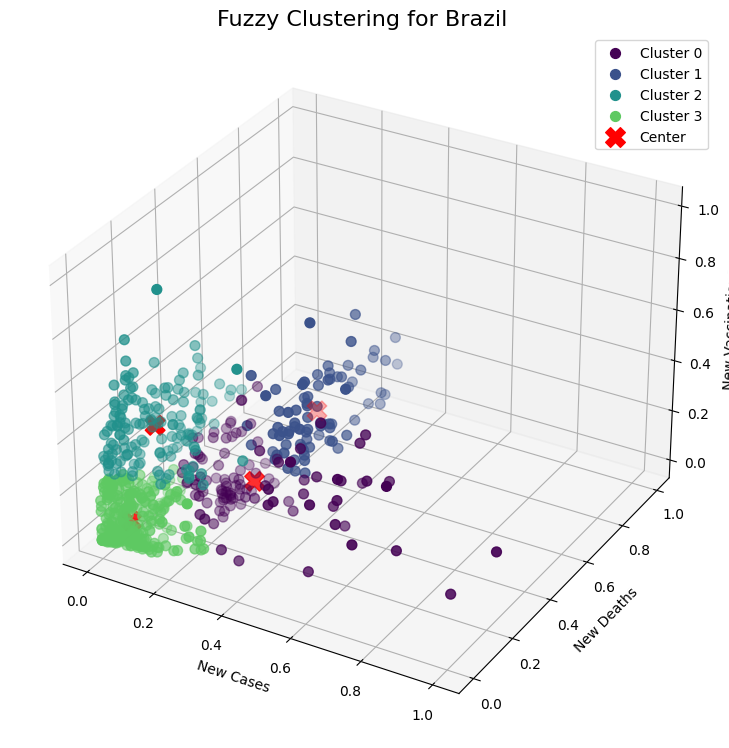

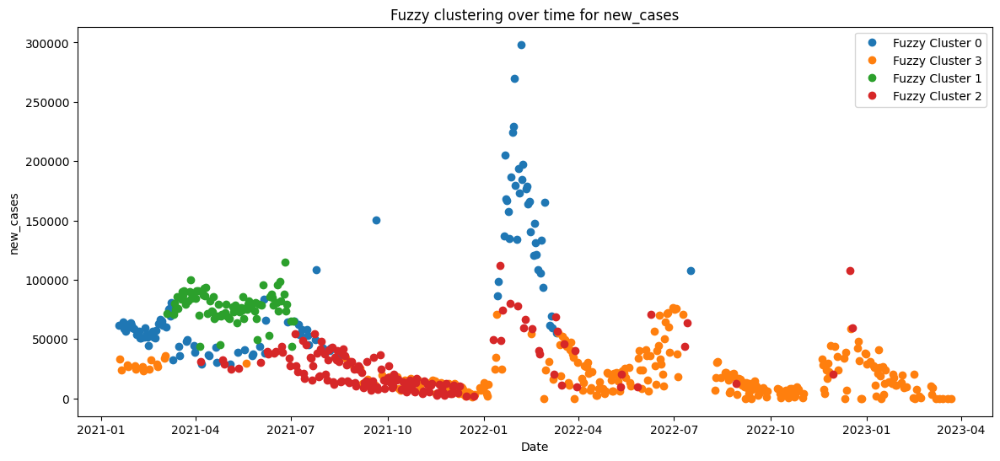

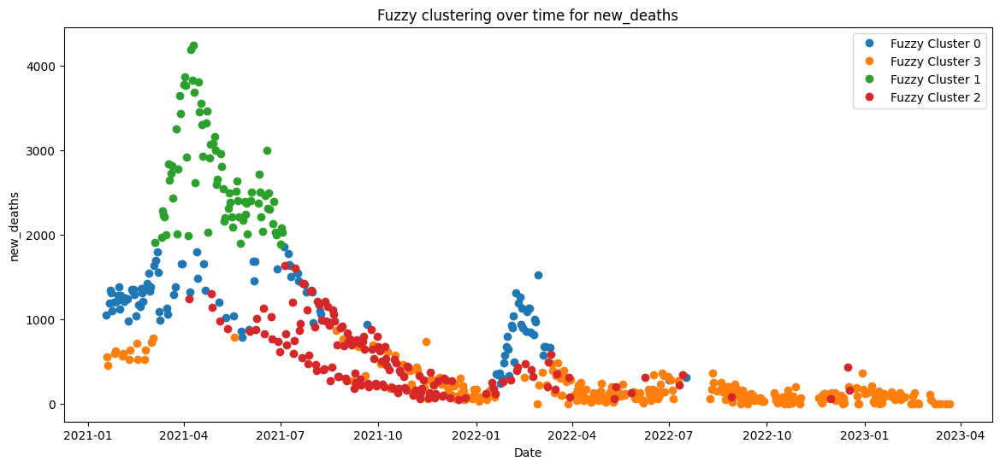

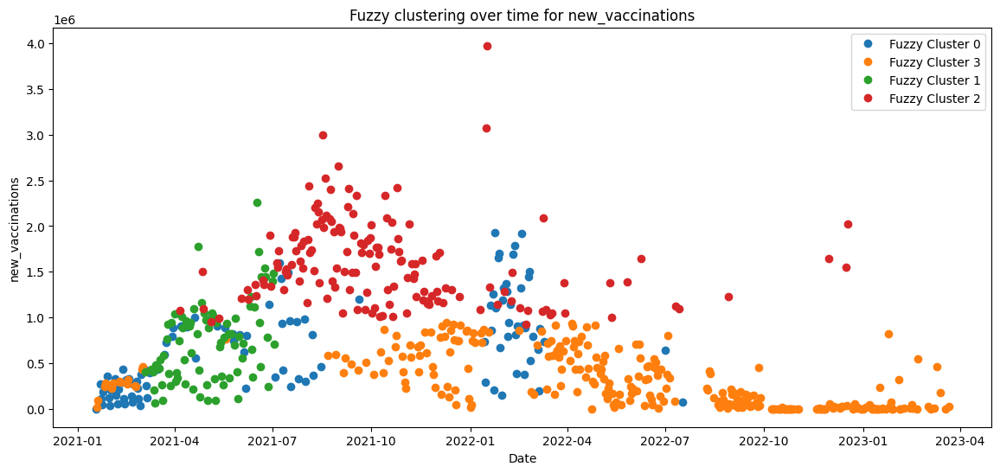


K-mean Clustering for France
Number of Clusters: 3
Silhouette Score: 0.725
Davies-Bouldin Score: 0.649
Calinski-Harabasz Score: 1528.656

Size of this K-mean
For K-mean, Cluster 0 size: 180
For K-mean, Cluster 1 size: 707
For K-mean, Cluster 2 size: 38

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                           0.000000     0.000000     582633.572222
1                       20696.294201    48.158416      67106.055163
2                      579656.631579  1852.710526      57227.000000
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-03-12 2022-01-28
1                     2020-12-28 2023-07-10
2                     2021-01-03 2022-04-24


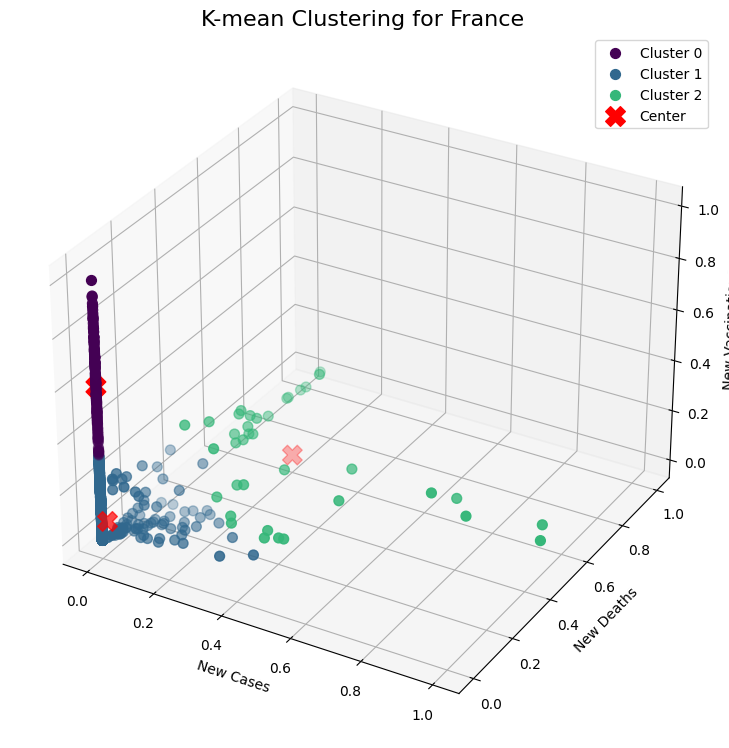

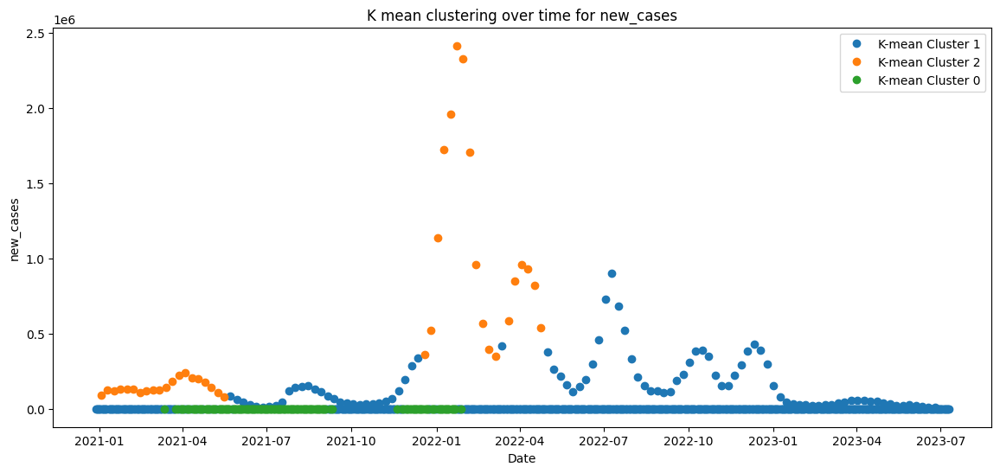

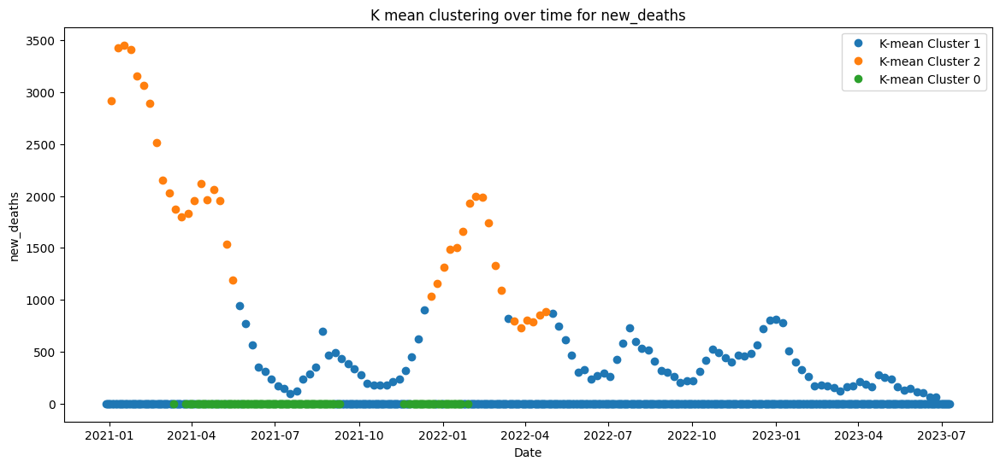

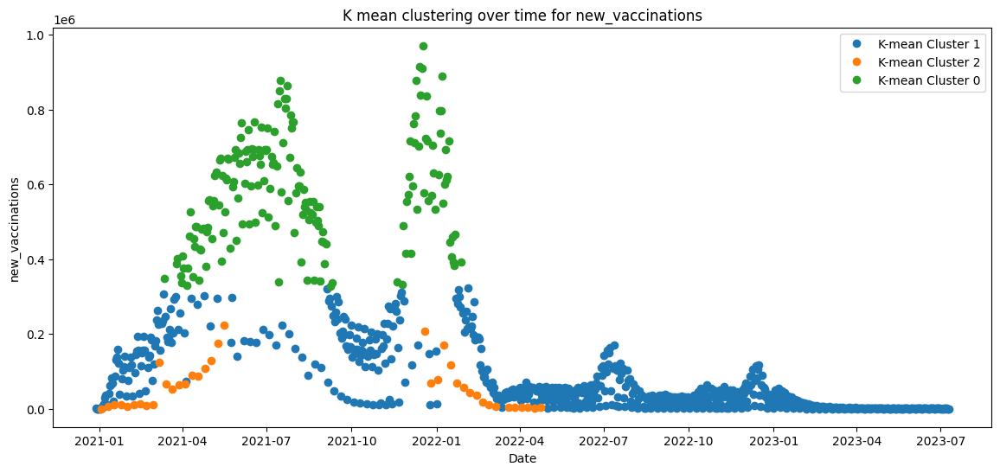


Fuzzy Clustering for France
Number of Clusters: 3
Silhouette Score: 0.725
Davies-Bouldin Score: 0.649
Calinski-Harabasz Score: 1528.656

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 180
For Fuzzy, Cluster 1 size: 707
For Fuzzy, Cluster 2 size: 38

Fuzzy Cluster sizes
                          new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                              
0                          0.000000     0.000000     582633.572222
1                      20696.294201    48.158416      67106.055163
2                     579656.631579  1852.710526      57227.000000
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-03-12 2022-01-28
1                    2020-12-28 2023-07-10
2                    2021-01-03 2022-04-24

Fuzzy people ful

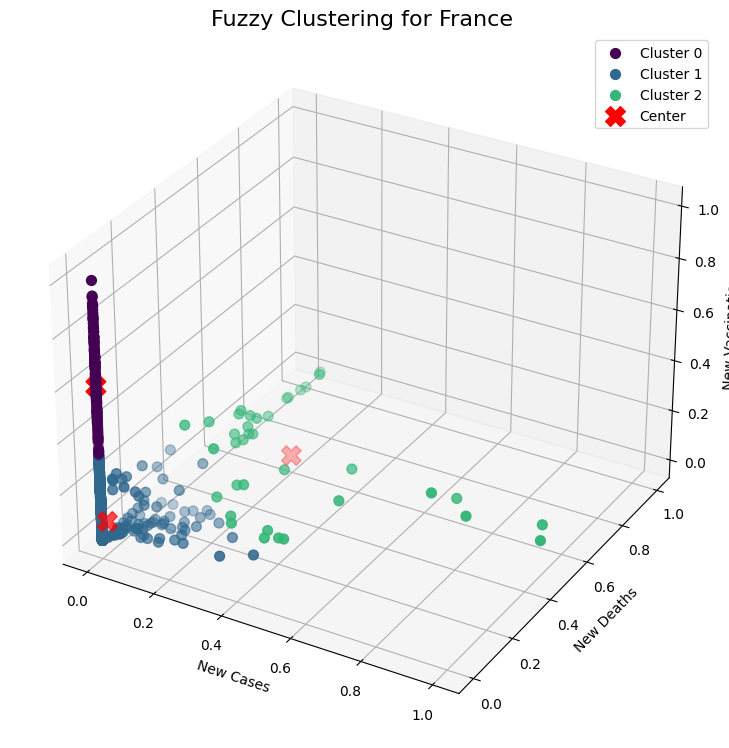

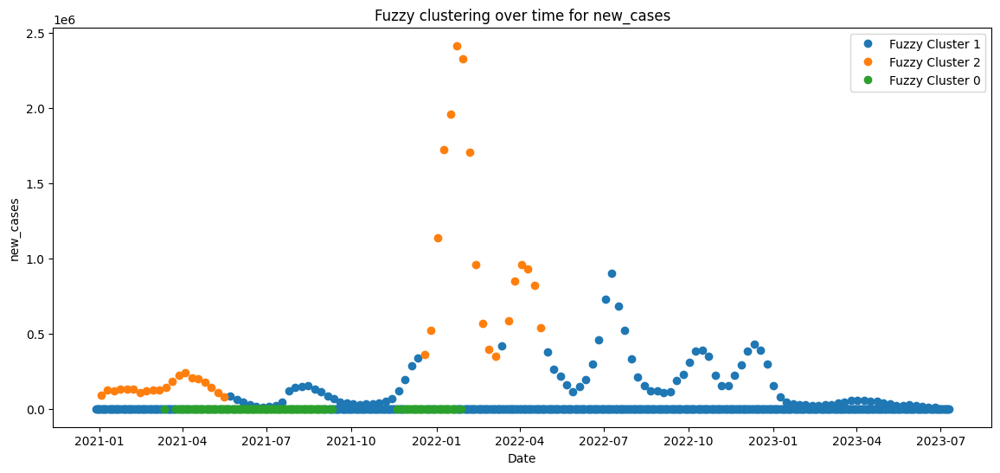

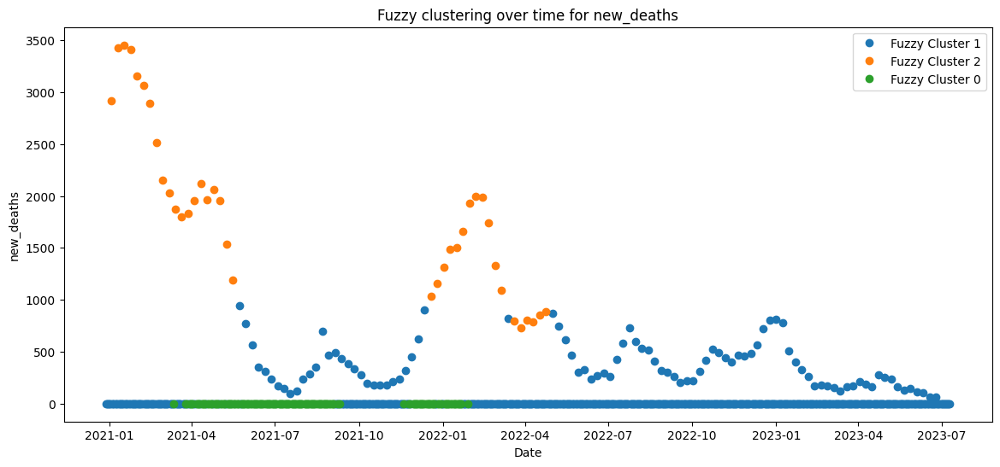

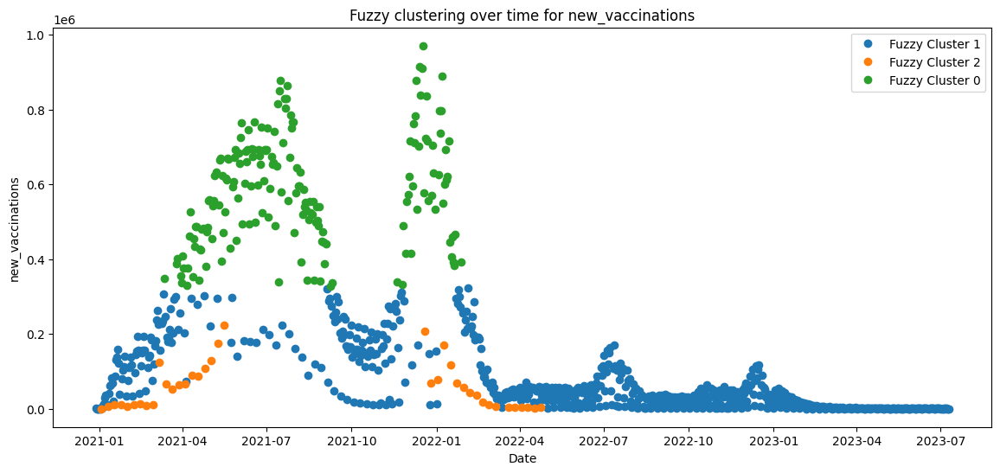


K-mean Clustering for Germany
Number of Clusters: 3
Silhouette Score: 0.702
Davies-Bouldin Score: 0.701
Calinski-Harabasz Score: 988.201

Size of this K-mean
For K-mean, Cluster 0 size: 128
For K-mean, Cluster 1 size: 664
For K-mean, Cluster 2 size: 39

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                           0.000000     0.000000     872701.664062
1                       15067.777108    80.635542     118068.731928
2                      684402.307692  1868.717949      53681.794872
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-04-07 2022-01-27
1                     2020-12-28 2023-04-07
2                     2021-01-03 2022-10-30


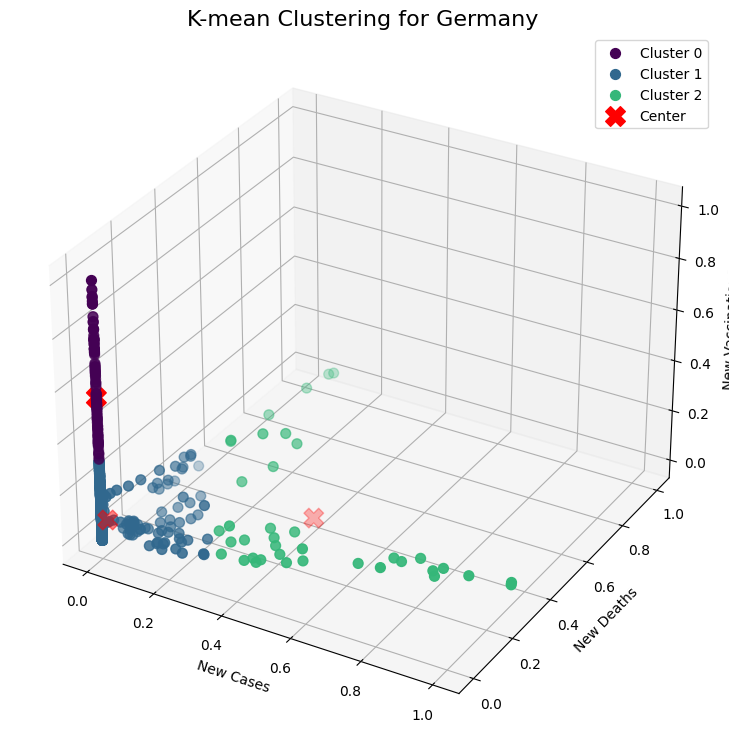

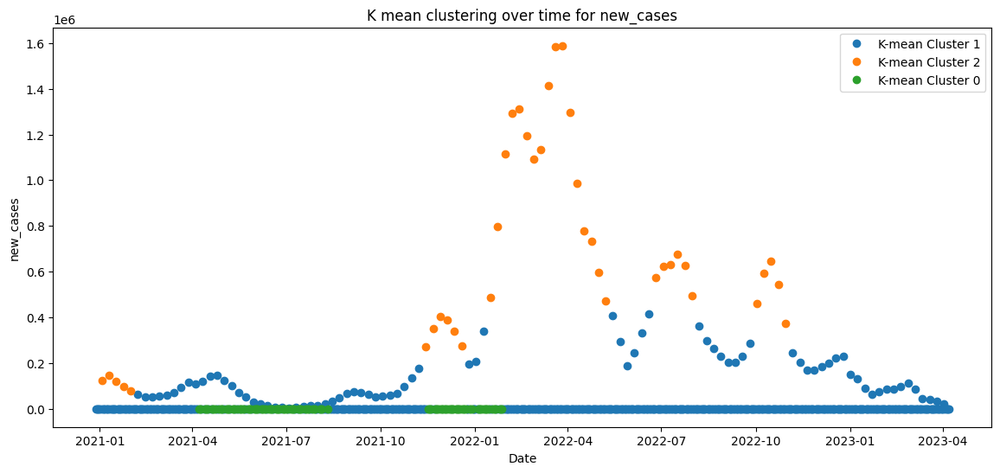

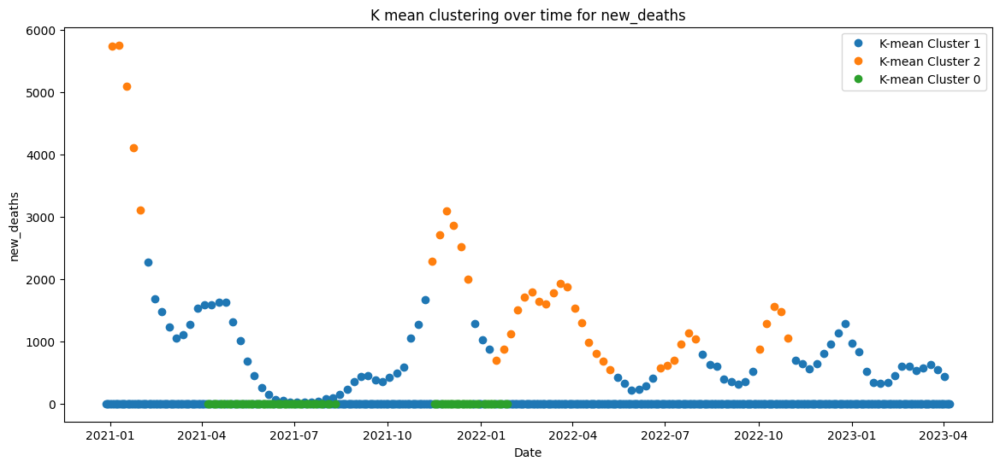

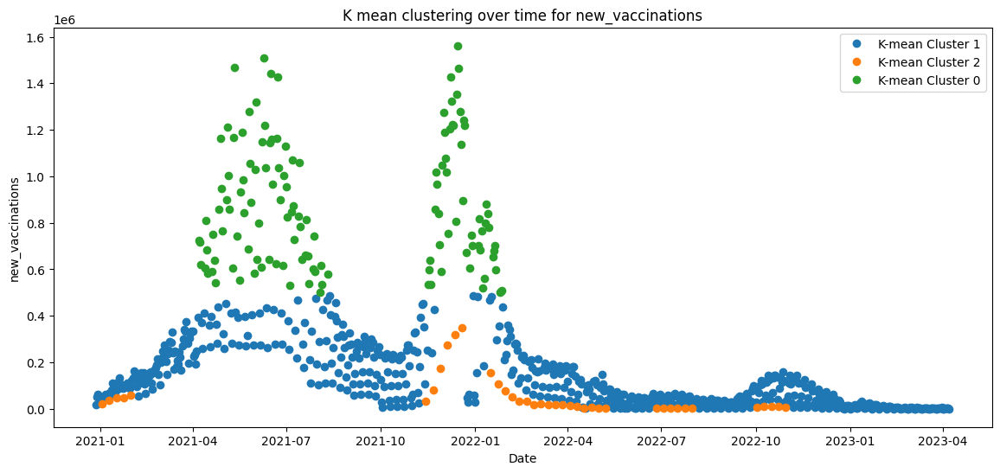


Fuzzy Clustering for Germany
Number of Clusters: 3
Silhouette Score: 0.702
Davies-Bouldin Score: 0.701
Calinski-Harabasz Score: 988.201

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 664
For Fuzzy, Cluster 1 size: 39
For Fuzzy, Cluster 2 size: 128

Fuzzy Cluster sizes
                          new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                              
0                      15067.777108    80.635542     118068.731928
1                     684402.307692  1868.717949      53681.794872
2                          0.000000     0.000000     872701.664062
Cluster 1 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 2 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2020-12-28 2023-04-07
1                    2021-01-03 2022-10-30
2                    2021-04-07 2022-01-27

Fuzzy people ful

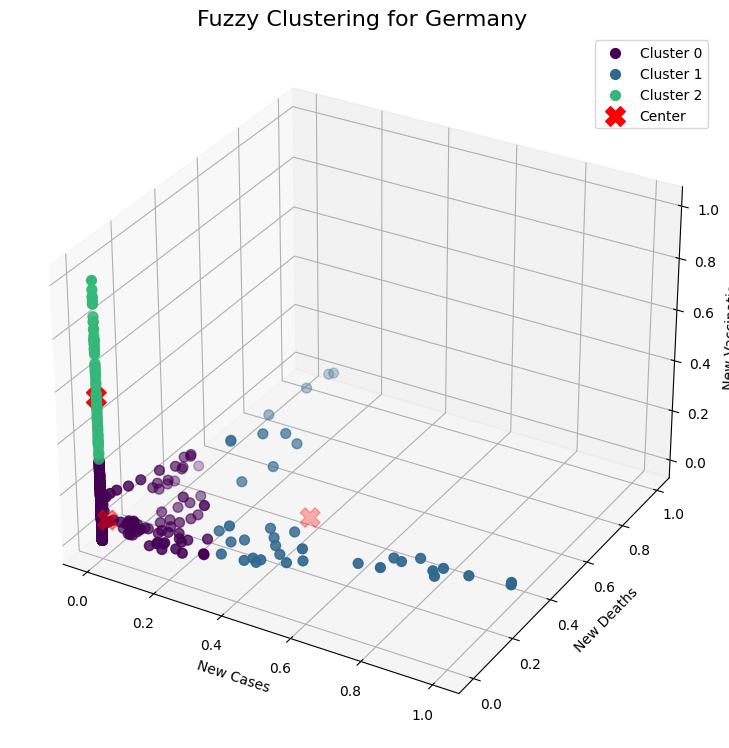

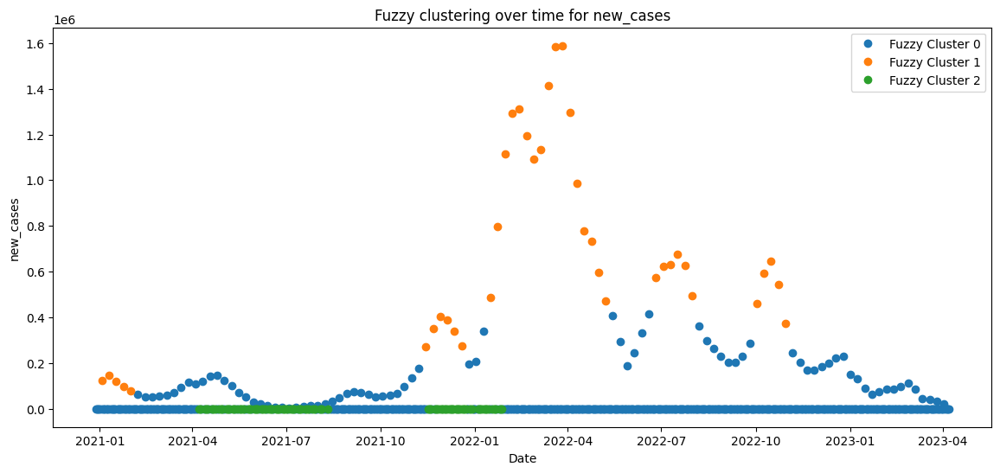

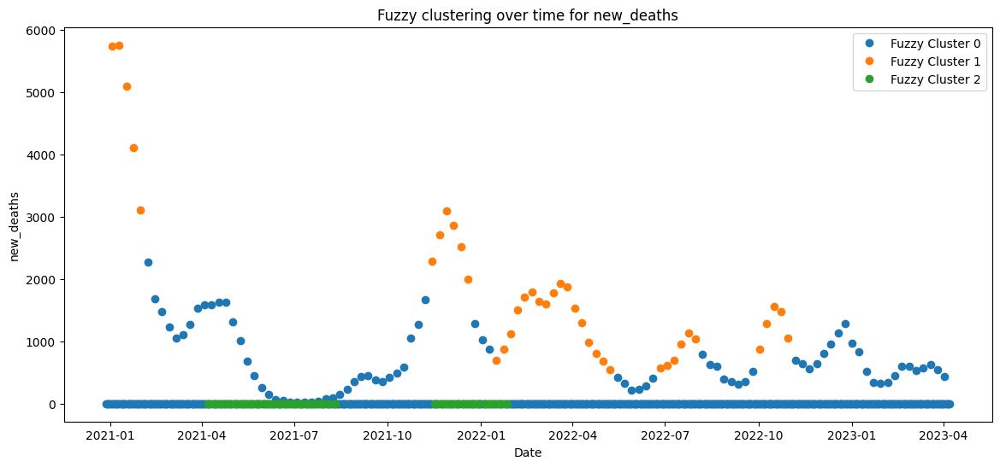

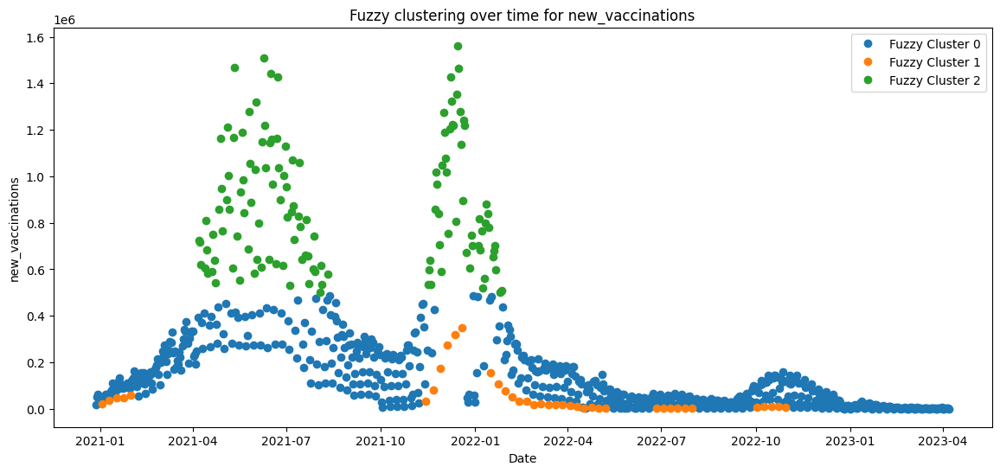


K-mean Clustering for United Kingdom
Number of Clusters: 4
Silhouette Score: 0.509
Davies-Bouldin Score: 0.692
Calinski-Harabasz Score: 522.694

Size of this K-mean
For K-mean, Cluster 0 size: 172
For K-mean, Cluster 1 size: 339
For K-mean, Cluster 2 size: 38
For K-mean, Cluster 3 size: 51

K-mean Cluster sizes
                           new_cases   new_deaths  new_vaccinations
K-mean_cluster_labels                                              
0                       23175.802326   101.651163     510769.250000
1                       25919.457227   107.861357     113586.091445
2                       26146.789474  1068.578947     376811.447368
3                      125880.274510   192.196078     150306.313725
Cluster 3 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021

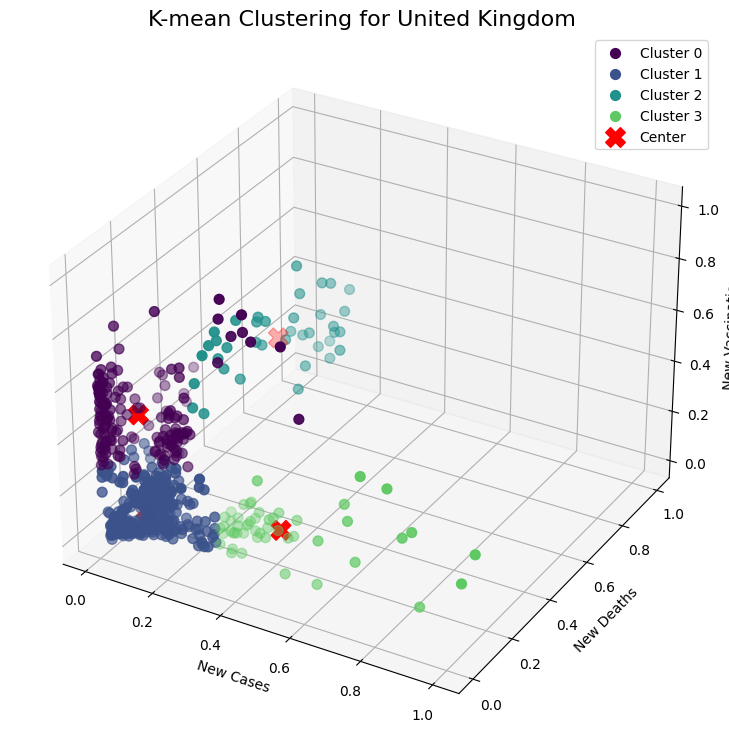

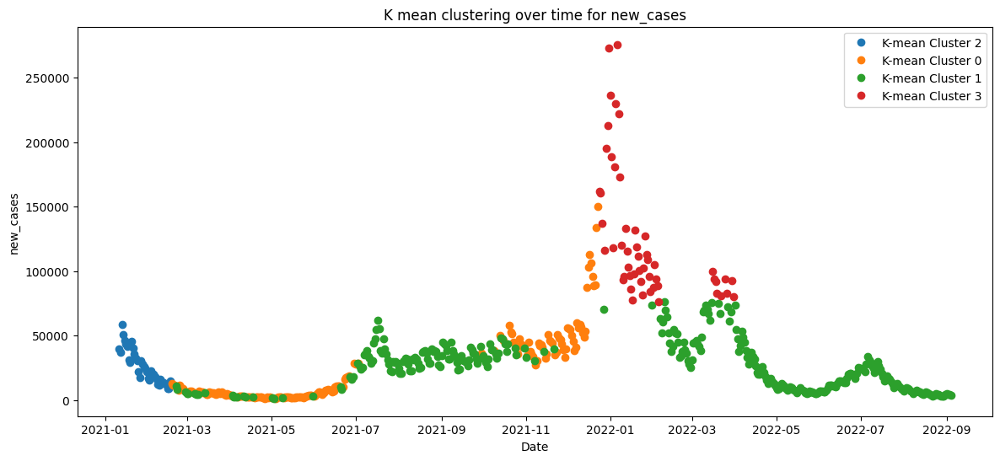

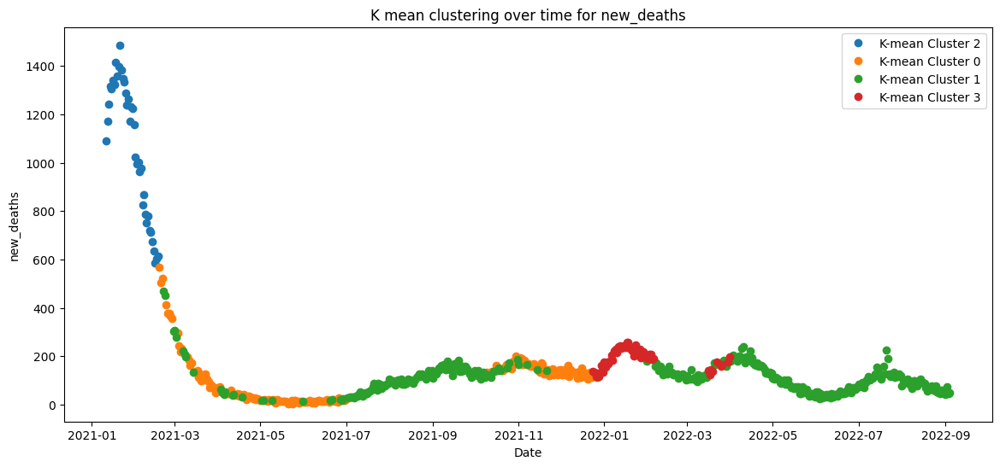

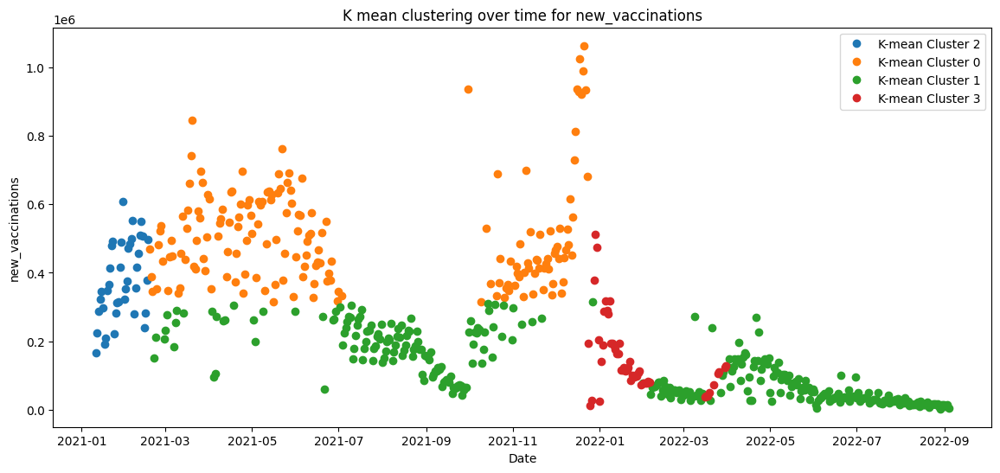


Fuzzy Clustering for United Kingdom
Number of Clusters: 4
Silhouette Score: 0.509
Davies-Bouldin Score: 0.692
Calinski-Harabasz Score: 522.694

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 172
For Fuzzy, Cluster 1 size: 51
For Fuzzy, Cluster 2 size: 339
For Fuzzy, Cluster 3 size: 38

Fuzzy Cluster sizes
                          new_cases   new_deaths  new_vaccinations
Fuzzy_cluster_labels                                              
0                      23175.802326   101.651163     510769.250000
1                     125880.274510   192.196078     150306.313725
2                      25919.457227   107.861357     113586.091445
3                      26146.789474  1068.578947     376811.447368
Cluster 1 has the highest average new cases.
Cluster 3 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-02-18 2021-12-23

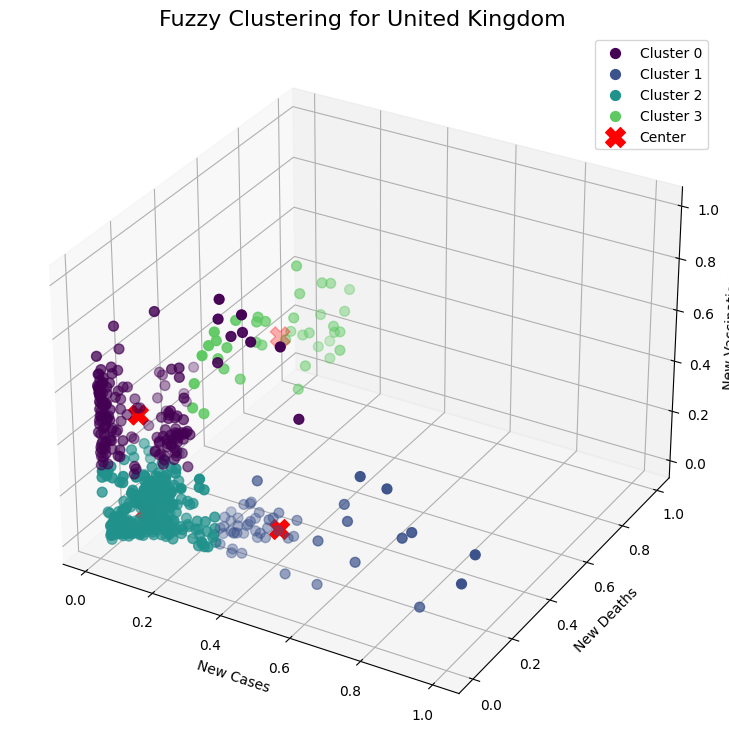

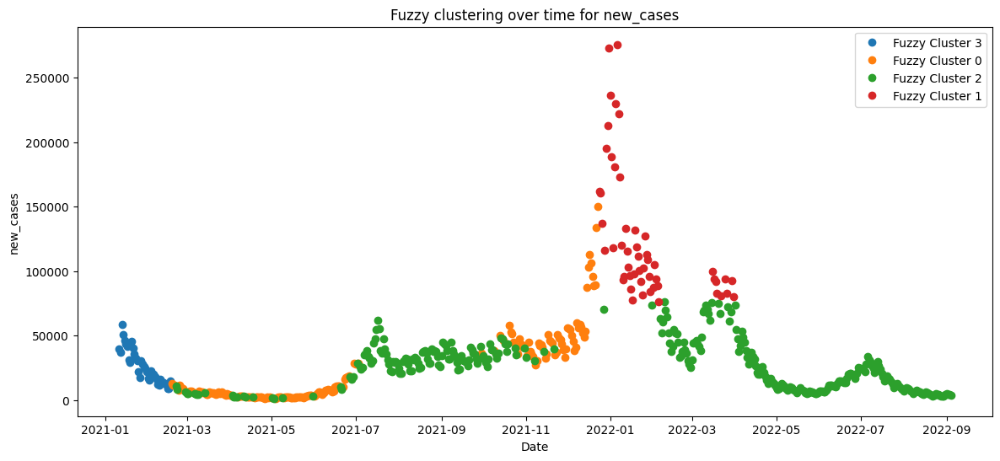

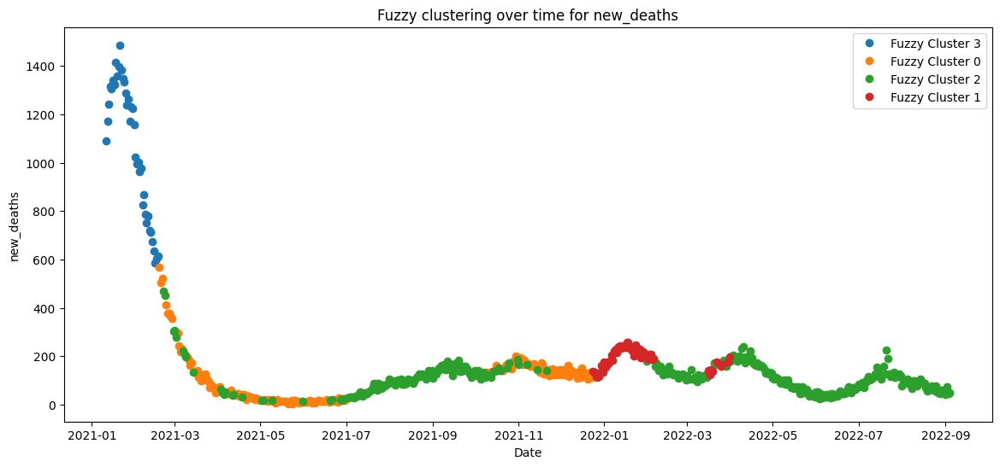

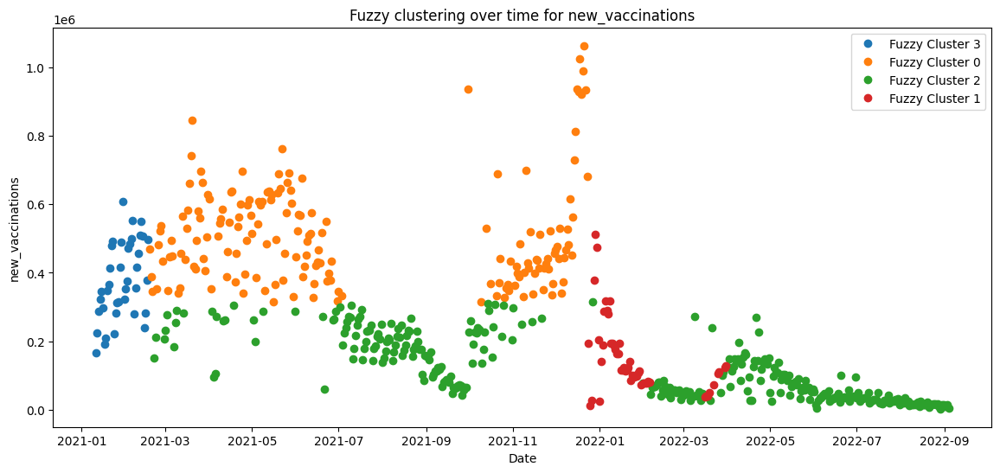


K-mean Clustering for South Korea
Number of Clusters: 3
Silhouette Score: 0.642
Davies-Bouldin Score: 0.524
Calinski-Harabasz Score: 984.015

Size of this K-mean
For K-mean, Cluster 0 size: 497
For K-mean, Cluster 1 size: 108
For K-mean, Cluster 2 size: 47

K-mean Cluster sizes
                           new_cases  new_deaths  new_vaccinations
K-mean_cluster_labels                                             
0                       28954.778672   28.211268      91607.853119
1                        2864.277778   22.944444     757336.694444
2                      274343.085106  277.276596      48064.255319
Cluster 2 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 1 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-02-27 2022-12-12
1                     2021-05-27 2022-01-28
2                     2022-03-02 2022-04-21



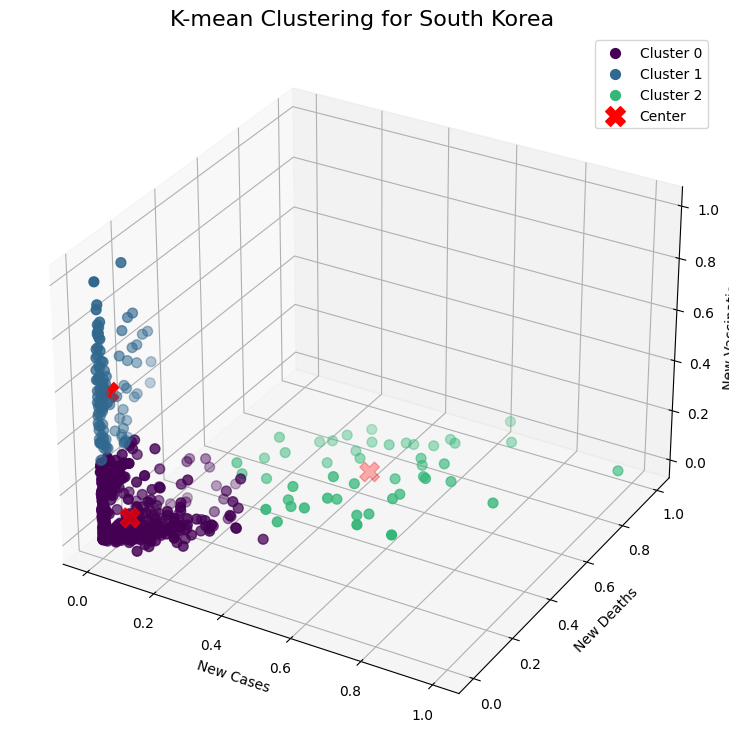

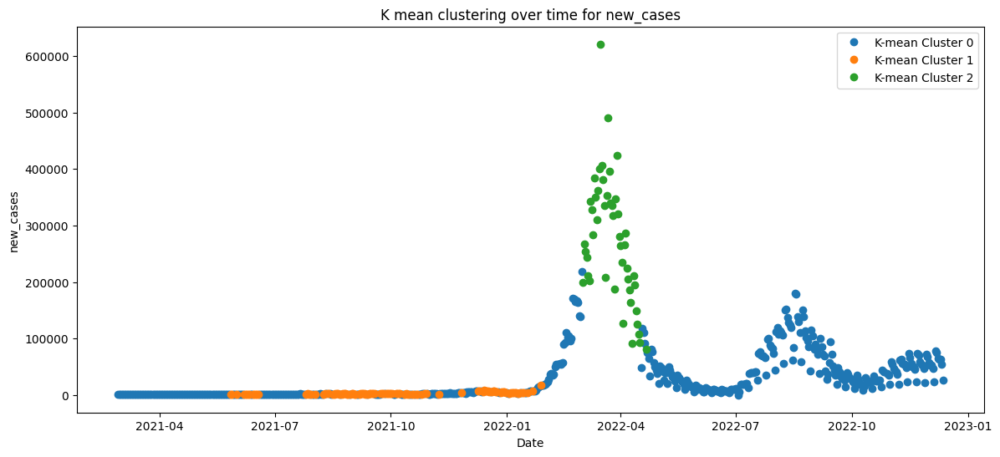

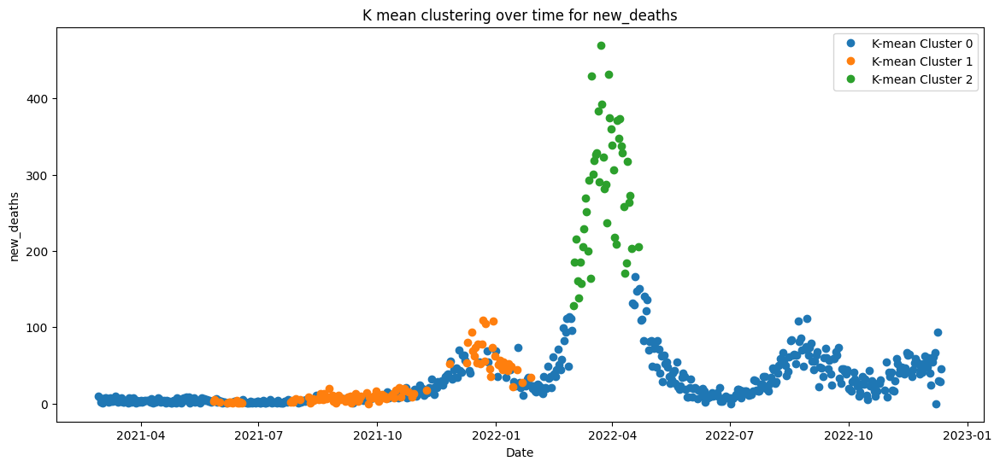

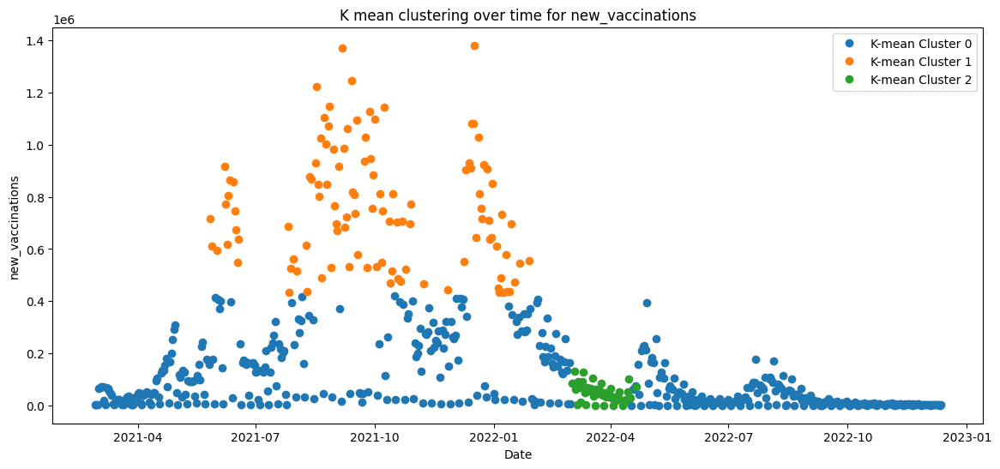


Fuzzy Clustering for South Korea
Number of Clusters: 3
Silhouette Score: 0.641
Davies-Bouldin Score: 0.526
Calinski-Harabasz Score: 984.015

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 109
For Fuzzy, Cluster 1 size: 47
For Fuzzy, Cluster 2 size: 496

Fuzzy Cluster sizes
                          new_cases  new_deaths  new_vaccinations
Fuzzy_cluster_labels                                             
0                       2851.000000   22.880734     754242.403670
1                     274343.085106  277.276596      48064.255319
2                      29010.298387   28.235887      90945.653226
Cluster 1 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-05-27 2022-01-28
1                    2022-03-02 2022-04-21
2                    2021-02-27 2022-12-12

Fuzzy people full

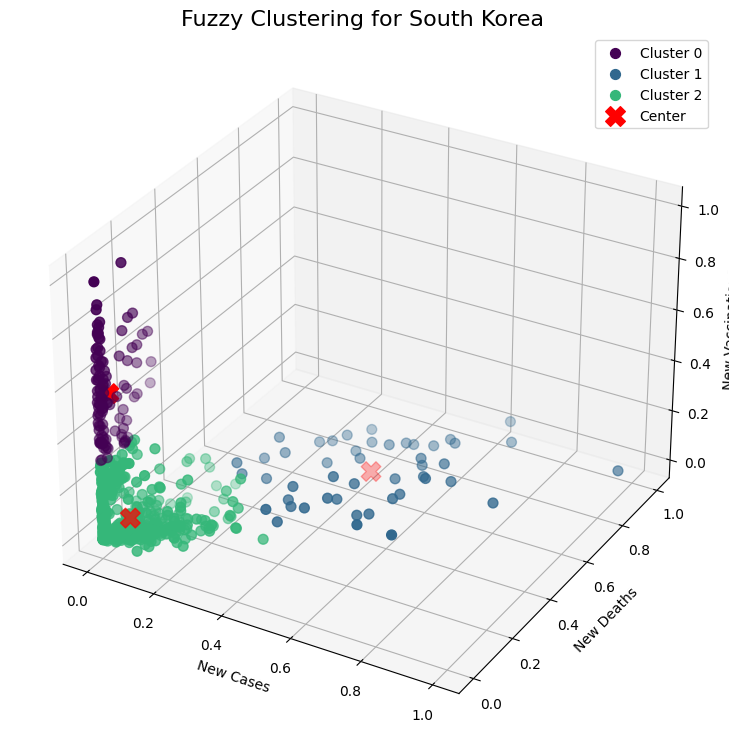

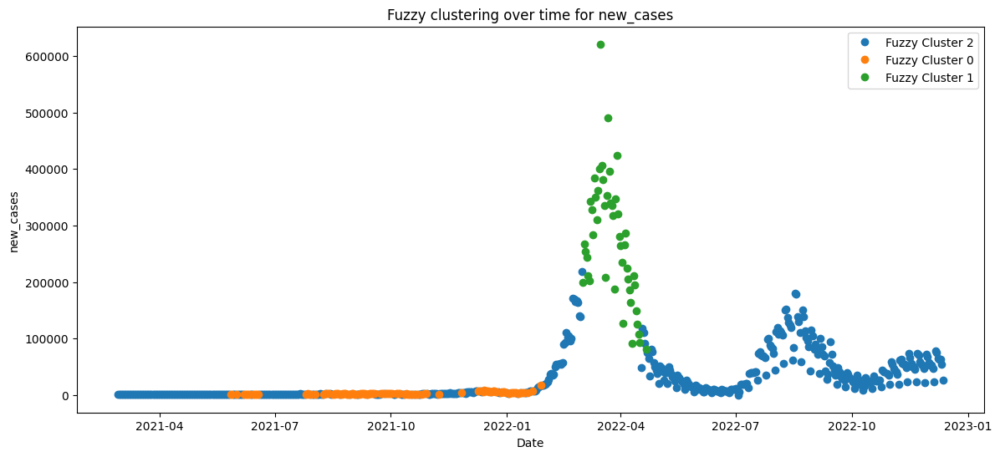

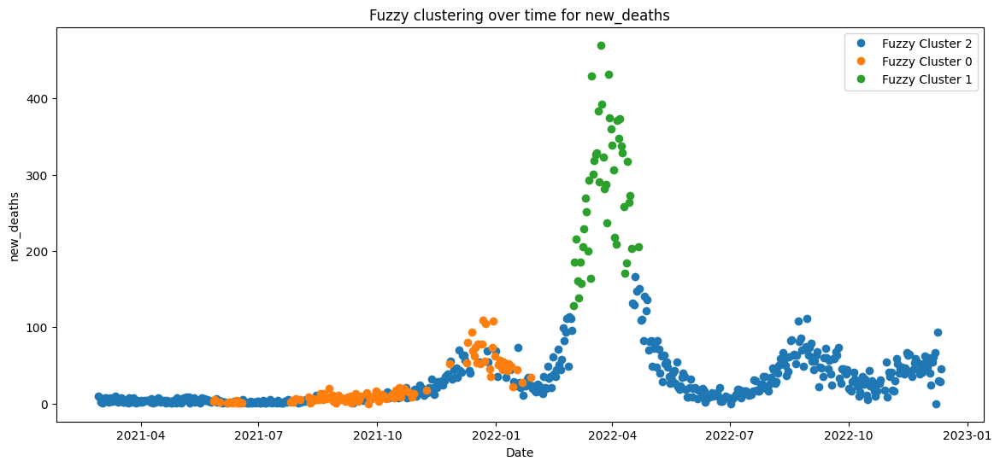

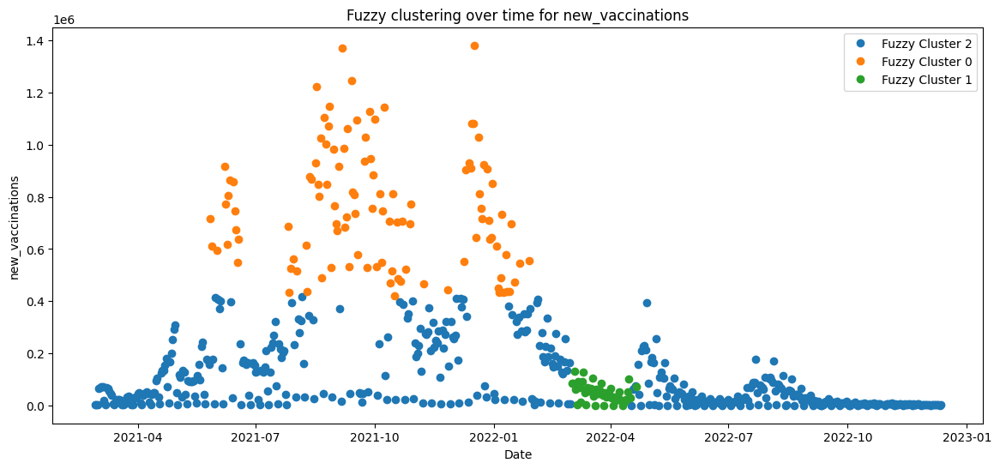


K-mean Clustering for Italy
Number of Clusters: 4
Silhouette Score: 0.582
Davies-Bouldin Score: 0.661
Calinski-Harabasz Score: 1024.489

Size of this K-mean
For K-mean, Cluster 0 size: 159
For K-mean, Cluster 1 size: 688
For K-mean, Cluster 2 size: 140
For K-mean, Cluster 3 size: 34

K-mean Cluster sizes
                           new_cases  new_deaths  new_vaccinations
K-mean_cluster_labels                                             
0                        8402.094340   81.874214     483148.333333
1                       20759.476744   63.194767      39719.561047
2                       23079.478571  386.050000     160305.085714
3                      157712.588235  307.264706     529726.794118
Cluster 3 has the highest average new cases.
Cluster 2 has the highest average new deaths.
Cluster 3 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-04-26 2022-0

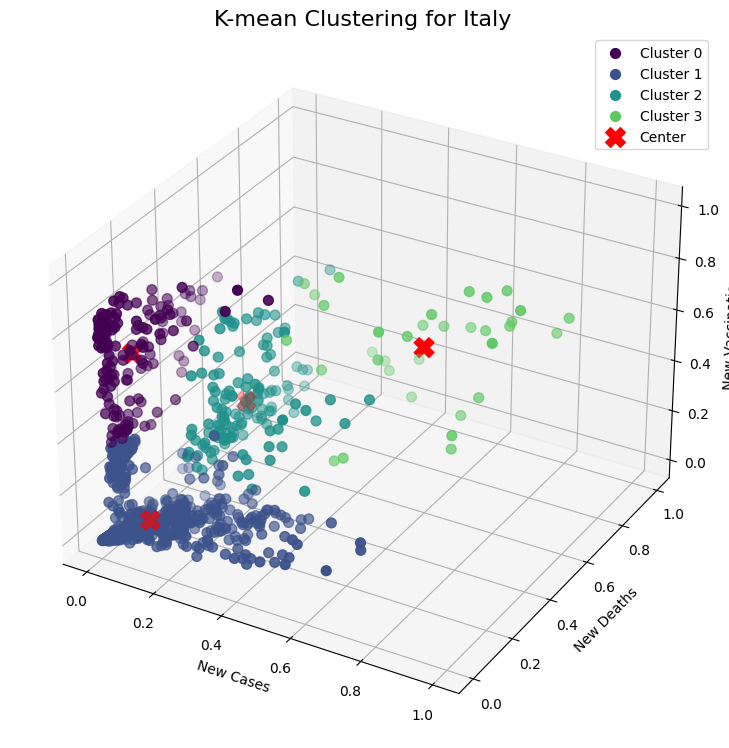

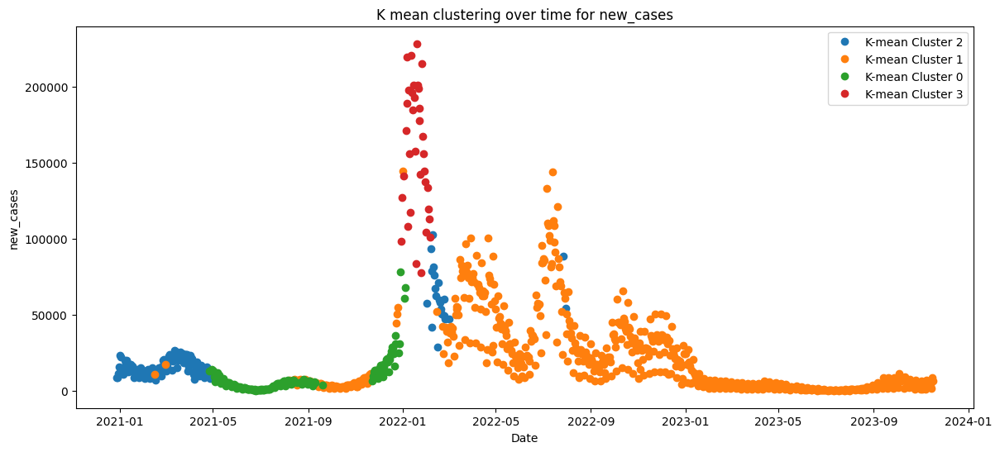

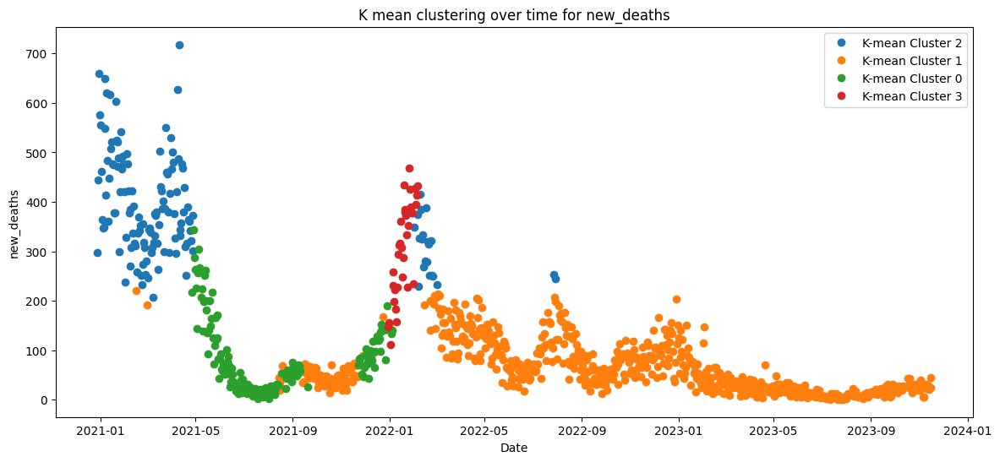

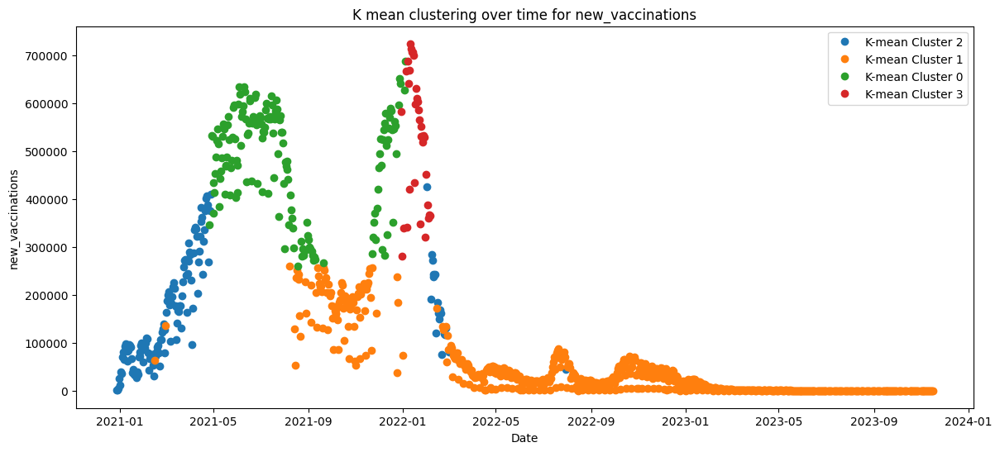


Fuzzy Clustering for Italy
Number of Clusters: 4
Silhouette Score: 0.449
Davies-Bouldin Score: 0.863
Calinski-Harabasz Score: 798.512

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 179
For Fuzzy, Cluster 1 size: 192
For Fuzzy, Cluster 2 size: 517
For Fuzzy, Cluster 3 size: 133

Fuzzy Cluster sizes
                         new_cases  new_deaths  new_vaccinations
Fuzzy_cluster_labels                                            
0                     31428.413408  115.491620     505955.720670
1                     56236.265625  133.333333      51377.781250
2                      8458.512573   41.678917      41303.087041
3                     25682.015038  399.766917     171554.601504
Cluster 1 has the highest average new cases.
Cluster 3 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-04-26 2022-02-01
1                 

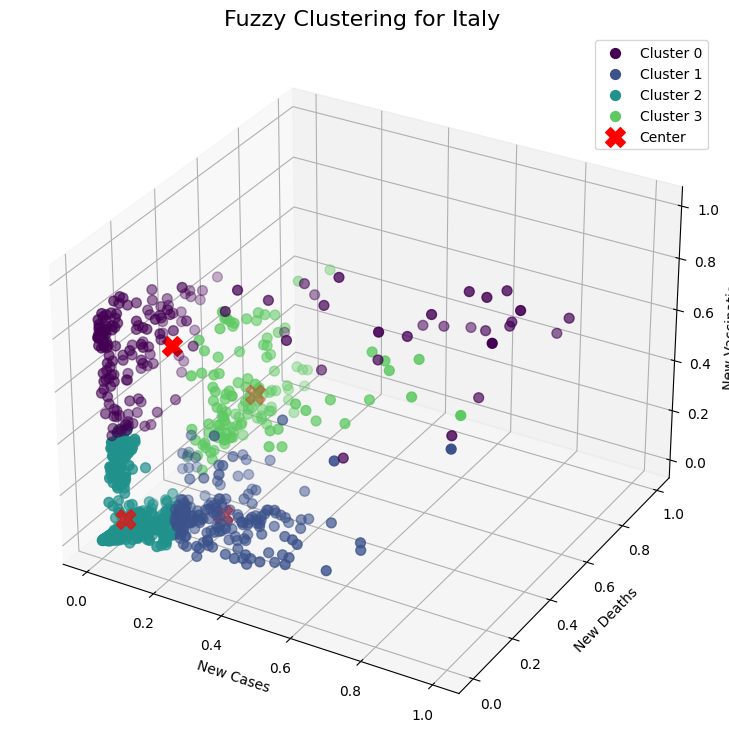

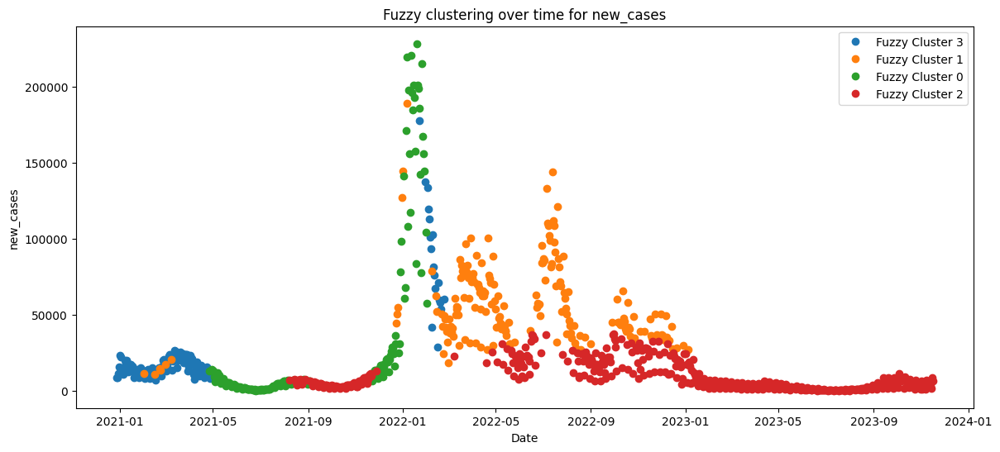

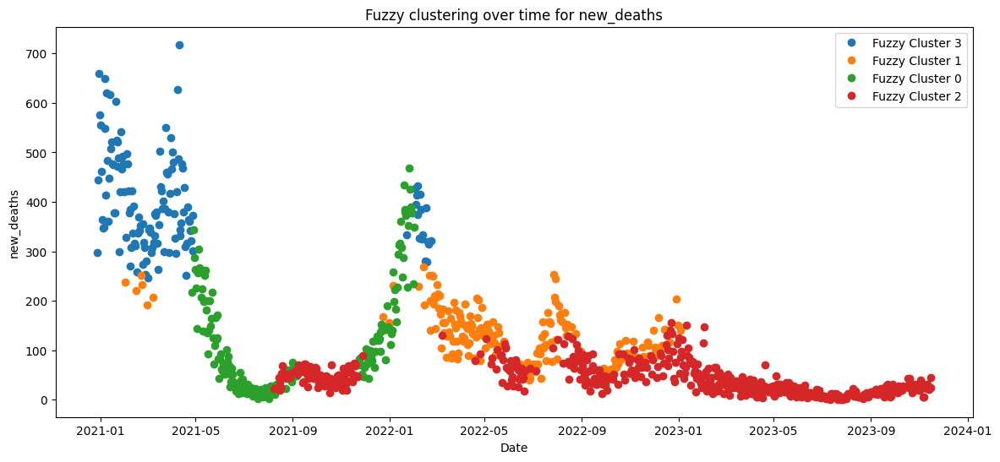

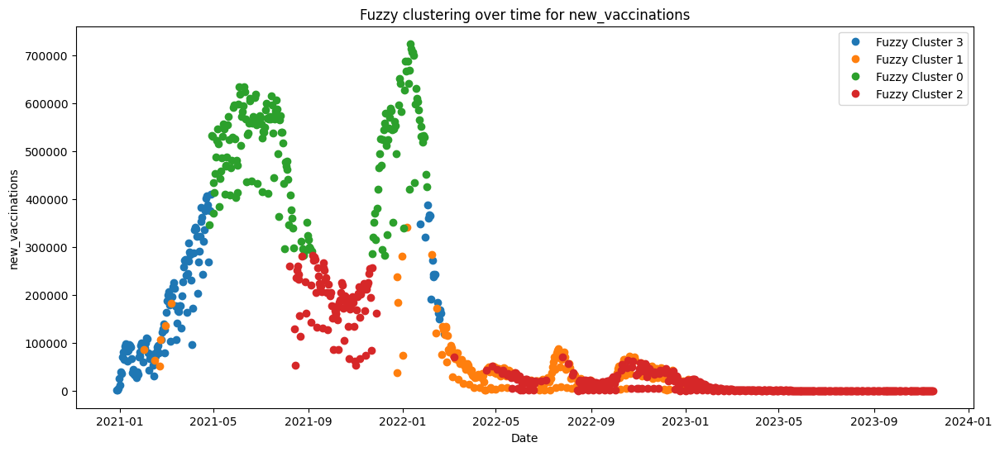


K-mean Clustering for Russia
Number of Clusters: 3
Silhouette Score: 0.521
Davies-Bouldin Score: 0.663
Calinski-Harabasz Score: 350.236

Size of this K-mean
For K-mean, Cluster 0 size: 162
For K-mean, Cluster 1 size: 190
For K-mean, Cluster 2 size: 20

K-mean Cluster sizes
                           new_cases  new_deaths  new_vaccinations
K-mean_cluster_labels                                             
0                       14880.691358  323.246914     226678.290123
1                       28473.694737  897.310526     571554.610526
2                      166892.250000  686.500000     369959.400000
Cluster 2 has the highest average new cases.
Cluster 1 has the highest average new deaths.
Cluster 1 has the highest average  new_vaccinations.

K-mean Date Range:
                             min        max
K-mean_cluster_labels                      
0                     2021-03-03 2022-12-04
1                     2021-06-24 2022-03-11
2                     2022-01-29 2022-02-17

K-mea

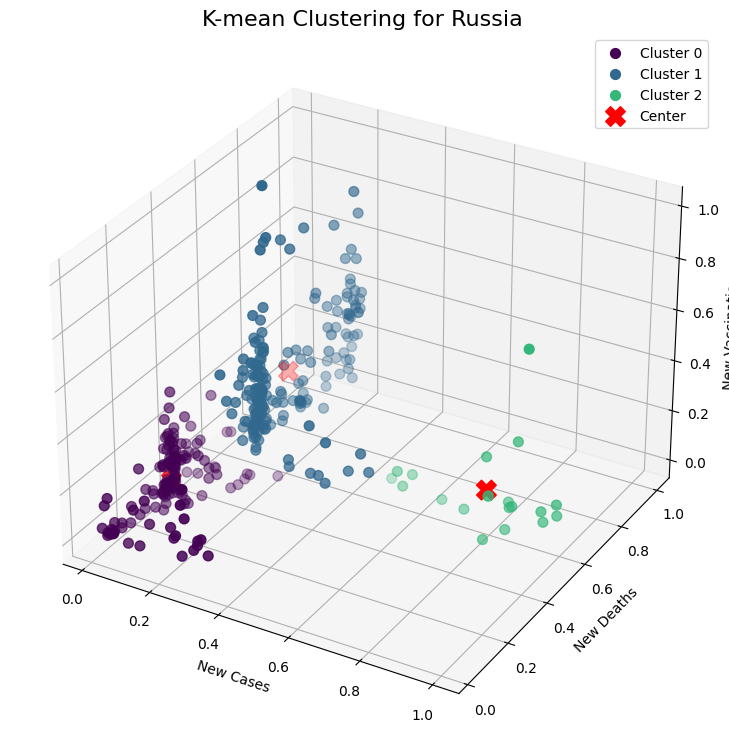

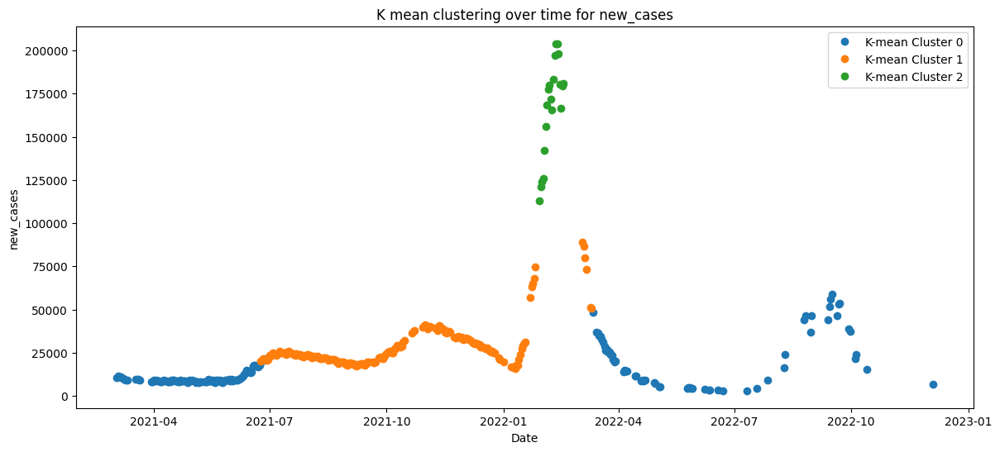

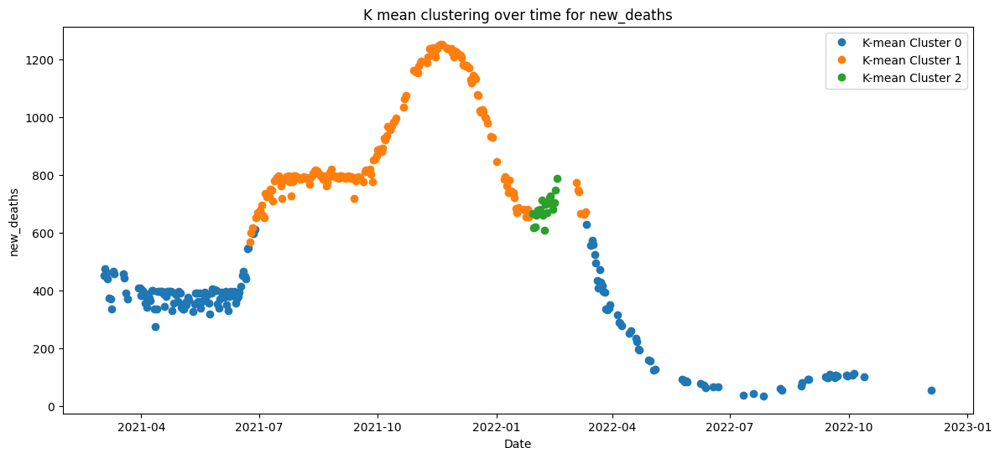

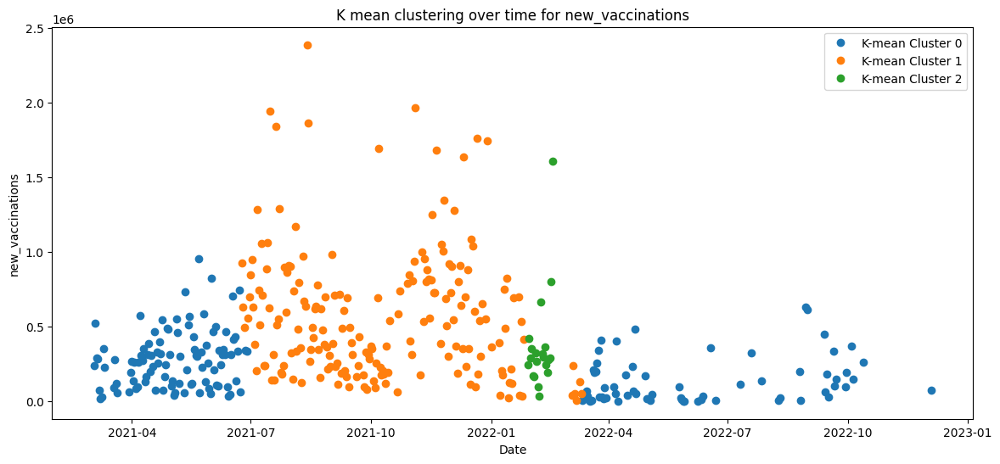


Fuzzy Clustering for Russia
Number of Clusters: 3
Silhouette Score: 0.521
Davies-Bouldin Score: 0.663
Calinski-Harabasz Score: 350.236

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 190
For Fuzzy, Cluster 1 size: 20
For Fuzzy, Cluster 2 size: 162

Fuzzy Cluster sizes
                          new_cases  new_deaths  new_vaccinations
Fuzzy_cluster_labels                                             
0                      28473.694737  897.310526     571554.610526
1                     166892.250000  686.500000     369959.400000
2                      14880.691358  323.246914     226678.290123
Cluster 1 has the highest average new cases.
Cluster 0 has the highest average new deaths.
Cluster 0 has the highest average  new_vaccinations.

Fuzzy Date Range:
                            min        max
Fuzzy_cluster_labels                      
0                    2021-06-24 2022-03-11
1                    2022-01-29 2022-02-17
2                    2021-03-03 2022-12-04

Fuzzy people fully vac

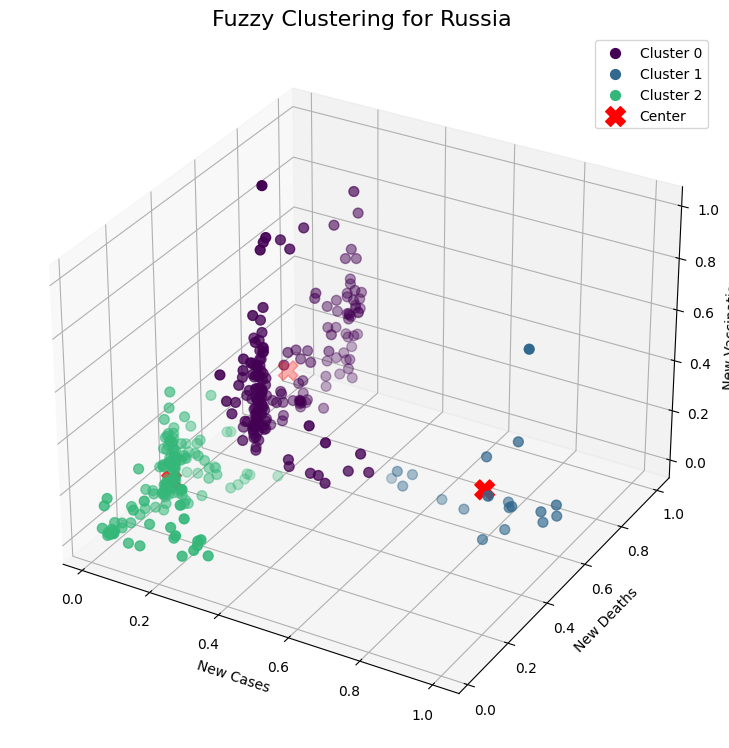

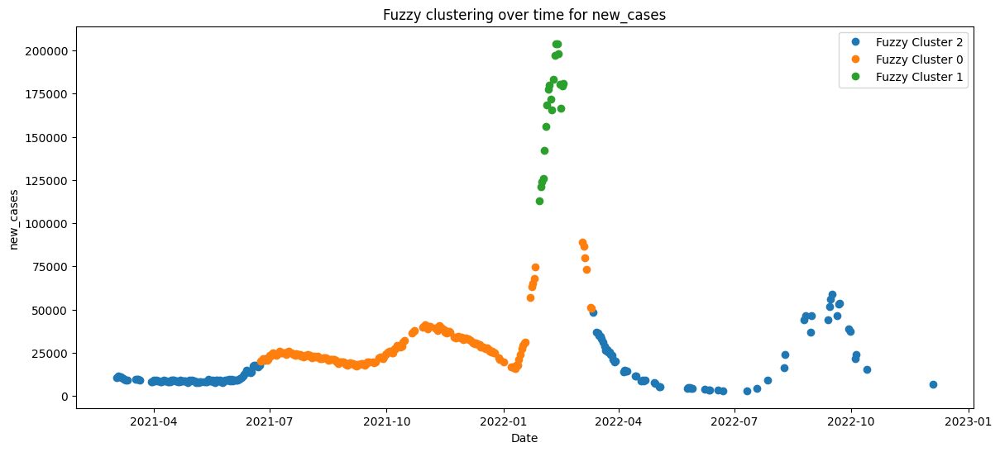

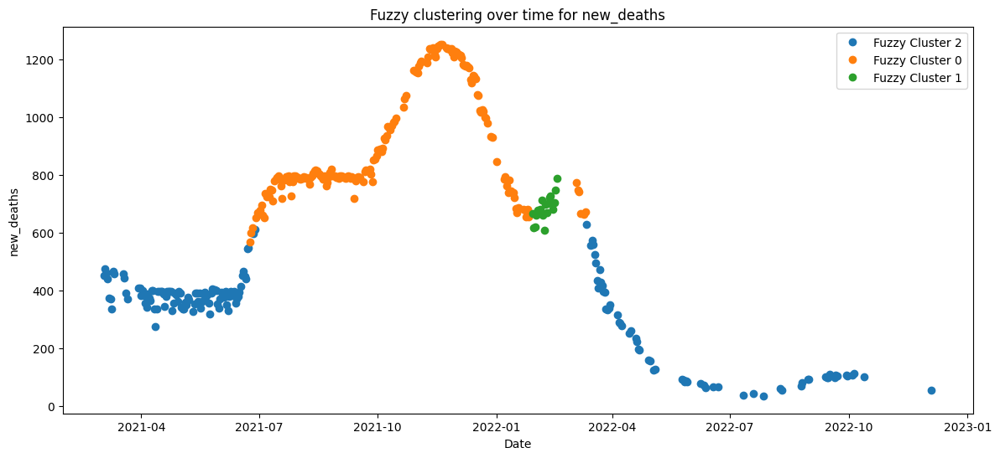

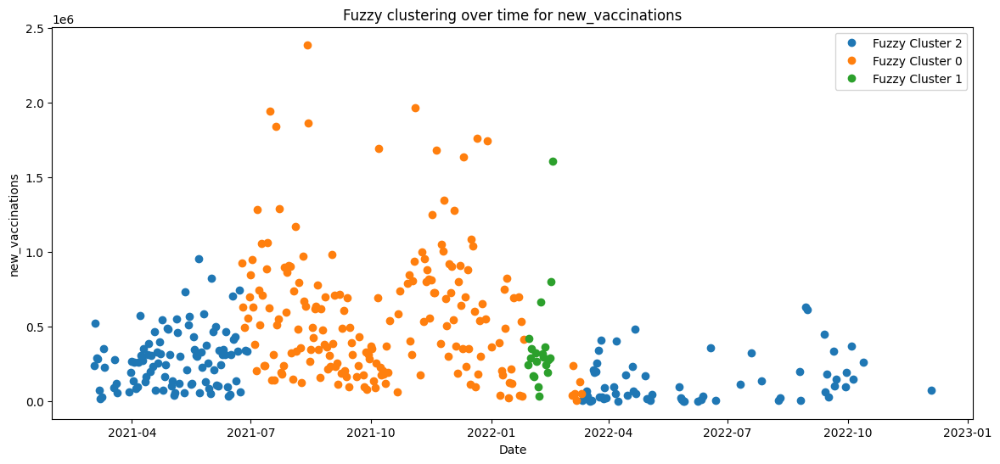

In [58]:
countries = ['United States', 'India', 'China', 'Brazil', 'France', 'Germany', 'United Kingdom', 'South Korea', 'Italy', 'Russia']
methods = ['K-mean', 'Fuzzy']

results = []

for country in countries:
    for method in methods:
        # Perform clustering and plot
        data_with_clusters = create_clusters_and_plot(data_columns_of_interest, country, method, filtered_forCountry_df)

        # Summarize the clusters
        cluster_summary = summarize_clusters(data_with_clusters)

        # Plot variables over time
        plot_variables_over_time(data_with_clusters)

        # Store results (assuming summarize_clusters returns a dict or similar structure)
        results.append({
            'Country': country,
            'Method': method,
            'Summary': cluster_summary
        })

# Convert results to a DataFrame for easier analysis and comparison
results_df = pd.DataFrame(results)


K-mean Clustering for United States
Number of Clusters: 3
Silhouette Score: 0.556
Davies-Bouldin Score: 0.768
Calinski-Harabasz Score: 886.394

Size of this K-mean
For K-mean, Cluster 0 size: 131
For K-mean, Cluster 1 size: 549
For K-mean, Cluster 2 size: 196

Fuzzy Clustering for United States
Number of Clusters: 3
Silhouette Score: 0.556
Davies-Bouldin Score: 0.770
Calinski-Harabasz Score: 886.324

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 132
For Fuzzy, Cluster 1 size: 196
For Fuzzy, Cluster 2 size: 548

K-mean Clustering for India
Number of Clusters: 2
Silhouette Score: 0.726
Davies-Bouldin Score: 0.744
Calinski-Harabasz Score: 939.717

Size of this K-mean
For K-mean, Cluster 0 size: 899
For K-mean, Cluster 1 size: 90

Fuzzy Clustering for India
Number of Clusters: 2
Silhouette Score: 0.726
Davies-Bouldin Score: 0.744
Calinski-Harabasz Score: 939.717

Size of this Fuzzy
For Fuzzy, Cluster 0 size: 899
For Fuzzy, Cluster 1 size: 90

K-mean Clustering for China
Number of Clusters

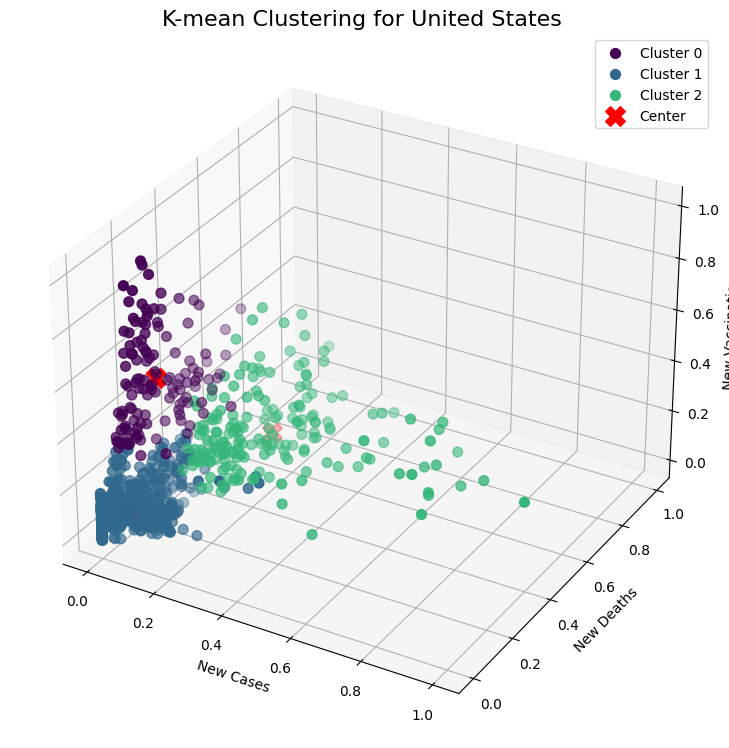

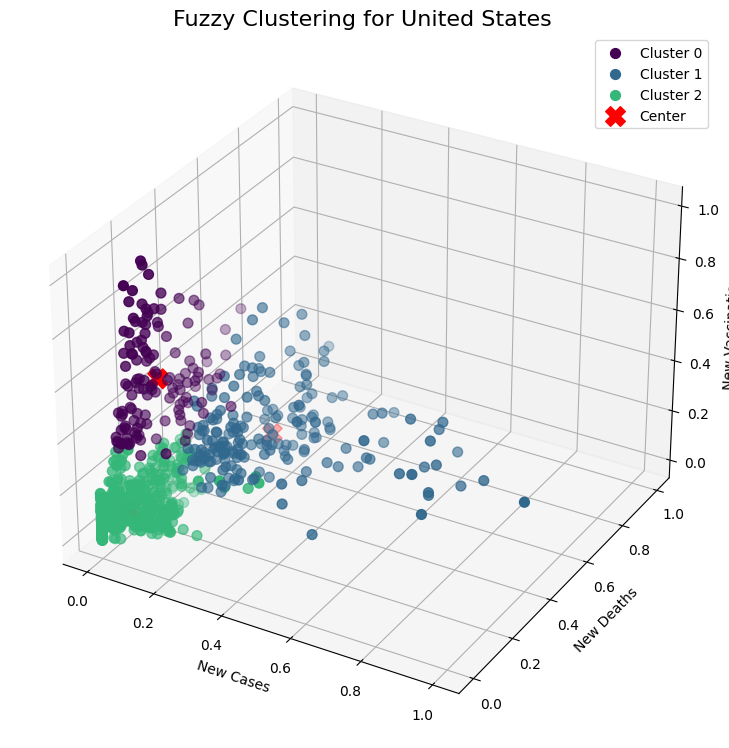

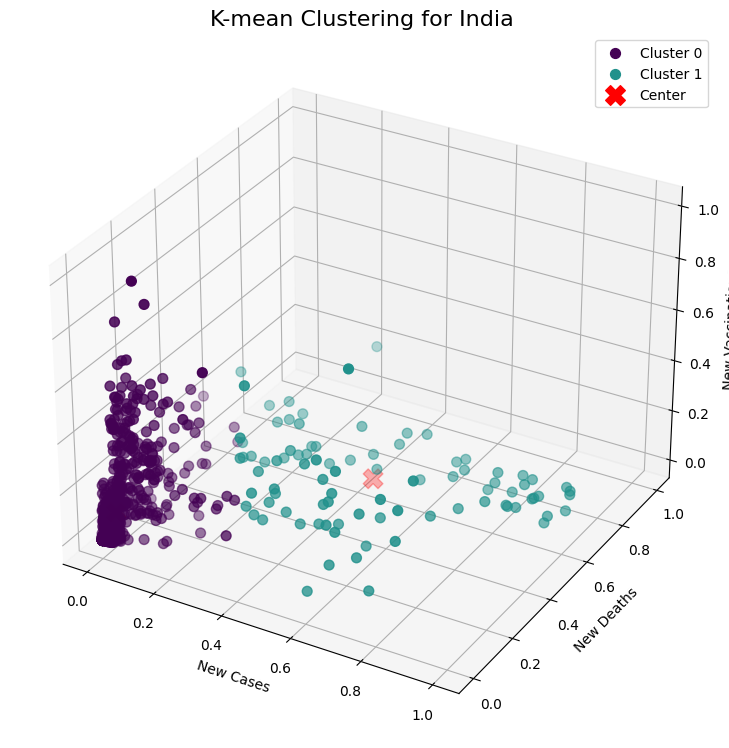

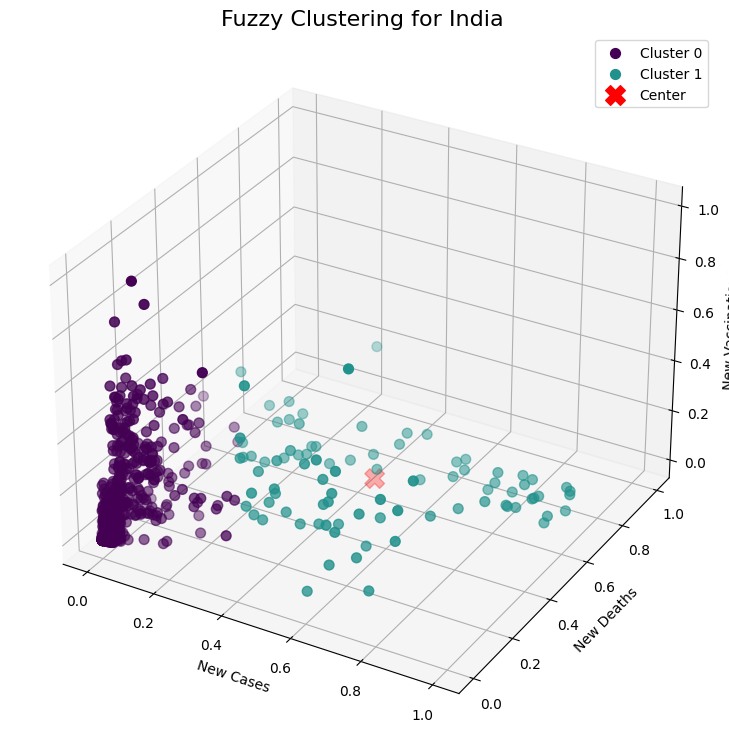

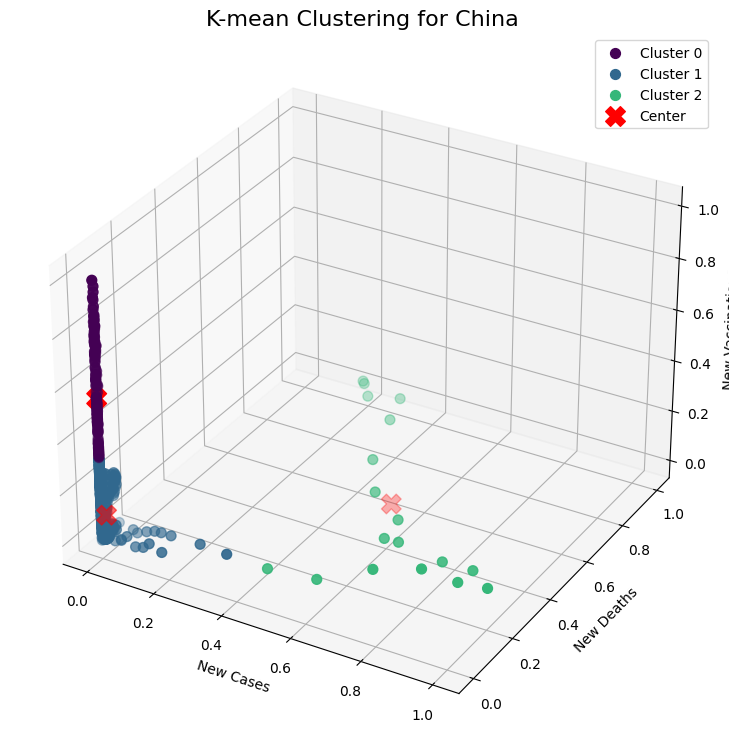

...

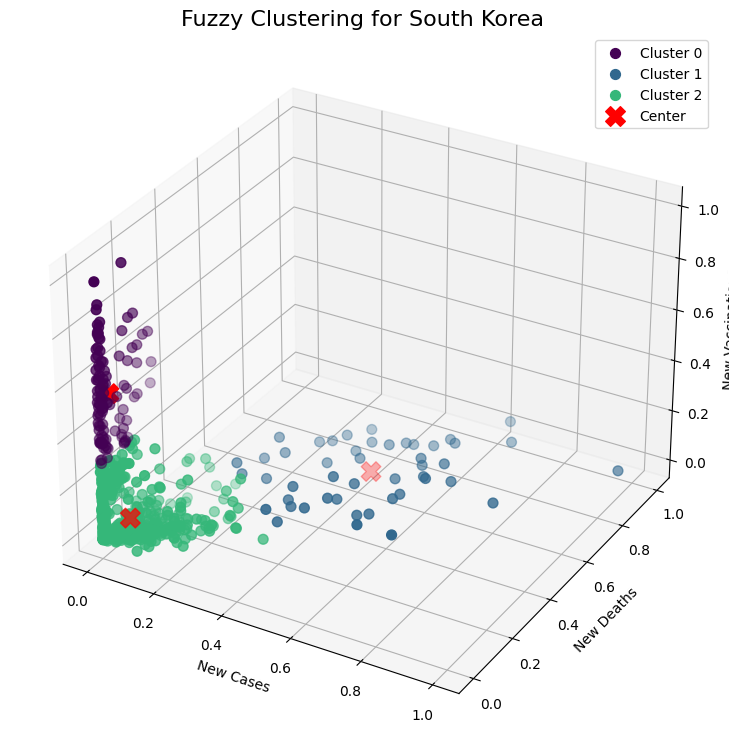

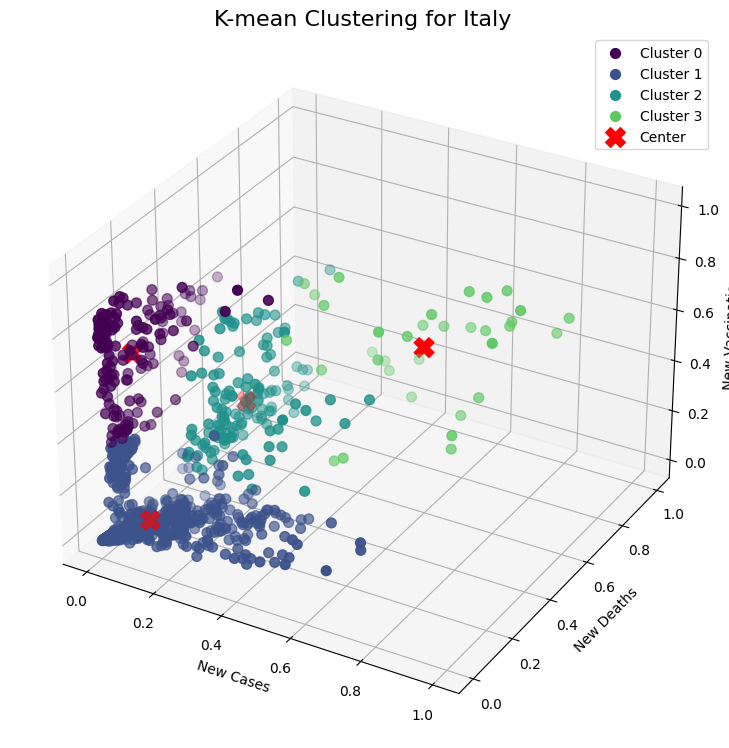

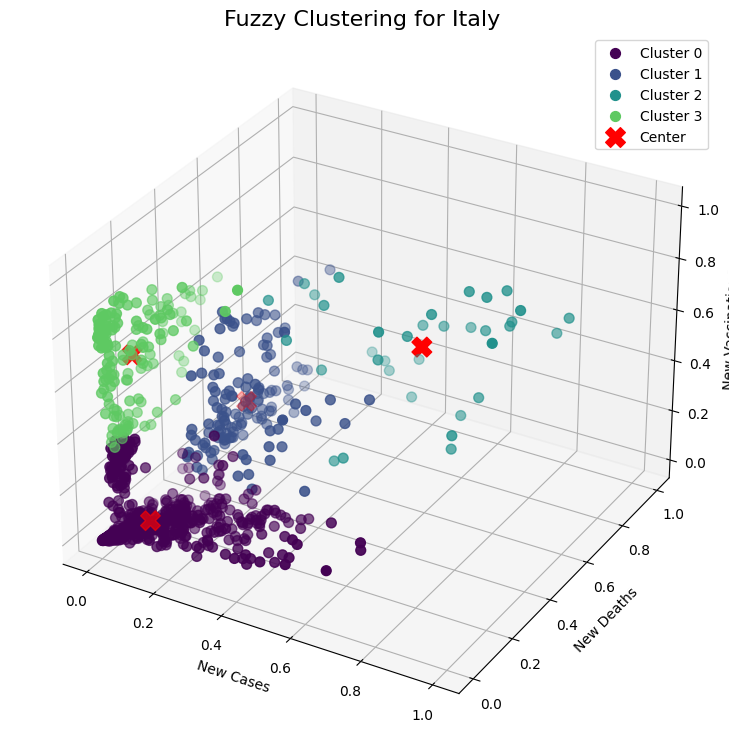

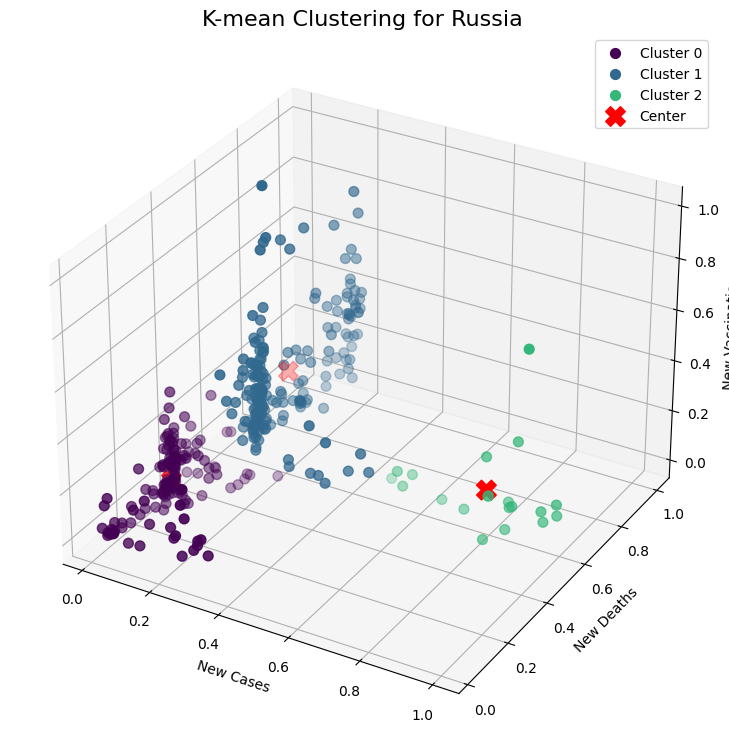

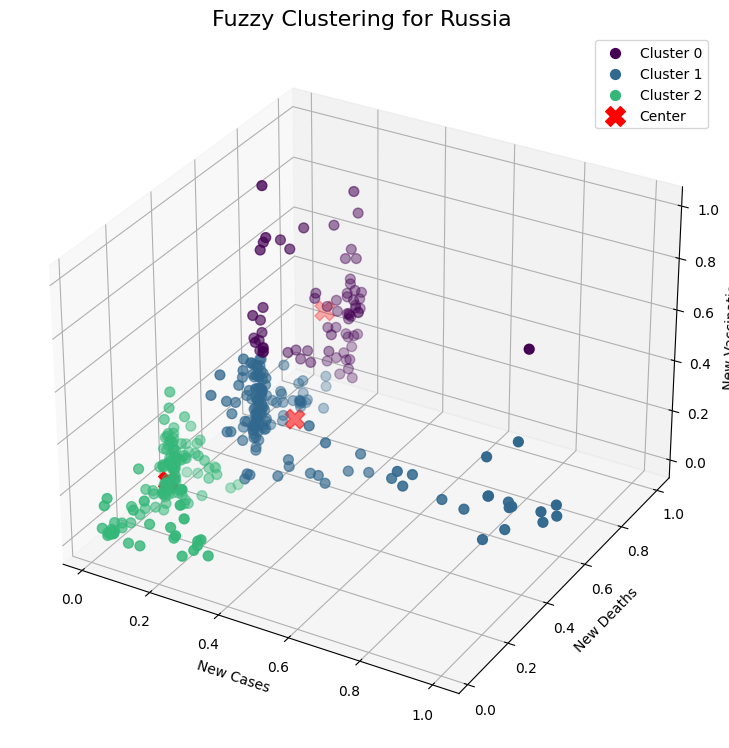

In [59]:
# Define the countries you want to compare
countries_to_compare = ['United States', 'India', 'China', 'Brazil', 'France', 'Germany', 'United Kingdom', 'South Korea', 'Italy', 'Russia']

# Initialize dataframes to store results
kmeans_results = pd.DataFrame(columns=['Country', 'K-means Cluster'])
fuzzy_results = pd.DataFrame(columns=['Country', 'Fuzzy Cluster'])

# Loop through the selected countries
for country in countries_to_compare:
    # Apply K-means clustering
    country_data = create_clusters_and_plot(data_columns_of_interest, country, 'K-mean', filtered_forCountry_df)
    kmeans_cluster = country_data['K-mean_cluster_labels'].iloc[0]

    # Apply Fuzzy C-Means clustering
    country_data = create_clusters_and_plot(data_columns_of_interest, country, 'Fuzzy', filtered_forCountry_df)
    fuzzy_cluster = country_data['Fuzzy_cluster_labels'].iloc[0]

    # Append results to dataframes
    kmeans_results = kmeans_results.append({'Country': country, 'K-means Cluster': kmeans_cluster}, ignore_index=True)
    fuzzy_results = fuzzy_results.append({'Country': country, 'Fuzzy Cluster': fuzzy_cluster}, ignore_index=True)

# Print and visualize the results
print("K-means Clustering Results:")
print(kmeans_results)

print("\nFuzzy C-Means Clustering Results:")
print(fuzzy_results)


**To compare different countries based on new cases and new deaths**

Preparing the Data

In [60]:
# Assuming `filtered_forCountry_df` is your DataFrame after removing invalid country names
# Calculate average new cases and new deaths for each country
country_agg = filtered_forCountry_df.groupby('location').agg({
    'new_cases': 'mean',
    'new_deaths': 'mean'
}).reset_index()

# Fill NA values if any
country_agg.fillna(0, inplace=True)

# Display the aggregated data
print(country_agg.head())


      location   new_cases  new_deaths
0  Afghanistan  160.993662    5.606338
1      Albania  235.274648    2.538028
2      Algeria  191.533099    4.845775
3      Andorra   33.813380    0.111972
4       Angola   74.648592    1.363380


Scaling the **Data**

In [61]:
from sklearn.preprocessing import StandardScaler

# Initialize the scaler
scaler = StandardScaler()

# Scale the data
scaled_features = scaler.fit_transform(country_agg[['new_cases', 'new_deaths']])

# Check scaled data
print(scaled_features[:5])

[[-0.27723477 -0.21477554]
 [-0.26874268 -0.25239163]
 [-0.27374338 -0.2240997 ]
 [-0.29177451 -0.28213397]
 [-0.28710607 -0.26679228]]


**Performing K-means Clustering**

In [62]:
from sklearn.cluster import KMeans

# Assuming you decide on a certain number of clusters; for example, 5
k = 5

# Initialize and fit KMeans
kmeans = KMeans(n_clusters=k, random_state=42)
country_agg['cluster'] = kmeans.fit_predict(scaled_features)

# Check the cluster labels
print(country_agg.head())

      location   new_cases  new_deaths  cluster
0  Afghanistan  160.993662    5.606338        0
1      Albania  235.274648    2.538028        0
2      Algeria  191.533099    4.845775        0
3      Andorra   33.813380    0.111972        0
4       Angola   74.648592    1.363380        0


**Analyze the clustering**

In [63]:
# Summary statistics for each cluster
for i in range(k):
    print(f"Cluster {i} Countries:")
    print(country_agg[country_agg['cluster'] == i]['location'].values)
    cluster_stats = country_agg[country_agg['cluster'] == i][['new_cases', 'new_deaths']].mean()
    print(f"Average New Cases: {cluster_stats['new_cases']}")
    print(f"Average New Deaths: {cluster_stats['new_deaths']}")
    print("\n")

Cluster 0 Countries:
['Afghanistan' 'Albania' 'Algeria' 'Andorra' 'Angola' 'Anguilla'
 'Antigua and Barbuda' 'Armenia' 'Aruba' 'Australia' 'Austria'
 'Azerbaijan' 'Bahamas' 'Bahrain' 'Bangladesh' 'Barbados' 'Belarus'
 'Belgium' 'Belize' 'Benin' 'Bermuda' 'Bhutan' 'Bolivia'
 'Bosnia and Herzegovina' 'Botswana' 'Brunei' 'Bulgaria' 'Burkina Faso'
 'Burundi' 'Cambodia' 'Cameroon' 'Canada' 'Cape Verde' 'Cayman Islands'
 'Chad' 'Chile' 'Comoros' 'Costa Rica' "Cote d'Ivoire" 'Croatia' 'Cuba'
 'Curacao' 'Cyprus' 'Czechia' 'Denmark' 'Djibouti' 'Dominica'
 'Dominican Republic' 'Ecuador' 'Egypt' 'El Salvador' 'England'
 'Equatorial Guinea' 'Eritrea' 'Estonia' 'Eswatini' 'Ethiopia'
 'Faeroe Islands' 'Falkland Islands' 'Fiji' 'Finland' 'French Guiana'
 'Gabon' 'Gambia' 'Georgia' 'Ghana' 'Greece' 'Grenada' 'Guadeloupe'
 'Guatemala' 'Guernsey' 'Guinea' 'Guinea-Bissau' 'Guyana' 'Haiti'
 'Honduras' 'Hungary' 'Iceland' 'Iraq' 'Ireland' 'Israel' 'Jamaica'
 'Jersey' 'Jordan' 'Kazakhstan' 'Kenya' 'Kiribati

**Visualize the Clusters**

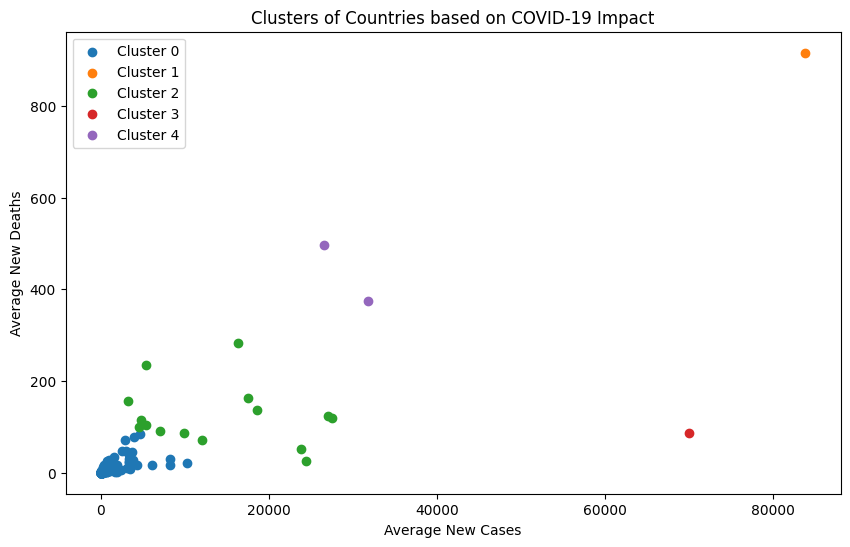

In [64]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))

# Scatter plot for clusters
for i in range(k):
    cluster_data = country_agg[country_agg['cluster'] == i]
    plt.scatter(cluster_data['new_cases'], cluster_data['new_deaths'], label=f'Cluster {i}')

plt.xlabel('Average New Cases')
plt.ylabel('Average New Deaths')
plt.legend()
plt.title('Clusters of Countries based on COVID-19 Impact')
plt.show()


**Applying Fuzzy C-Means Clustering**

In [65]:
import numpy as np
import skfuzzy as fuzz

# Assuming `scaled_features` is my scaled data from the previous step

# Number of clusters
clusters = 5

# Transpose scaled_features to match skfuzzy input requirements
data = scaled_features.T

# Apply Fuzzy C-Means
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    data, clusters, 2, error=0.005, maxiter=1000, init=None)

# Find the cluster each country belongs to
labels = np.argmax(u, axis=0)
country_agg['fuzzy_cluster'] = labels

# Display the first few rows to check cluster labels
print(country_agg.head())


      location   new_cases  new_deaths  cluster  fuzzy_cluster
0  Afghanistan  160.993662    5.606338        0              1
1      Albania  235.274648    2.538028        0              1
2      Algeria  191.533099    4.845775        0              1
3      Andorra   33.813380    0.111972        0              1
4       Angola   74.648592    1.363380        0              1


**Analyze the Clusters**

In [66]:
# Summary statistics for each fuzzy cluster
for i in range(clusters):
    cluster_countries = country_agg[country_agg['fuzzy_cluster'] == i]['location']
    print(f"Fuzzy Cluster {i} Countries:")
    print(cluster_countries.values)
    cluster_stats = country_agg[country_agg['fuzzy_cluster'] == i][['new_cases', 'new_deaths']].mean()
    print(f"Average New Cases: {cluster_stats['new_cases']}")
    print(f"Average New Deaths: {cluster_stats['new_deaths']}")
    print("\n")

Fuzzy Cluster 0 Countries:
['Brazil' 'India' 'Russia']
Average New Cases: 24893.61628357986
Average New Deaths: 384.5889671361503


Fuzzy Cluster 1 Countries:
['Afghanistan' 'Albania' 'Algeria' 'Andorra' 'Angola' 'Anguilla'
 'Antigua and Barbuda' 'Armenia' 'Aruba' 'Austria' 'Azerbaijan' 'Bahamas'
 'Bahrain' 'Bangladesh' 'Barbados' 'Belarus' 'Belgium' 'Belize' 'Benin'
 'Bermuda' 'Bhutan' 'Bolivia' 'Bosnia and Herzegovina' 'Botswana' 'Brunei'
 'Bulgaria' 'Burkina Faso' 'Burundi' 'Cambodia' 'Cameroon' 'Canada'
 'Cape Verde' 'Cayman Islands' 'Chad' 'Comoros' 'Costa Rica'
 "Cote d'Ivoire" 'Croatia' 'Cuba' 'Curacao' 'Cyprus' 'Czechia' 'Denmark'
 'Djibouti' 'Dominica' 'Dominican Republic' 'Ecuador' 'Egypt'
 'El Salvador' 'England' 'Equatorial Guinea' 'Eritrea' 'Estonia'
 'Eswatini' 'Ethiopia' 'Faeroe Islands' 'Falkland Islands' 'Fiji'
 'Finland' 'French Guiana' 'Gabon' 'Gambia' 'Georgia' 'Ghana' 'Greece'
 'Grenada' 'Guadeloupe' 'Guatemala' 'Guernsey' 'Guinea' 'Guinea-Bissau'
 'Guyana' 'Haiti'

**Visualizing Fuzzy Clusters**

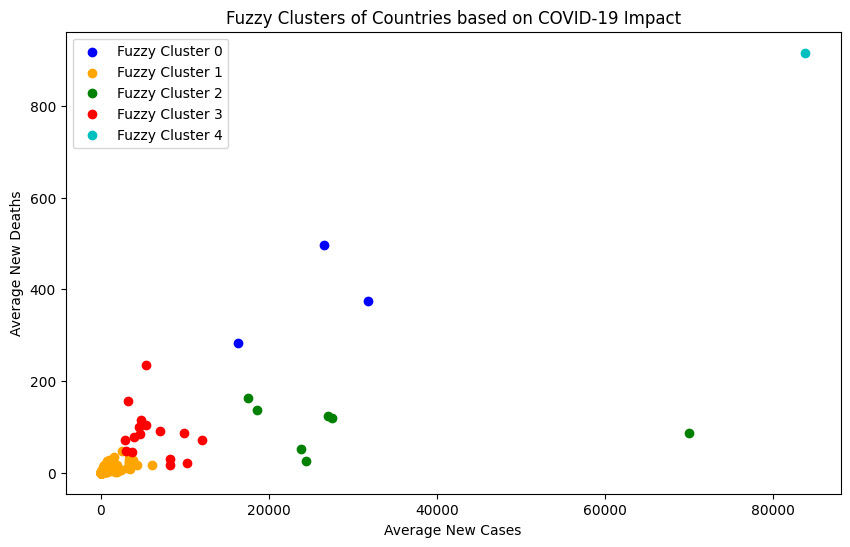

In [67]:
plt.figure(figsize=(10, 6))

colors = ['b', 'orange', 'g', 'r', 'c', 'm', 'y', 'k', 'Brown', 'ForestGreen']

# Plot each cluster
for i in range(clusters):
    cluster_data = country_agg[country_agg['fuzzy_cluster'] == i]
    plt.scatter(cluster_data['new_cases'], cluster_data['new_deaths'], color=colors[i], label=f'Fuzzy Cluster {i}')

plt.xlabel('Average New Cases')
plt.ylabel('Average New Deaths')
plt.legend()
plt.title('Fuzzy Clusters of Countries based on COVID-19 Impact')
plt.show()

In [68]:
from sklearn.metrics import silhouette_score

# Calculate silhouette scores for K-means
silhouette_kmeans = silhouette_score(scaled_features, country_agg['cluster'])

# For Fuzzy C-means, consider the cluster with the highest membership for each point
silhouette_fuzzy = silhouette_score(scaled_features, country_agg['fuzzy_cluster'])

print(f"Silhouette Score for K-means: {silhouette_kmeans}")
print(f"Silhouette Score for Fuzzy C-means: {silhouette_fuzzy}")

# FPC was already calculated during Fuzzy C-means clustering
print(f"Fuzzy Partition Coefficient: {fpc}")

# Compare cluster centroids
# K-means centroids
print("K-means Centroids:")
print(kmeans.cluster_centers_)

# Fuzzy C-means centroids
print("Fuzzy C-means Centers:")
print(cntr)


Silhouette Score for K-means: 0.8470535626166582
Silhouette Score for Fuzzy C-means: 0.8038276082029808
Fuzzy Partition Coefficient: 0.9225101048796406
K-means Centroids:
[[-0.2127585  -0.20299607]
 [ 9.28726036 10.94783777]
 [ 1.28482861  1.23716048]
 [ 7.70057896  0.77013121]
 [ 3.03933669  5.06042054]]
Fuzzy C-means Centers:
[[ 3.08893731  4.67291411]
 [-0.24371382 -0.23221573]
 [ 2.57249519  1.00515286]
 [ 0.38900473  0.75182206]
 [ 9.26981362 10.86507207]]


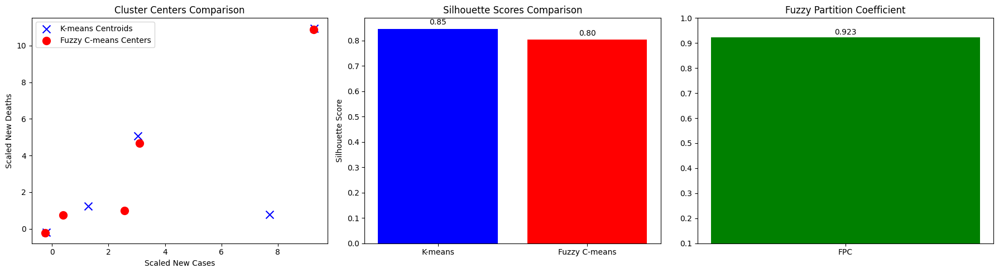

In [69]:
import matplotlib.pyplot as plt
import numpy as np

# Data for plotting
kmeans_centroids = np.array([[-0.2127585, -0.20299607],
                             [9.28726036, 10.94783777],
                             [1.28482861, 1.23716048],
                             [7.70057896, 0.77013121],
                             [3.03933669, 5.06042054]])

fuzzy_centers = np.array([[0.38903284, 0.75192001],
                          [-0.24370988, -0.23221255],
                          [9.26981414, 10.86507355],
                          [3.08894128, 4.67293527],
                          [2.57252981, 1.00511524]])

silhouette_scores = [0.8470535626166582, 0.8038276082029808]
methods = ['K-means', 'Fuzzy C-means']
fpc = [0.922514018769849]

# Plotting
fig, ax = plt.subplots(1, 3, figsize=(18, 5))

# Centroids and Centers Comparison
ax[0].scatter(kmeans_centroids[:, 0], kmeans_centroids[:, 1], color='blue', s=100, label='K-means Centroids', marker='x')
ax[0].scatter(fuzzy_centers[:, 0], fuzzy_centers[:, 1], color='red', s=100, label='Fuzzy C-means Centers', marker='o')
ax[0].set_title('Cluster Centers Comparison')
ax[0].set_xlabel('Scaled New Cases')
ax[0].set_ylabel('Scaled New Deaths')
ax[0].legend()

# Silhouette Scores
ax[1].bar(methods, silhouette_scores, color=['blue', 'red'])
ax[1].set_title('Silhouette Scores Comparison')
ax[1].set_ylabel('Silhouette Score')
for i, v in enumerate(silhouette_scores):
    ax[1].text(i, v + 0.01, f"{v:.2f}", ha='center', va='bottom')

# Fuzzy Partition Coefficient
ax[2].bar('FPC', fpc, color='green')
ax[2].set_title('Fuzzy Partition Coefficient')
ax[2].set_ylim(0.1, 1.0)
ax[2].text(0, fpc[0] + 0.005, f"{fpc[0]:.3f}", ha='center', va='bottom')

plt.tight_layout()
plt.show()


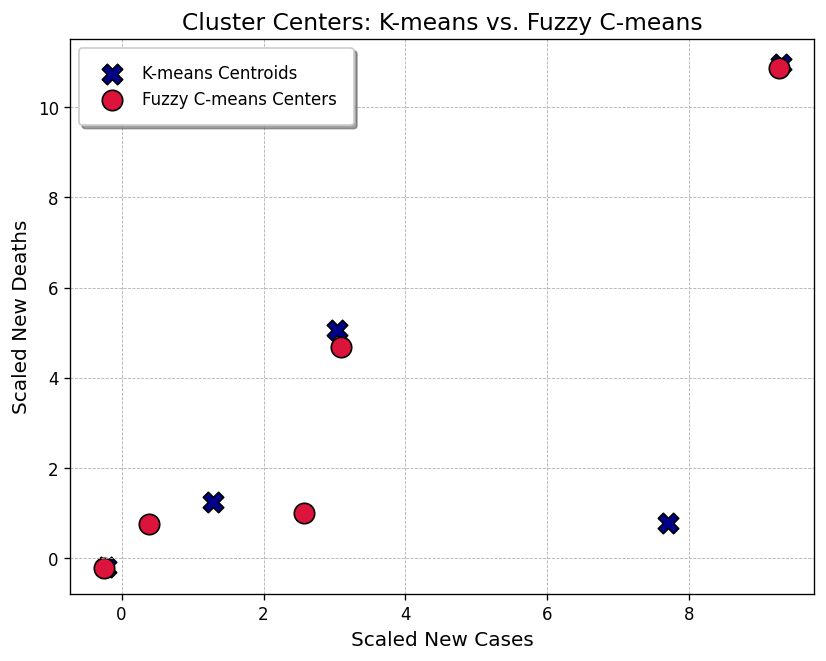

In [70]:
import matplotlib.pyplot as plt
import numpy as np

# Define the centroids for K-means and centers for Fuzzy C-means
kmeans_centroids = np.array([
    [-0.2127585, -0.20299607],
    [9.28726036, 10.94783777],
    [1.28482861, 1.23716048],
    [7.70057896, 0.77013121],
    [3.03933669, 5.06042054]
])

fuzzy_centers = np.array([
    [0.38903284, 0.75192001],
    [-0.24370988, -0.23221255],
    [9.26981414, 10.86507355],
    [3.08894128, 4.67293527],
    [2.57252981, 1.00511524]
])

plt.figure(figsize=(8, 6), dpi=120)
plt.scatter(kmeans_centroids[:, 0], kmeans_centroids[:, 1], color='darkblue', s=150, label='K-means Centroids', marker='X', edgecolor='black')
plt.scatter(fuzzy_centers[:, 0], fuzzy_centers[:, 1], color='crimson', s=150, label='Fuzzy C-means Centers', marker='o', edgecolor='black')
plt.title('Cluster Centers: K-means vs. Fuzzy C-means', fontsize=14)
plt.xlabel('Scaled New Cases', fontsize=12)
plt.ylabel('Scaled New Deaths', fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend(frameon=True, shadow=True, borderpad=1)
plt.show()


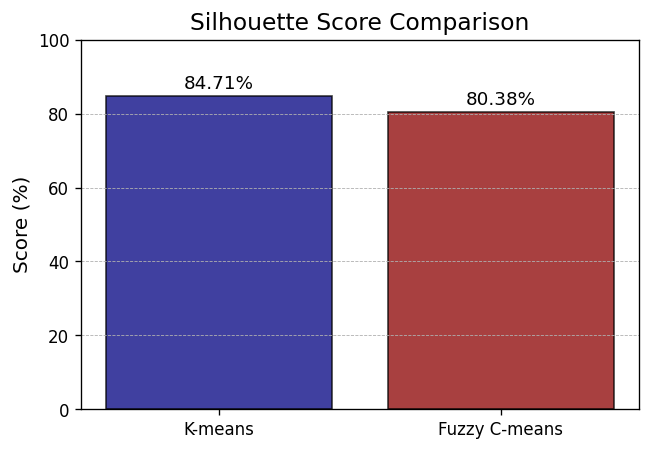

In [71]:
silhouette_scores_percentage = [84.70535626166582, 80.38276082029808]  # Converted to percentages
methods = ['K-means', 'Fuzzy C-means']

plt.figure(figsize=(6, 4), dpi=120)
colors = ['navy', 'darkred']
plt.bar(methods, silhouette_scores_percentage, color=colors, alpha=0.75, edgecolor='black')
plt.title('Silhouette Score Comparison', fontsize=14)
plt.ylabel('Score (%)', fontsize=12)
plt.ylim(0, 100)  # Reflects the percentage scale
plt.grid(axis='y', linestyle='--', linewidth=0.5)
for i, v in enumerate(silhouette_scores_percentage):
    plt.text(i, v + 1, f"{v:.2f}%", ha='center', va='bottom', fontsize=11)
plt.show()


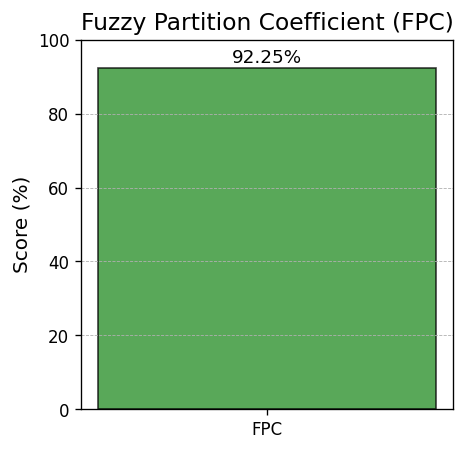

In [72]:
fpc_percentage = 92.2514018769849  # Converted to percentage

plt.figure(figsize=(4, 4), dpi=120)
plt.bar('FPC', [fpc_percentage], color='forestgreen', alpha=0.75, edgecolor='black')
plt.title('Fuzzy Partition Coefficient (FPC)', fontsize=14)
plt.ylabel('Score (%)', fontsize=12)
plt.ylim(0, 100)  # Reflects the percentage scale
plt.grid(axis='y', linestyle='--', linewidth=0.5)
plt.text(0, fpc_percentage + 0.5, f"{fpc_percentage:.2f}%", ha='center', va='bottom', fontsize=11)
plt.show()
